polar to cartesian
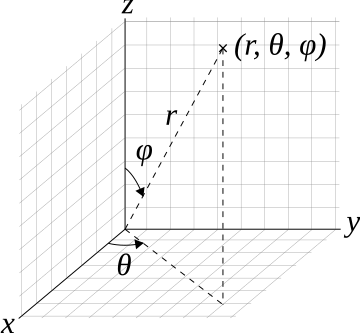

### installs

In [200]:
#check if this colab environment
on_colab = 'google.colab' in str(get_ipython())


In [201]:
import os

In [202]:
if on_colab:
  from google.colab import drive
  drive.mount('/content/drive')

In [203]:
# !wget https://github.com/NVIDIAGameWorks/kaolin/raw/4d8f49dd3e617cb1fec3e2c2bc3b2903ff952321/examples/samples/rendered_clock.zip
# !unzip rendered_clock.zip
if on_colab:
  !git clone https://github.com/NVIDIAGameWorks/kaolin.git
  !pip install kaolin==0.16.0 -f https://nvidia-kaolin.s3.us-east-2.amazonaws.com/torch-2.4.0_cu121.html --quiet
  !pip install torch torchvision transformers diffusers pillow  --quiet
  !pip install objaverse --quiet
  !pip install lpips
  !pip install -U "comet_ml>=3.44.0" --quiet
  !cp /content/kaolin/kaolin/render/lighting/sg.py /usr/local/lib/python3.10/dist-packages/kaolin/render/lighting/sg.py
# !wget https://raw.githubusercontent.com/NVIDIAGameWorks/kaolin/bcbc92f4ed6f176e9d320932ea5ee1262e2ce059/examples/samples/sphere.obj

In [204]:
if on_colab:
  checkpoint_root = '/content/drive/MyDrive/Adver_diff_checkpoints/'
else:
  checkpoint_root = '/home/dcor/niskhizov/adv_diff_checkpoints/'

In [195]:
#@title comet stuff
import comet_ml
from comet_ml.integration.pytorch import watch

comet_ml.login(project_name="Adversarial-diff-rendering-notebook-V3")

In [7]:
from IPython.display import clear_output
clear_output()

### imports

In [1]:
import kaolin
import kaolin as kal
import pickle
import torch
import objaverse


import math
import matplotlib.pyplot as plt

from kaolin.render.lighting import SgLightingParameters
import numpy as np

from datetime import datetime

Warp 1.4.2 initialized:
   CUDA Toolkit 12.6, Driver 12.0
   Devices:
     "cpu"      : "x86_64"
     "cuda:0"   : "NVIDIA RTX A6000" (48 GiB, sm_86, mempool enabled)
   Kernel cache:
     /home/dcor/niskhizov/.cache/warp/1.4.2


###  dynamic light, camera rendering funcs

In [171]:


IMAGE_SIZE = 1024

def make_camera(eye):
  return kal.render.camera.Camera.from_args(eye=torch.tensor(eye),
                                         at=torch.tensor([0., 0., 0.]),
                                         up=torch.tensor([0., 1., 0]),
                                         fov=math.pi * 45 / 180,
                                            near=0.1, far=10000.,
                                         width=IMAGE_SIZE,
                                            height=IMAGE_SIZE,
                                            device='cuda')
forbidden_theta = []
forbidden_phi = []

# r_range = [1.5, 2.5], phi_range=[0, 10], theta_range=[ 3.141 / 2 - 0.5 ,3.142 /2 + 0.5]
resolution = 20
for theta in np.linspace( 3.141 / 2 - 0.5, 3.142 /2 + 0.5, 3):
    forbidden_theta.append(theta)

for phi in np.linspace(0, 10, resolution):
    forbidden_phi.append(phi)

forbidden_theta = set(forbidden_theta)
forbidden_phi = set(forbidden_phi)

def random_polar(r_range, phi_range, theta_range):
  done = False
  while not done:
    r = np.random.uniform(r_range[0], r_range[1])
    theta = np.random.uniform(theta_range[0], theta_range[1])
    phi = np.random.uniform(phi_range[0], phi_range[1])
    if theta not in forbidden_theta and phi not in forbidden_phi:
      done = True
  return [r, theta, phi]


def polar_to_cartesian(r, phi, theta):
  y = r * math.cos(theta)
  z = r * math.sin(theta) * math.cos(phi)
  x = r * math.sin(theta) * math.sin(phi)
  return [x,y,z]

def random_light(strength_range = [8,15],suns_range=[1, 5], phi_range=[0, math.pi * 2], theta_range=[0, math.pi / 2]):
  n_suns = int(np.random.uniform(suns_range[0],suns_range[1]))
  light_directions = []
  for i in range(n_suns):
    [r, theta, phi] = random_polar(r_range=[1, 5], phi_range=phi_range, theta_range=theta_range)
    direction = np.array(polar_to_cartesian(r, phi, theta))
    direction = direction / np.sqrt(np.sum(direction * direction))
    light_directions.append(direction)

  light_directions = torch.tensor(np.array(light_directions)).cuda()

  strength = np.random.uniform(strength_range[0],strength_range[1])
  lighting = SgLightingParameters.from_sun(light_directions.float(), strength).cuda()

  return lighting, (strength,light_directions)

def polar_camera_and_light(r, phi, theta):
  eye = polar_to_cartesian(r, phi, theta)
  camera = make_camera(eye)
  eye = np.array(eye)
  eye_norm = np.sqrt(np.sum(eye * eye))

  n_suns = int(np.random.uniform(1, 5))
  light_directions = []
  light_direction = torch.tensor(eye / eye_norm, dtype=torch.float32).view(1, 1, 3).cuda()
  strength = np.random.uniform(4, 10)
  lighting = SgLightingParameters.from_sun(light_direction.float(), strength).cuda()
  return camera, lighting

theta_eps = 0.3

def random_camera_and_light(r_range = [0, 5], phi_range=[0, math.pi * 2], theta_range=[ math.pi / 2 - theta_eps,0]):
  [r, theta, phi] = random_polar(r_range, phi_range, theta_range)
  return polar_camera_and_light(r, phi, theta), (r, phi, theta)


def render(in_cam, mesh, lighting, pbr_mat=None):
    if pbr_mat is not None:
      render_res = kal.render.easy_render.render_mesh(in_cam, mesh, lighting=lighting, custom_materials = [pbr_mat])
    else:
      render_res = kal.render.easy_render.render_mesh(in_cam, mesh, lighting=lighting)
    img = render_res[kal.render.easy_render.RenderPass.render].squeeze(0).clamp(0, 1)
    return img

# Show simple render

SyntaxError: invalid syntax (3794822339.py, line 17)

### lpf noise

In [3]:
from torch import nn
import torch.nn.functional as F

def generate_low_frequency_noise_fft(noise, cutoff_ratio: float = 0.05):
    """Generates low-frequency noise using FFT-based filtering."""
    # Generate random white noise
    size = noise.shape[0]
    # Perform FFT to get frequency domain representation
    noise_fft = torch.fft.fft2(noise)

    # Shift the zero frequency component to the center
    noise_fft_shifted = torch.fft.fftshift(noise_fft)

    # Create a low-pass filter (circle mask in frequency domain)
    mask = torch.zeros_like(noise_fft_shifted)
    center = size // 2
    cutoff = int(center * cutoff_ratio)  # Controls how much low frequency is kept

    for i in range(size):
        for j in range(size):
            if (i - center) ** 2 + (j - center) ** 2 < cutoff ** 2:
                mask[i, j] = 1

    # Apply the mask to the FFT coefficients
    low_freq_fft = noise_fft_shifted * mask

    # Inverse FFT to convert back to spatial domain
    low_freq_fft_shifted_back = torch.fft.ifftshift(low_freq_fft)
    low_freq_noise = torch.fft.ifft2(low_freq_fft_shifted_back).real

    return low_freq_noise

class SmoothNoise(nn.Module):
  def __init__(self, noise_shape):
      super().__init__()
      # generate noise parameter for each of the 3 channels

      self.noise_parameter = nn.ParameterList([nn.Parameter(torch.randn(noise_shape,noise_shape)) for i in range(3)])

  def forward(self, texture_map):
      all_channels_noise =  torch.stack([generate_low_frequency_noise_fft(p) for p in self.noise_parameter])
      if texture_map.shape[-1] == 3:
        all_channels_noise = all_channels_noise.T
      output = texture_map + all_channels_noise
      return output


def gaussian_kernel(size: int, sigma: float):
    """Generates a 2D Gaussian kernel."""
    coords = torch.arange(size).float()
    coords -= (size - 1) / 2.0
    g = torch.exp(-coords.pow(2) / (2 * sigma ** 2))
    g = g / g.sum()  # Normalize
    g_2d = g.unsqueeze(0) * g.unsqueeze(1)  # Outer product to create 2D kernel
    return g_2d

# Create Gaussian kernel
kernel_size = 11  # Kernel size (odd number)
sigma = 10        # Standard deviation of the Gaussian
num_noises = 1
gaussian_filter = gaussian_kernel(kernel_size, sigma).unsqueeze(0).repeat(3,1,1).unsqueeze(1)

conv_layer = nn.Conv2d(in_channels=3, out_channels=3, kernel_size=kernel_size,
                       padding=kernel_size // 2, bias=False,
                       padding_mode='circular', groups=1)

# Initialize the Conv2d weights with the Gaussian kernel
with torch.no_grad():
    conv_layer.weight = nn.Parameter(gaussian_filter)

#freeze conv_layer parameters
for param in conv_layer.parameters():
  param.requires_grad = False

class GNSmoothNoise(nn.Module):
  def __init__(self, noise_shape, num_noises=num_noises, zero_init=True, num_rgb=3):
      super().__init__()
      # generate noise parameter for each of the 3 channels
      self.kernel_size = kernel_size
      self.noise_parameter = nn.Parameter(torch.randn(num_noises,num_rgb,noise_shape,noise_shape)*5)
      if zero_init:
        self.noise_parameter.data = torch.zeros_like(self.noise_parameter) - 10

      self.conv_layer = conv_layer


  def forward(self, texture_map):
      return texture_map + conv_layer(self.noise_parameter).sum(0) * 0.1#(texture_map +  torch.sigmoid(self.conv_layer(self.noise_parameter).sum(0) ))/2

### Photographic augmentations

In [4]:
#@title augmentation
import torch
import torchvision.transforms as T
from torchvision.transforms import functional as F
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T

class PrintPhotographEffect:
    def __init__(self):
        self.downscale = T.Resize((300, 300))  # Simulate low-res printing
        self.upscale = T.Resize((1024, 1024))  # Upscale back to original size
        self.add_noise = T.Lambda(self._add_noise)  # Add random noise
        self.gaussian_blur = T.GaussianBlur(kernel_size=(5,5), sigma=(1.0, 4.0))  # Blur
        self.adjust_contrast = T.Lambda(self._adjust_contrast)  # Contrast adjustment
        self.vignette = T.Lambda(self._add_vignette)  # Vignette effect
        self.jitter = T.ColorJitter(brightness=0.5,contrast=0.5,saturation=0.5)
        # self.perspective_transformer = v2.RandomPerspective(distortion_scale=0.2, p=1.0)

    def _add_noise(self, img):
        rnd_scale = torch.FloatTensor(1).uniform_(0.01, 0.2).to(img.device)
        noise = torch.randn_like(img) * rnd_scale  # Gaussian noise
        return torch.clamp(img + noise, 0, 1)

    def _adjust_contrast(self, img,factor=1.2):
        factor = factor  # Slightly increase contrast
        mean = torch.mean(img, dim=(-2, -1), keepdim=True)
        return torch.clamp((img - mean) * factor + mean, 0, 1)

    def _add_vignette(self, img):
        _, height, width = img.shape
        y, x = torch.meshgrid(
            torch.linspace(-1, 1, height, device=img.device),
            torch.linspace(-1, 1, width, device=img.device)
        )
        vignette = 1 - torch.sqrt(x**2 + y**2)
        vignette = vignette.to(img.device).unsqueeze(0)  # Add channel dimension
        return torch.clamp(img * vignette, 0, 1)

    def __call__(self, img,upscale_first=False):
        img = img.permute(2,1,0)
        img = self.downscale(img)
        if upscale_first:
          img = self.upscale(img)

        img = self.add_noise(img)

        img = self.gaussian_blur(img)

        # img = self.adjust_contrast(img)

        img = self.jitter(img)
        # img = self.vignette(img)

        # img = self.perspective_transformer(img)
        if not upscale_first:
          img = self.upscale(img)

        return img.permute(2,1,0)

effect = PrintPhotographEffect()


### resnet classfier init

In [5]:


from torchvision.io import read_image
from torchvision.models import resnet50, ResNet50_Weights
import torchvision


weights = ResNet50_Weights.DEFAULT
model = resnet50(weights=weights)
model = model.eval().cuda()


preprocess = weights.transforms()
#input image w x h x c

def resnet_predict(image):
  with torch.no_grad():
    prediction = resnet_predict_raw(image)
    prediction = prediction.squeeze(0).softmax(0)
    class_id = prediction.argmax().item()
    score = prediction[class_id].item()
    category_name = weights.meta["categories"][class_id]
    # return(f"class id - {class_id} {category_name}: {100 * score:.1f}%")
    return(f"{category_name}: {100 * score:.1f}%")



def resnet_predict_raw(image):

  image = image.permute(2, 0, 1)

  if image.shape != (3, 256, 256):
    rimage = torchvision.transforms.Resize((256, 256))(image)
  else:
    rimage = image

  # Step 3: Apply inference preprocessing transforms
  batch = preprocess(rimage).unsqueeze(0)

  # Step 4: Use the model and print the predicted category
  return model(batch)

### objaverse

In [172]:
# for x,y in zip(range(len(weights.meta["categories"])),weights.meta["categories"]):
#   print(x,y)

In [173]:

import objaverse
import os
import glob

uids = ['eb8e6767135c4b45bae6cf4c3c188b3d']

objaverse.load_objects(
    uids,
    download_processes = 1
)

p = [x for x in glob.glob(f'{os.path.expanduser("~")}/.objaverse/hf-objaverse-v1/glbs/*/*') if uids[0] in x][0]
orig_mesh = kal.io.gltf.import_mesh(p)
orig_mesh.vertices = kal.ops.pointcloud.center_points(orig_mesh.vertices.unsqueeze(0), normalize=True).squeeze(0)

# orig_mesh = kal.io.gltf.import_mesh("/home/dcor/niskhizov/ImageToStl.com_sheet-001.glb")
print('init black white')
orig_mesh.materials[0].diffuse_texture = torch.eye(1024, 1024).unsqueeze(-1).cuda()+1
# orig_mesh = kal.io.obj.import_mesh("/home/dcor/niskhizov/a4-sheet-003.obj")
orig_mesh.vertices = kal.ops.pointcloud.center_points(orig_mesh.vertices.unsqueeze(0), normalize=True).squeeze(0)

init black white


In [174]:
# orig_mesh = kal.io.obj.import_mesh("/home/dcor/niskhizov/sheet-001.obj", with_materials=True)

28.59886205387869 tensor([[ 0.5161,  0.2708,  0.8126],
        [-0.5946,  0.3760, -0.7107],
        [ 0.1100,  0.1750,  0.9784]], device='cuda:0', dtype=torch.float64)
2.436154946925672


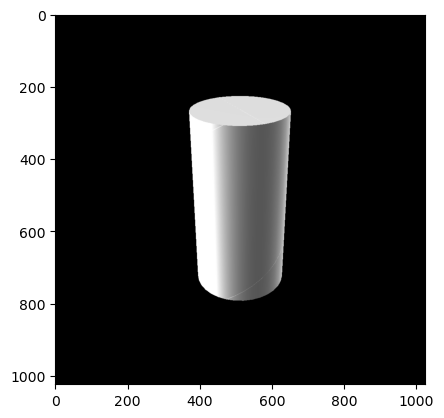

In [175]:
import copy
mesh = copy.deepcopy(orig_mesh)
# (camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.5, 4])#,phi_range=[ 0.2,0.2] ,theta_range=[math.pi / 2 - theta_eps, math.pi / 2 - theta_eps])
(camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.5, 2.5], phi_range=[0, 10], theta_range=[ 3.141 / 2 - 0.5 ,3.142 /2 + 0.5])

lighting, (strength,light_directions) = random_light(strength_range=[20,30])#kal.render.easy_render.default_lighting().cuda()
print(strength,light_directions)
# lighting.amplitude = torch.ones(1,3).cuda() * 8

print(r)


# mesh.materials[0].diffuse_texture = mesh.materials[0].diffuse_texture

img = render(camera, mesh.cuda(), lighting.cuda())
plt.imshow(img.cpu().numpy())

In [176]:
import copy
mesh = copy.deepcopy(orig_mesh)

In [177]:
# lighting.amplitude.dtype

In [178]:
# lighting.from_sun

20.245319528639364 tensor([[-0.9031,  0.3029,  0.3045],
        [ 0.2206,  0.9752,  0.0157]], device='cuda:0', dtype=torch.float64)
3.5381100918032007


/tmp/ipykernel_3339975/1163450222.py:16: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  resnet_predict(torch.tensor(img).cuda())


'cup: 53.3%'

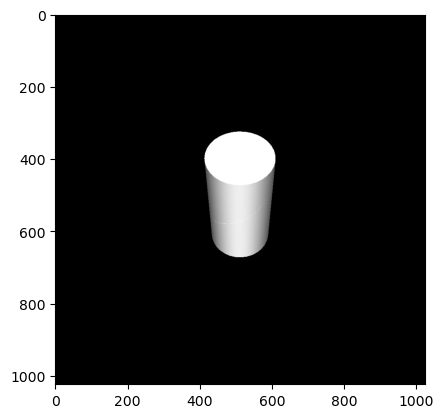

In [179]:
(camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.5, 4])#,phi_range=[ 0.2,0.2] ,theta_range=[math.pi / 2 - theta_eps, math.pi / 2 - theta_eps])
lighting, (strength,light_directions) = random_light(strength_range=[20,30])#kal.render.easy_render.default_lighting().cuda()
print(strength,light_directions)
# lighting.amplitude = torch.ones(1,3).cuda() * 8

print(r)


# mesh.materials[0].diffuse_texture = mesh.materials[0].diffuse_texture

img = render(camera, mesh.cuda(), lighting.cuda())

plt.imshow(img.detach().cpu())


resnet_predict(torch.tensor(img).cuda())

In [180]:
%matplotlib inline

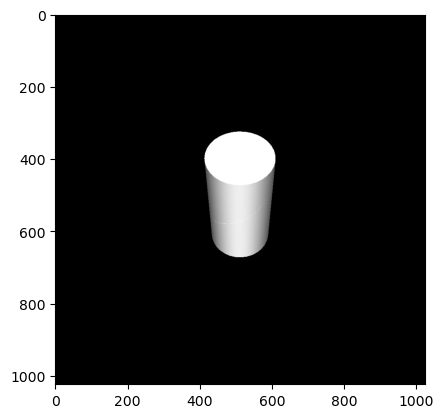

In [181]:
plt.imshow(img.detach().cpu())
plt.show()

In [182]:
import sys
import os
import time
import cv2
from tqdm import tqdm_notebook
import glob
image_dir = '/home/dcor/niskhizov/caltech-101/101_ObjectCategories'
frames = []
images_lst = []
# for image_path in image_paths:
#     image = pygame.image.load(image_path)

#     # Scale the image to fit the screen
#     image = pygame.transform.scale(image, (secondary_screen_width, secondary_screen_height))
#     images_lst.append(image)
image_paths = glob.glob(os.path.join(image_dir, r'*/*.jpg'))

for i,image_path in tqdm_notebook(enumerate(image_paths)):
    image = cv2.imread(image_path)
    image = cv2.resize(image, (1024*2, 1024*2))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # make values between 0 and 1
    image = image / 255
    
    images_lst.append(image)
    break

    

/tmp/ipykernel_3339975/2234239275.py:18: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i,image_path in tqdm_notebook(enumerate(image_paths)):


0it [00:00, ?it/s]

In [183]:
image.max()

1.0

In [184]:

batch_size = 1

# analog_clock_class = torch.tensor([409]*batch_size).cuda()
# wall_clock_class = torch.tensor([892]*batch_size).cuda()
# orig_class = torch.tensor([948]*batch_size).cuda()
orig_clases = [torch.tensor([x]*batch_size).cuda() for x in range(948,959)]



critereon = torch.nn.CrossEntropyLoss()
adv_direction = 100 #None#953# pineapple #None



if adv_direction:
  directed_class = torch.tensor([adv_direction]*batch_size).cuda()

In [185]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'


In [186]:
#generate black-white 
SN = GNSmoothNoise(1024, zero_init=False, num_rgb=1).to(device)

### load saved weights
find the most recent file in /content/drive/MyDrive/Adver_diff_checkpoints

In [28]:

# import glob
# import re
# import os
# import torch
# # weights_paths = glob.glob('/content/drive/MyDrive/Adver_diff_checkpoints/*_without_sds_bs_20.pt')
# # weights_paths.sort(key=lambda f: int(re.sub('\D', '', f)))
# # print(weights_paths[-1])

# files = glob.glob('/home/dcor/niskhizov/adv_diff_checkpoints//*.pt')
# # files.sort(key=os.path.getmtime)
# files.sort(key=os.path.getmtime)
# print(files[-1])

# SN.noise_parameter = torch.load(files[-1]).noise_parameter

In [29]:
# orig_mesh.materials[0].diffuse_texture.min()

In [30]:
# sn = SN(torch.zeros(3,1024,1024).cuda()).cpu().detach()
# print(sn[0]==sn[1])
# # plt.imshow(SN(torch.zeros(3,1024,1024).cuda()).cpu().detach()[2])
# plt.imshow(SN(torch.zeros(3,1024,1024).cuda()).cpu().detach().permute(2,1,0))
# # plt.imshow(SN.noise_parameter.data[5].cpu().permute(2,1,0))
# # plt.imshow(orig_mesh.materials[0].diffuse_texture,aspect='auto')

### sds stuff

In [31]:


from huggingface_hub import hf_hub_download
from torchvision import transforms
from transformers import CLIPTextModel, CLIPTokenizer, CLIPVisionModel,logging,CLIPProcessor
from diffusers import AutoencoderKL, UNet2DConditionModel, PNDMScheduler, EulerDiscreteScheduler, AutoPipelineForImage2Image, StableDiffusionXLPipeline

# suppress partial model loading warning
logging.set_verbosity_error()

import torch
import torch.nn as nn
import torch.nn.functional as F
from loguru import logger
from safetensors.torch import load_file

import time

class StableDiffusion(nn.Module):
    def __init__(self, device, model_name='CompVis/stable-diffusion-v1-4',concept_name=None, latent_mode=True):
        super().__init__()

        try:
            with open('./TOKEN', 'r') as f:
                self.token = f.read().replace('\n', '') # remove the last \n!
                logger.info(f'loaded hugging face access token from ./TOKEN!')
        except FileNotFoundError as e:
            self.token = True
            logger.warning(f'try to load hugging face access token from the default place, make sure you have run `huggingface-cli login`.')

        self.device = device
        self.latent_mode = latent_mode
        self.num_train_timesteps = 1000
        self.min_step = int(self.num_train_timesteps * 0.02)
        self.max_step = int(self.num_train_timesteps * 0.98)

        logger.info(f'loading stable diffusion with {model_name}...')

        # 1. Load the autoencoder model which will be used to decode the latents into image space.
        self.vae = AutoencoderKL.from_pretrained(model_name, subfolder="vae", use_auth_token=self.token).to(self.device)

        # 2. Load the tokenizer and text encoder to tokenize and encode the text.
        self.tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
        self.text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14").to(self.device)
        self.image_encoder = None
        self.image_processor = None


        # 3. The UNet model for generating the latents.
        self.unet = UNet2DConditionModel.from_pretrained(model_name, subfolder="unet", use_auth_token=self.token).to(self.device)


        # print('USING LIGHTNING')
        # # Load model.

        # num_inference_steps = 2
        # base_model = "stabilityai/stable-diffusion-xl-base-1.0"
        # model_repo = "ByteDance/SDXL-Lightning"
        # model_ckpt = f"sdxl_lightning_{num_inference_steps}step_unet.safetensors"
        # self.unet = UNet2DConditionModel.from_config(base_model, subfolder="unet").to('cuda')
        # self.unet.load_state_dict(load_file(hf_hub_download(model_repo, model_ckpt)))

        # pipe = StableDiffusionXLPipeline.from_pretrained(base_model, torch_dtype=torch.float16, variant="fp16")

# Ensure sampler uses "trailing" timesteps.

        # self.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config, timestep_spacing="trailing")

        # del pipe

        # 4. Create a scheduler for inference
        self.scheduler = PNDMScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=self.num_train_timesteps)
        self.alphas = self.scheduler.alphas_cumprod.to(self.device) # for convenience

        if concept_name is not None:
            self.load_concept(concept_name)
        logger.info(f'\t successfully loaded stable diffusion!')

    def load_concept(self, concept_name):
        repo_id_embeds = f"sd-concepts-library/{concept_name}"
        learned_embeds_path = hf_hub_download(repo_id=repo_id_embeds, filename="learned_embeds.bin")
        token_path = hf_hub_download(repo_id=repo_id_embeds, filename="token_identifier.txt")
        with open(token_path, 'r') as file:
            placeholder_token_string = file.read()

        loaded_learned_embeds = torch.load(learned_embeds_path, map_location="cpu")

        # separate token and the embeds
        trained_token = list(loaded_learned_embeds.keys())[0]
        embeds = loaded_learned_embeds[trained_token]

        # cast to dtype of text_encoder
        dtype = self.text_encoder.get_input_embeddings().weight.dtype
        embeds.to(dtype)

        # add the token in tokenizer
        token = trained_token
        num_added_tokens = self.tokenizer.add_tokens(token)
        if num_added_tokens == 0:
            raise ValueError(
                f"The tokenizer already contains the token {token}. Please pass a different `token` that is not already in the tokenizer.")

        # resize the token embeddings
        self.text_encoder.resize_token_embeddings(len(self.tokenizer))

        # get the id for the token and assign the embeds
        token_id = self.tokenizer.convert_tokens_to_ids(token)
        self.text_encoder.get_input_embeddings().weight.data[token_id] = embeds

    def get_text_embeds(self, prompt):
        # Tokenize text and get embeddings
        text_input = self.tokenizer(prompt, padding='max_length', max_length=self.tokenizer.model_max_length, truncation=True, return_tensors='pt')

        with torch.no_grad():
            text_embeddings = self.text_encoder(text_input.input_ids.to(self.device))[0]

        # Do the same for unconditional embeddings
        uncond_input = self.tokenizer([''] * len(prompt), padding='max_length', max_length=self.tokenizer.model_max_length, return_tensors='pt')

        with torch.no_grad():
            uncond_embeddings = self.text_encoder(uncond_input.input_ids.to(self.device))[0]

        # Cat for final embeddings
        text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
        return text_embeddings


    def train_step(self, text_embeddings, inputs, guidance_scale=100):

        # interp to 512x512 to be fed into vae.

        # _t = time.time()
        if not self.latent_mode:
        # latents = F.interpolate(latents, (64, 64), mode='bilinear', align_corners=False)
            pred_rgb_512 = F.interpolate(inputs, (512, 512), mode='bilinear', align_corners=False)
            latents = self.encode_imgs(pred_rgb_512)
        else:
            latents = inputs
        # torch.cuda.synchronize(); print(f'[TIME] guiding: interp {time.time() - _t:.4f}s')

        # timestep ~ U(0.02, 0.98) to avoid very high/low noise level
        t = torch.randint(self.min_step, self.max_step + 1, [1], dtype=torch.long, device=self.device)

        # encode image into latents with vae, requires grad!
        # _t = time.time()

        # torch.cuda.synchronize(); print(f'[TIME] guiding: vae enc {time.time() - _t:.4f}s')

        # predict the noise residual with unet, NO grad!
        # _t = time.time()
        with torch.no_grad():
            # add noise
            noise = torch.randn_like(latents)
            latents_noisy = self.scheduler.add_noise(latents, noise, t)
            # pred noise
            latent_model_input = torch.cat([latents_noisy] * 2)
            noise_pred = self.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
        # torch.cuda.synchronize(); print(f'[TIME] guiding: unet {time.time() - _t:.4f}s')

        # perform guidance (high scale from paper!)
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        # w(t), alpha_t * sigma_t^2
        # w = (1 - self.alphas[t])
        w = self.alphas[t] ** 0.5 * (1 - self.alphas[t])
        grad = w * (noise_pred - noise)

        # clip grad for stable training?
        # grad = grad.clamp(-1, 1)

        # manually backward, since we omitted an item in grad and cannot simply autodiff.
        # _t = time.time()
        latents.backward(gradient=grad, retain_graph=True)
        # torch.cuda.synchronize(); print(f'[TIME] guiding: backward {time.time() - _t:.4f}s')

        return grad # dummy loss value

    def produce_latents(self, text_embeddings, height=512, width=512, num_inference_steps=50, guidance_scale=7.5, latents=None):

        if latents is None:
            latents = torch.randn((text_embeddings.shape[0] // 2, self.unet.in_channels, height // 8, width // 8), device=self.device)

        self.scheduler.set_timesteps(num_inference_steps)

        with torch.autocast('cuda'):
            for i, t in enumerate(self.scheduler.timesteps):
                # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.
                latent_model_input = torch.cat([latents] * 2)

                # predict the noise residual
                with torch.no_grad():
                    noise_pred = self.unet(latent_model_input, t, encoder_hidden_states=text_embeddings)['sample']

                # perform guidance
                noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
                noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

                # compute the previous noisy sample x_t -> x_t-1
                latents = self.scheduler.step(noise_pred, t, latents)['prev_sample']

        return latents

    def decode_latents(self, latents):
        # latents = F.interpolate(latents, (64, 64), mode='bilinear', align_corners=False)
        latents = 1 / 0.18215 * latents

        with torch.no_grad():
            imgs = self.vae.decode(latents).sample

        imgs = (imgs / 2 + 0.5).clamp(0, 1)

        return imgs

    def encode_imgs(self, imgs):
        # imgs: [B, 3, H, W]

        imgs = 2 * imgs - 1

        posterior = self.vae.encode(imgs).latent_dist
        latents = posterior.sample() * 0.18215

        return latents

    def prompt_to_img(self, prompts, height=512, width=512, num_inference_steps=50, guidance_scale=7.5, latents=None):

        if isinstance(prompts, str):
            prompts = [prompts]

        # Prompts -> text embeds
        text_embeds = self.get_text_embeds(prompts) # [2, 77, 768]

        # Text embeds -> img latents
        latents = self.produce_latents(text_embeds, height=height, width=width, latents=latents, num_inference_steps=num_inference_steps, guidance_scale=guidance_scale) # [1, 4, 64, 64]

        # Img latents -> imgs
        imgs = self.decode_latents(latents) # [1, 3, 512, 512]

        # Img to Numpy
        imgs = imgs.detach().cpu().permute(0, 2, 3, 1).numpy()
        imgs = (imgs * 255).round().astype('uint8')

        return imgs

In [32]:
import torch.nn.functional as F


In [33]:
# sd = StableDiffusion('cuda',latent_mode=False)

# text_embed = sd.get_text_embeds(['white sheet of paper'])

### augmenter net

In [34]:
import torch
import torch.nn as nn


def get_conv_inorm_relu(in_planes, out_planes, kernel_size, stride, reflection_pad=True, with_relu=True):
    layers = []
    padding = (kernel_size - 1) // 2
    if reflection_pad:
        layers.append(nn.ReflectionPad2d(padding=padding))
        padding = 0
    layers += [
        nn.Conv2d(in_planes, out_planes, kernel_size=kernel_size, stride=stride, padding=padding),
        nn.InstanceNorm2d(out_planes, affine=False, track_running_stats=False),
    ]
    if with_relu:
        layers.append(nn.ReLU(inplace=True))
    return nn.Sequential(*layers)


def get_conv_transposed_inorm_relu(in_planes, out_planes, kernel_size, stride):
    return nn.Sequential(
        nn.ConvTranspose2d(in_planes, out_planes, kernel_size=kernel_size, stride=stride, padding=1, output_padding=1),
        nn.InstanceNorm2d(out_planes, affine=False, track_running_stats=False),
        nn.ReLU(inplace=True)
    )


class ResidualBlock(nn.Module):
    
    def __init__(self, in_planes):
        super(ResidualBlock, self).__init__()
        self.conv1 = get_conv_inorm_relu(in_planes, in_planes, kernel_size=3, stride=1)
        self.conv2 = get_conv_inorm_relu(in_planes, in_planes, kernel_size=3, stride=1, with_relu=False)        

    def forward(self, x):
        residual = x
        x = self.conv1(x)
        x = self.conv2(x)        
        return x + residual


class Generator(nn.Module):
    
    def __init__(self):
        super(Generator, self).__init__()
        
        self.c7s1_64 = get_conv_inorm_relu(3, 64, kernel_size=7, stride=1)
        self.d128 = get_conv_inorm_relu(64, 128, kernel_size=3, stride=2, reflection_pad=False)
        self.d256 = get_conv_inorm_relu(128, 256, kernel_size=3, stride=2, reflection_pad=False)

        self.resnet9 = nn.Sequential(*[ResidualBlock(256) for i in range(9)])

        self.u128 = get_conv_transposed_inorm_relu(256, 128, kernel_size=3, stride=2)
        self.u64 = get_conv_transposed_inorm_relu(128, 64, kernel_size=3, stride=2)
        self.c7s1_3 = get_conv_inorm_relu(64, 3, kernel_size=7, stride=1, with_relu=False)
        # Replace instance norm by tanh activation
        self.c7s1_3[-1] = nn.Tanh()

    def forward(self, x):
        # Encoding
        x = self.c7s1_64(x)
        x = self.d128(x)
        x = self.d256(x)
        
        # 9 residual blocks
        x = self.resnet9(x)

        # Decoding
        x = self.u128(x)
        x = self.u64(x)
        y = self.c7s1_3(x)
        return y
    
aug_net = Generator().to('cuda')
aug_net.load_state_dict(torch.load('/home/dcor/niskhizov/gan_unet2.pth'))

aug_resize = T.Resize((264, 264)) 

def augment_image(image):
    with torch.no_grad():
        img_resh = aug_resize(image.permute(2, 0, 1))
        img_resh = img_resh.unsqueeze(0)
        o = aug_net(img_resh)
        o = (o - o.min()) / (o.max() - o.min())
        
        return o.squeeze(0).permute(1, 2, 0)


/tmp/ipykernel_2232909/2724714504.py:75: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  aug_net.load_state_dict(torch.load('/home/dcor/niskhizov/gan_unet2.pth'))


### training

In [187]:
texture_noise_optim = torch.optim.Adam(params=list(p for p in SN.parameters() if p.requires_grad), lr=0.01)
#add lr reduce scheduler
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(texture_noise_optim, mode='min', factor=0.1, patience=10, verbose=True)

/home/dcor/niskhizov/anaconda3/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [188]:
# import lpips
# # loss_fn_alex = lpips.LPIPS(net='alex') # best forward scores
# loss_fn_vgg = lpips.LPIPS(net='vgg').to(device)

In [189]:
#freeze all parameters of resnet model
model = model.to(device)
for param in model.parameters():
  param.requires_grad = False

mesh = mesh.to(device)
orig_mesh = orig_mesh.to(device)

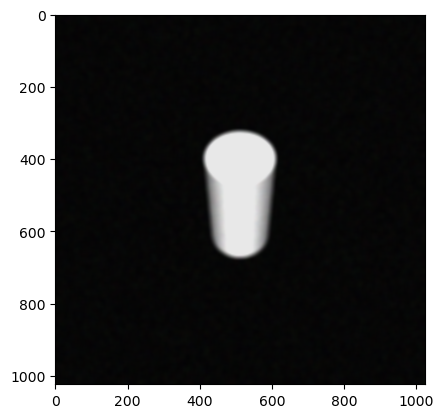

In [190]:
plt.imshow(effect(img).cpu())

In [39]:
# torch.autograd.set_detect_anomaly(True)

COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch.
COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.


exeriment time 2024-12-14 23:42:38


COMET INFO: Experiment is live on comet.com https://www.comet.com/dannynis/adversarial-diff-rendering-notebook-v3/71a3bb3ac03840eea500ee982579175f

COMET WARNING: unable to find caller source code in a jupyter notebook; ignoring
COMET INFO: Couldn't find a Git repository in '/home/dcor/niskhizov' nor in any parent directory. Set `COMET_GIT_DIRECTORY` if your Git Repository is elsewhere.
COMET INFO: The process of logging environment details (conda environment, git patch) is underway. Please be patient as this may take some time.
COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch.
COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch.
COMET WARNING: As you are running in a Jupyter environment, you will need to call `experiment.end()` when finished to ensure all metrics and code are logged before exiting.
COMET INFO: Experiment is live on comet.com https://www.comet.com/dannynis/adver

  0%|          | 0/350000 [00:00<?, ?it/s]

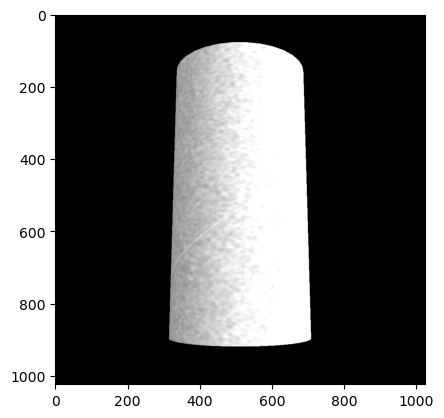

idx 0 - img_loss: 0.016242370009422302, adv_loss 8.131159782409668, grad norm 14.62484073638916, lpips_loss 0
idx 0 - img_loss: 0.016242370009422302, adv_loss 8.131159782409668, grad norm 14.62484073638916, lpips_loss 0
lampshade: 34.8%
lampshade: 38.0%


/tmp/ipykernel_3339975/3765461146.py:192: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  irs = resnet_predict(torch.tensor(image.detach().cpu()).cuda())
/tmp/ipykernel_3339975/3765461146.py:193: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gtrs = resnet_predict(torch.tensor(gt_image.detach().cpu()).cuda())
/tmp/ipykernel_3339975/3765461146.py:202: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  print(resnet_predict(torch.tensor(image.detach().cpu()).cuda()))
/tmp/ipykernel_3339975/3765461146.py:203: UserWarning: To copy construct from a ten

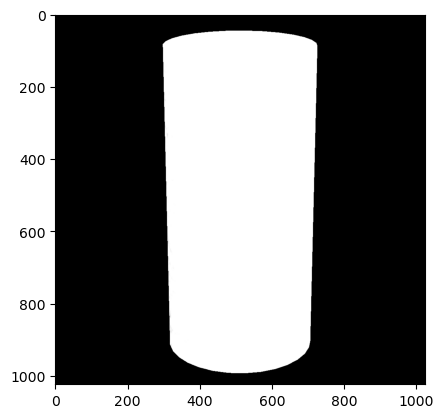

idx 1000 - img_loss: 0.00012451160000637174, adv_loss 8.509136199951172, grad norm 0.3566189706325531, lpips_loss 0


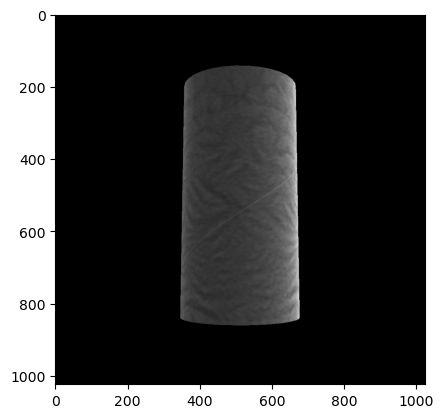

idx 2000 - img_loss: 0.01303073950111866, adv_loss 7.887507438659668, grad norm 9.250895500183105, lpips_loss 0
idx 2000 - img_loss: 0.01303073950111866, adv_loss 7.887507438659668, grad norm 9.250895500183105, lpips_loss 0
paper towel: 24.9%
lampshade: 16.5%


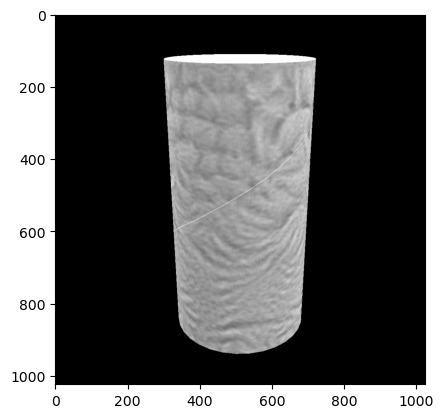

idx 3000 - img_loss: 0.03550980985164642, adv_loss 7.879764080047607, grad norm 8.142498016357422, lpips_loss 0


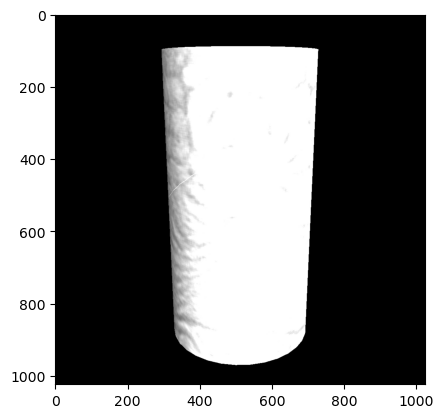

idx 4000 - img_loss: 0.009690608829259872, adv_loss 8.116870880126953, grad norm 1.1183640956878662, lpips_loss 0
idx 4000 - img_loss: 0.009690608829259872, adv_loss 8.116870880126953, grad norm 1.1183640956878662, lpips_loss 0
paper towel: 16.2%
vase: 10.2%


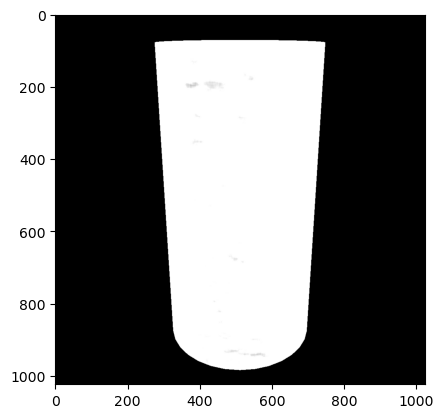

idx 5000 - img_loss: 0.0006211395375430584, adv_loss 8.185379028320312, grad norm 0.0053131114691495895, lpips_loss 0


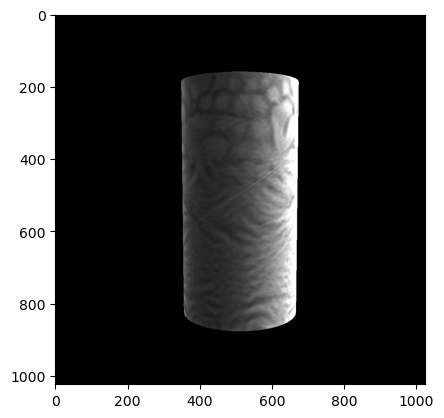

idx 6000 - img_loss: 0.02603604644536972, adv_loss 7.409426689147949, grad norm 2.6104211807250977, lpips_loss 0
idx 6000 - img_loss: 0.02603604644536972, adv_loss 7.409426689147949, grad norm 2.6104211807250977, lpips_loss 0
paper towel: 20.7%
lighter: 7.9%


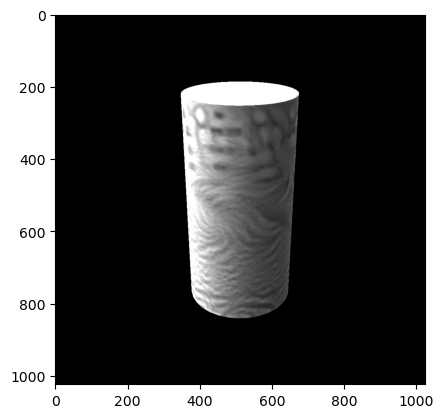

idx 7000 - img_loss: 0.035124290734529495, adv_loss 7.539902687072754, grad norm 2.9271140098571777, lpips_loss 0


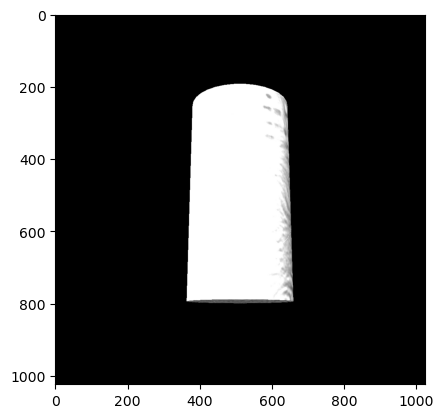

idx 8000 - img_loss: 0.008233089931309223, adv_loss 7.798497200012207, grad norm 0.7620417475700378, lpips_loss 0
idx 8000 - img_loss: 0.008233089931309223, adv_loss 7.798497200012207, grad norm 0.7620417475700378, lpips_loss 0
oil filter: 19.4%
lampshade: 19.6%


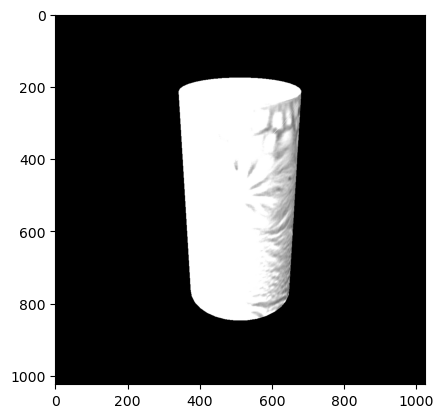

idx 9000 - img_loss: 0.02183029241859913, adv_loss 8.303400993347168, grad norm 3.2511112689971924, lpips_loss 0


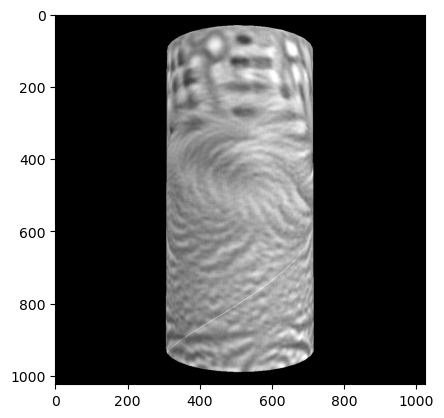

idx 10000 - img_loss: 0.0715775191783905, adv_loss 6.874799728393555, grad norm 2.5808663368225098, lpips_loss 0
idx 10000 - img_loss: 0.0715775191783905, adv_loss 6.874799728393555, grad norm 2.5808663368225098, lpips_loss 0
thimble: 5.2%
lampshade: 13.9%


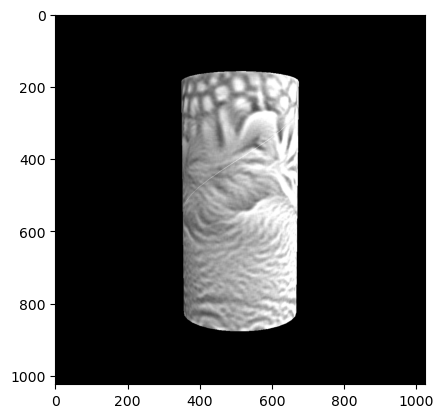

idx 11000 - img_loss: 0.08219505846500397, adv_loss 6.930334568023682, grad norm 2.6908297538757324, lpips_loss 0


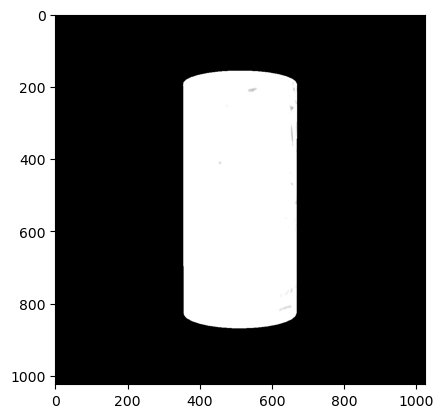

idx 12000 - img_loss: 0.0008898804080672562, adv_loss 8.62190055847168, grad norm 0.05067748948931694, lpips_loss 0
idx 12000 - img_loss: 0.0008898804080672562, adv_loss 8.62190055847168, grad norm 0.05067748948931694, lpips_loss 0
oil filter: 8.9%
lampshade: 13.5%


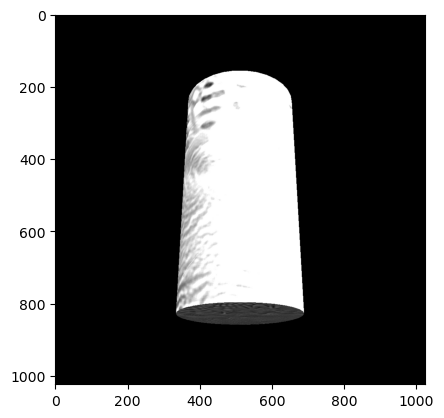

idx 13000 - img_loss: 0.024462632834911346, adv_loss 7.078299522399902, grad norm 5.161777973175049, lpips_loss 0


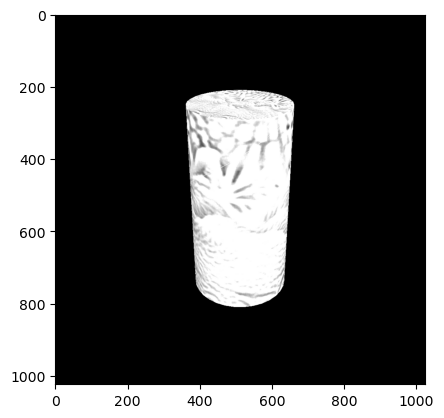

idx 14000 - img_loss: 0.04973210021853447, adv_loss 8.159927368164062, grad norm 1.6419867277145386, lpips_loss 0
idx 14000 - img_loss: 0.04973210021853447, adv_loss 8.159927368164062, grad norm 1.6419867277145386, lpips_loss 0
thimble: 10.3%
coffee mug: 9.8%


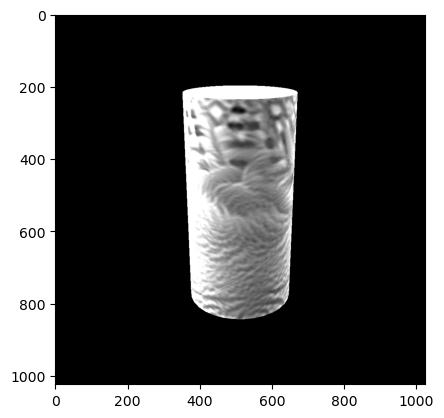

idx 15000 - img_loss: 0.07236707955598831, adv_loss 7.298872947692871, grad norm 4.503555774688721, lpips_loss 0


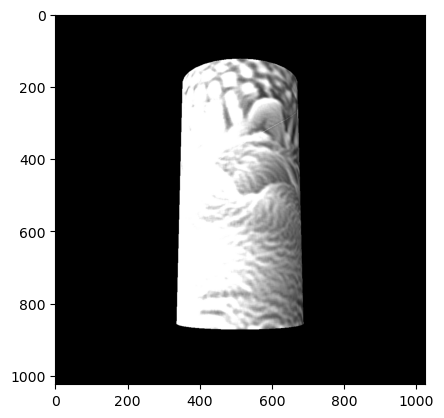

idx 16000 - img_loss: 0.06413445621728897, adv_loss 7.1778717041015625, grad norm 2.3661530017852783, lpips_loss 0
idx 16000 - img_loss: 0.06413445621728897, adv_loss 7.1778717041015625, grad norm 2.3661530017852783, lpips_loss 0
thimble: 23.6%
lampshade: 14.3%


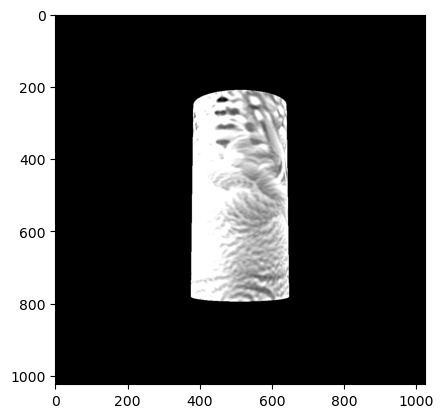

idx 17000 - img_loss: 0.08099080622196198, adv_loss 7.081864356994629, grad norm 2.3620076179504395, lpips_loss 0


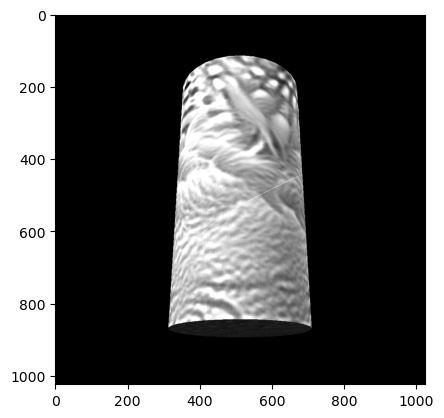

idx 18000 - img_loss: 0.10275402665138245, adv_loss 6.676671504974365, grad norm 3.5341227054595947, lpips_loss 0
idx 18000 - img_loss: 0.10275402665138245, adv_loss 6.676671504974365, grad norm 3.5341227054595947, lpips_loss 0
thimble: 11.2%
lampshade: 36.6%


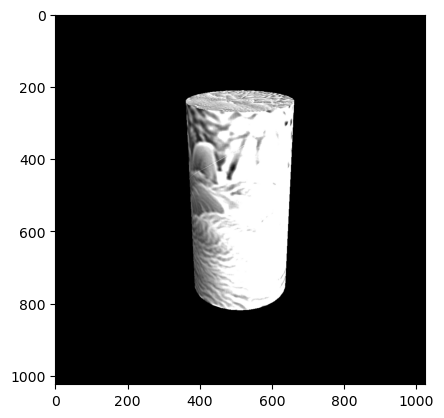

idx 19000 - img_loss: 0.0665275901556015, adv_loss 7.911872863769531, grad norm 3.4823176860809326, lpips_loss 0


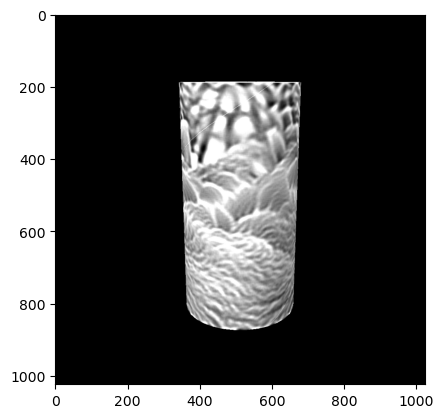

idx 20000 - img_loss: 0.1440621316432953, adv_loss 6.864688873291016, grad norm 6.4184794425964355, lpips_loss 0
idx 20000 - img_loss: 0.1440621316432953, adv_loss 6.864688873291016, grad norm 6.4184794425964355, lpips_loss 0
black swan: 17.9%
vase: 10.7%


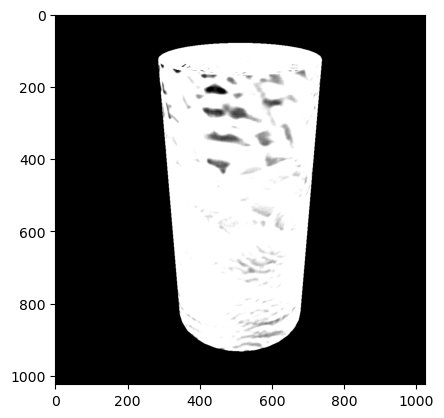

idx 21000 - img_loss: 0.0344829186797142, adv_loss 7.951136112213135, grad norm 7.853328227996826, lpips_loss 0


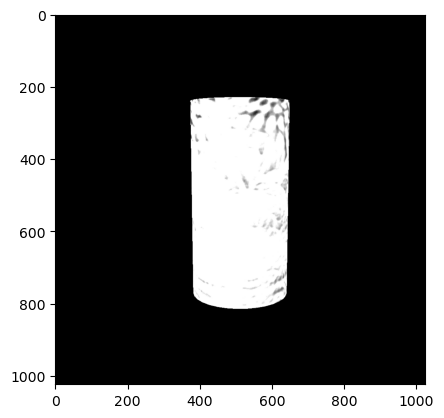

idx 22000 - img_loss: 0.022914612665772438, adv_loss 8.39438247680664, grad norm 3.823376178741455, lpips_loss 0
idx 22000 - img_loss: 0.022914612665772438, adv_loss 8.39438247680664, grad norm 3.823376178741455, lpips_loss 0
red wine: 7.3%
table lamp: 9.4%


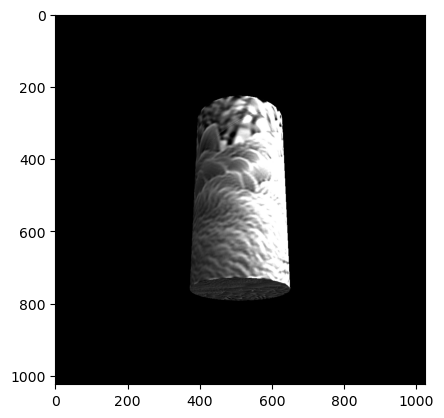

idx 23000 - img_loss: 0.0865277573466301, adv_loss 7.265888214111328, grad norm 3.109447956085205, lpips_loss 0


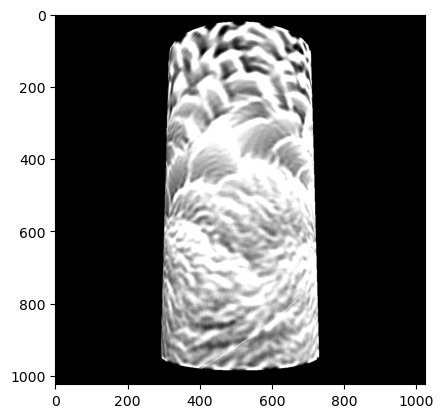

idx 24000 - img_loss: 0.18027710914611816, adv_loss 2.2898740768432617, grad norm 23.817916870117188, lpips_loss 0
idx 24000 - img_loss: 0.18027710914611816, adv_loss 2.2898740768432617, grad norm 23.817916870117188, lpips_loss 0
black swan: 30.8%
lampshade: 27.6%


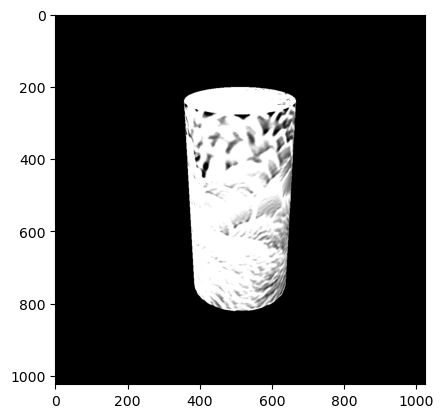

idx 25000 - img_loss: 0.08610899746417999, adv_loss 7.6970624923706055, grad norm 4.259101867675781, lpips_loss 0


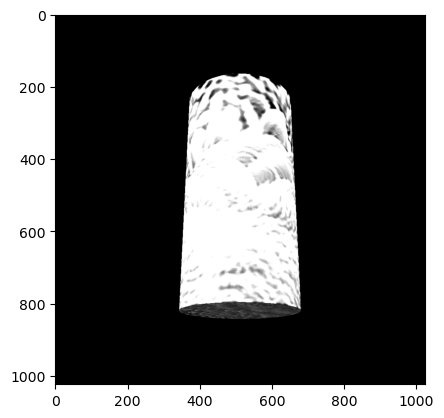

idx 26000 - img_loss: 0.05839904025197029, adv_loss 6.495781421661377, grad norm 23.056642532348633, lpips_loss 0
idx 26000 - img_loss: 0.05839904025197029, adv_loss 6.495781421661377, grad norm 23.056642532348633, lpips_loss 0
lampshade: 14.3%
lampshade: 31.0%


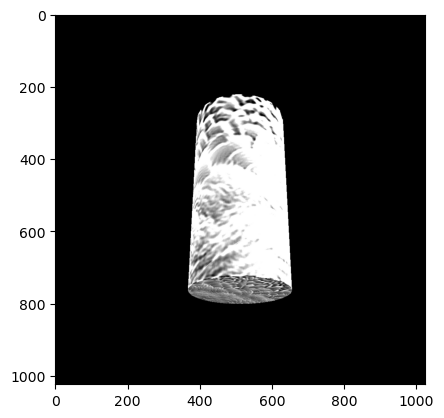

idx 27000 - img_loss: 0.11493725329637527, adv_loss 7.607813358306885, grad norm 5.17501974105835, lpips_loss 0
nan found in prediction


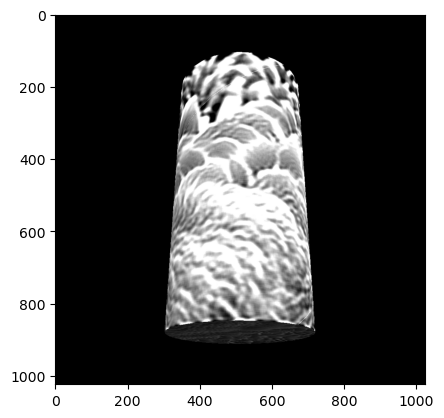

idx 28000 - img_loss: 0.20155251026153564, adv_loss 4.738083362579346, grad norm 37.66265869140625, lpips_loss 0
idx 28000 - img_loss: 0.20155251026153564, adv_loss 4.738083362579346, grad norm 37.66265869140625, lpips_loss 0
black swan: 38.4%
lampshade: 42.0%


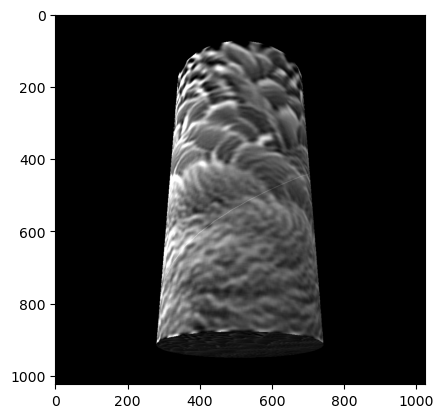

idx 29000 - img_loss: 0.11340251564979553, adv_loss 1.4069297313690186, grad norm 7.614928722381592, lpips_loss 0


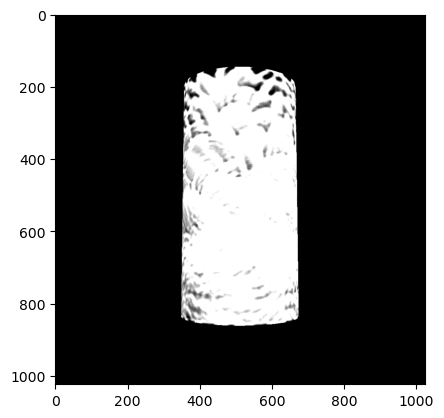

idx 30000 - img_loss: 0.051449839025735855, adv_loss 7.7073259353637695, grad norm 5.961044788360596, lpips_loss 0
idx 30000 - img_loss: 0.051449839025735855, adv_loss 7.7073259353637695, grad norm 5.961044788360596, lpips_loss 0
lampshade: 10.6%
lampshade: 16.5%


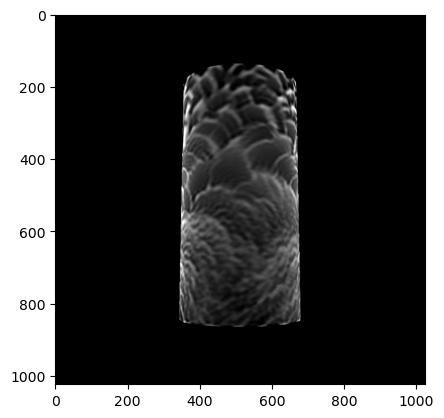

idx 31000 - img_loss: 0.09384885430335999, adv_loss 0.809546947479248, grad norm 2.7588791847229004, lpips_loss 0


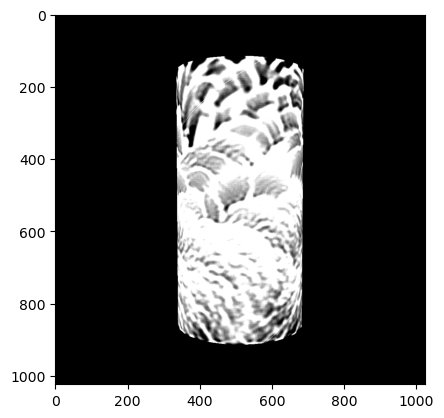

idx 32000 - img_loss: 0.16419216990470886, adv_loss 6.435786247253418, grad norm 16.523883819580078, lpips_loss 0
idx 32000 - img_loss: 0.16419216990470886, adv_loss 6.435786247253418, grad norm 16.523883819580078, lpips_loss 0
black swan: 52.2%
lampshade: 14.2%


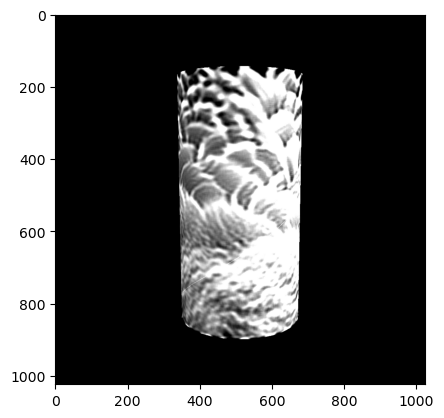

idx 33000 - img_loss: 0.1962173581123352, adv_loss 2.008759021759033, grad norm 15.349528312683105, lpips_loss 0


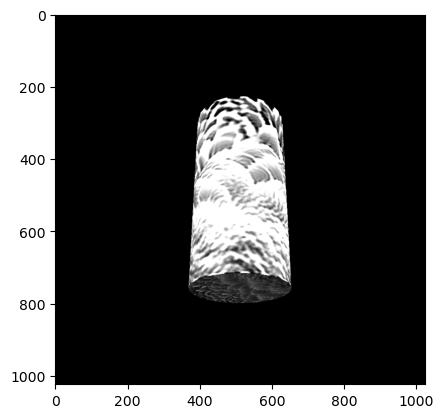

idx 34000 - img_loss: 0.1625211387872696, adv_loss 6.893350601196289, grad norm 7.261134147644043, lpips_loss 0
idx 34000 - img_loss: 0.1625211387872696, adv_loss 6.893350601196289, grad norm 7.261134147644043, lpips_loss 0
knot: 10.8%
lampshade: 30.3%
nan found in prediction


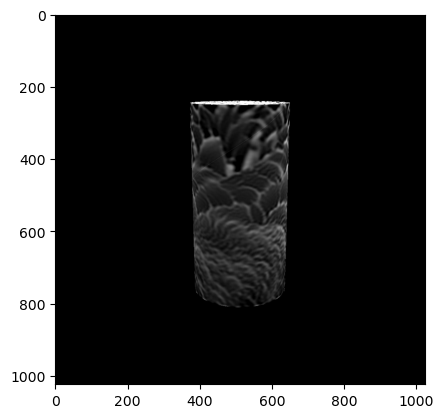

idx 35000 - img_loss: 0.08245966583490372, adv_loss 8.176200866699219, grad norm 2.1872239112854004, lpips_loss 0


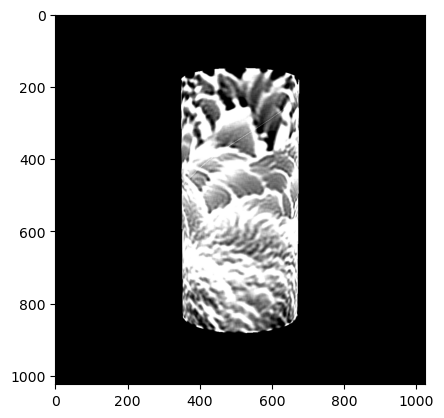

idx 36000 - img_loss: 0.26731401681900024, adv_loss 1.2488512992858887, grad norm 9.238253593444824, lpips_loss 0
idx 36000 - img_loss: 0.26731401681900024, adv_loss 1.2488512992858887, grad norm 9.238253593444824, lpips_loss 0
black swan: 46.2%
lighter: 7.9%
nan found in prediction


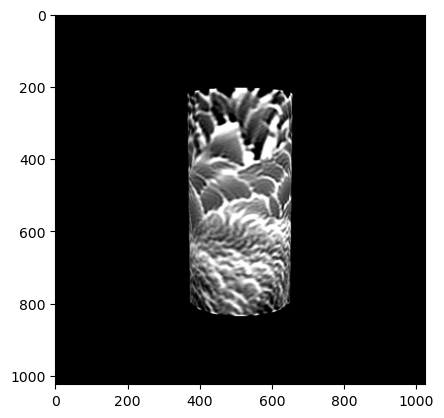

idx 37000 - img_loss: 0.2705019414424896, adv_loss 0.8855534195899963, grad norm 4.028556823730469, lpips_loss 0


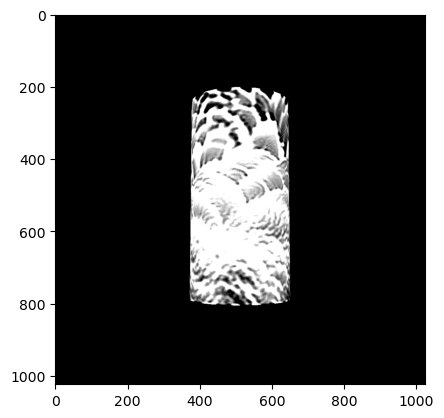

idx 38000 - img_loss: 0.16666655242443085, adv_loss 5.9651079177856445, grad norm 19.16498565673828, lpips_loss 0
idx 38000 - img_loss: 0.16666655242443085, adv_loss 5.9651079177856445, grad norm 19.16498565673828, lpips_loss 0
black swan: 46.0%
lampshade: 21.0%
nan found in prediction


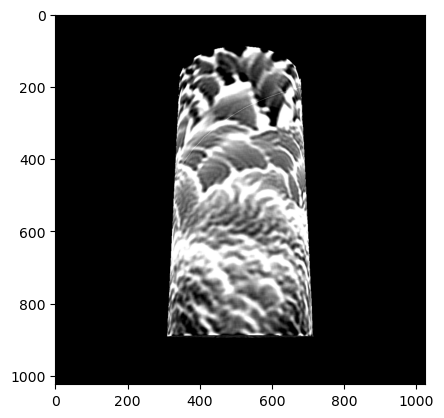

idx 39000 - img_loss: 0.30676910281181335, adv_loss 0.4650503396987915, grad norm 2.330033779144287, lpips_loss 0


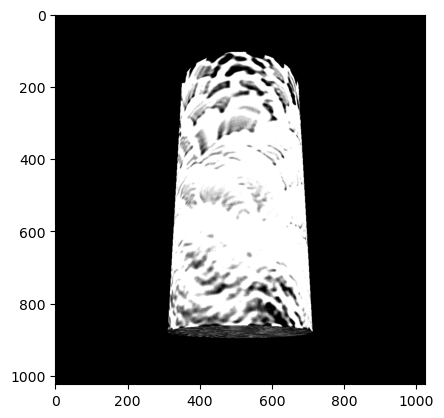

idx 40000 - img_loss: 0.11600901931524277, adv_loss 3.6954774856567383, grad norm 53.19613265991211, lpips_loss 0
idx 40000 - img_loss: 0.11600901931524277, adv_loss 3.6954774856567383, grad norm 53.19613265991211, lpips_loss 0
thimble: 4.9%
lampshade: 34.0%


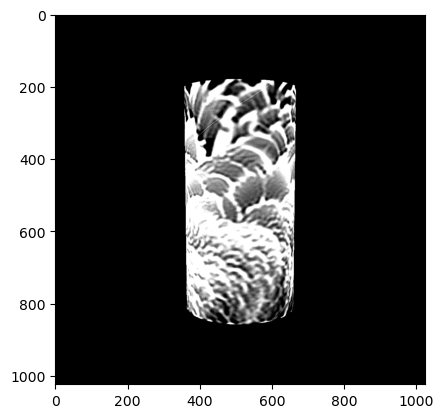

idx 41000 - img_loss: 0.30820244550704956, adv_loss 0.6102179288864136, grad norm 7.044480800628662, lpips_loss 0


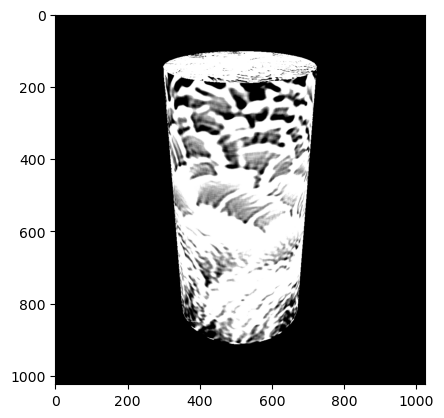

idx 42000 - img_loss: 0.1638811081647873, adv_loss 4.75991678237915, grad norm 40.45977783203125, lpips_loss 0
idx 42000 - img_loss: 0.1638811081647873, adv_loss 4.75991678237915, grad norm 40.45977783203125, lpips_loss 0
thimble: 8.6%
vase: 10.1%
nan found in prediction


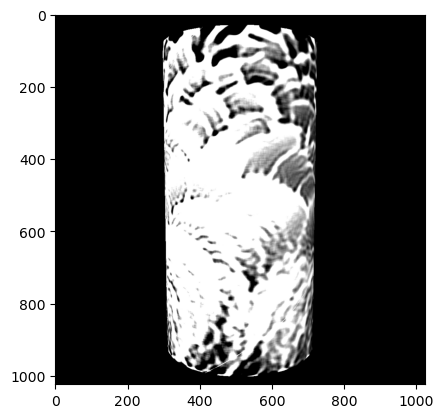

idx 43000 - img_loss: 0.15669137239456177, adv_loss 2.7251992225646973, grad norm 38.34148406982422, lpips_loss 0


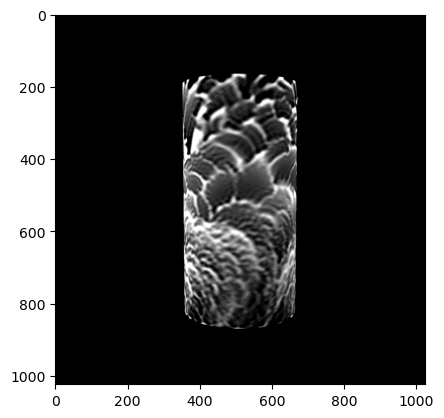

idx 44000 - img_loss: 0.26594752073287964, adv_loss 0.6041480898857117, grad norm 1.3956949710845947, lpips_loss 0
idx 44000 - img_loss: 0.26594752073287964, adv_loss 0.6041480898857117, grad norm 1.3956949710845947, lpips_loss 0
black swan: 68.4%
lighter: 8.5%


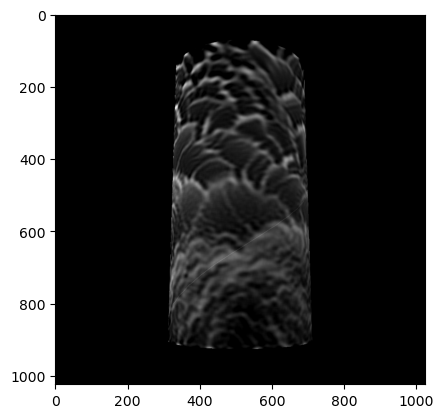

idx 45000 - img_loss: 0.1102251335978508, adv_loss 0.4664943218231201, grad norm 1.6935375928878784, lpips_loss 0


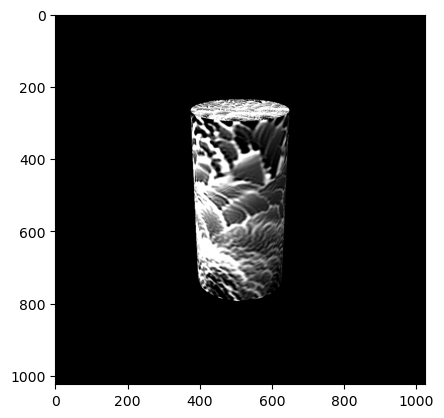

idx 46000 - img_loss: 0.2550857961177826, adv_loss 7.0938544273376465, grad norm 12.72225284576416, lpips_loss 0
idx 46000 - img_loss: 0.2550857961177826, adv_loss 7.0938544273376465, grad norm 12.72225284576416, lpips_loss 0
black swan: 19.9%
coffee mug: 35.2%


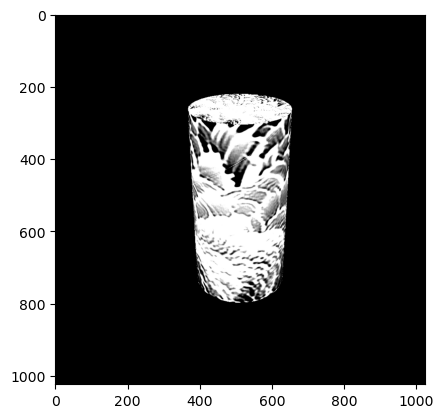

idx 47000 - img_loss: 0.17647384107112885, adv_loss 7.430690765380859, grad norm 8.054727554321289, lpips_loss 0


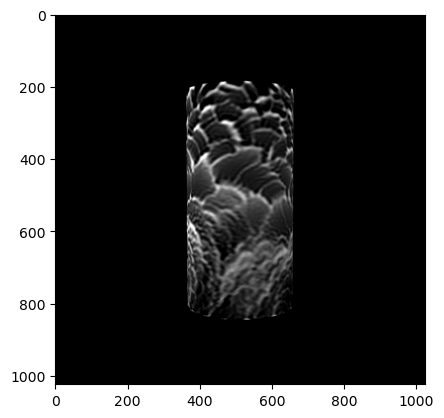

idx 48000 - img_loss: 0.18975712358951569, adv_loss 0.5281901955604553, grad norm 0.8078818917274475, lpips_loss 0
idx 48000 - img_loss: 0.18975712358951569, adv_loss 0.5281901955604553, grad norm 0.8078818917274475, lpips_loss 0
black swan: 66.9%
lampshade: 18.1%


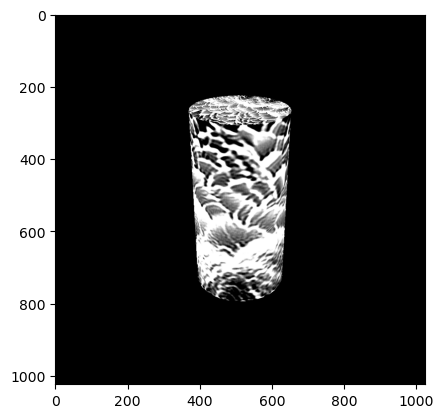

idx 49000 - img_loss: 0.3073786497116089, adv_loss 7.431883335113525, grad norm 6.099527359008789, lpips_loss 0


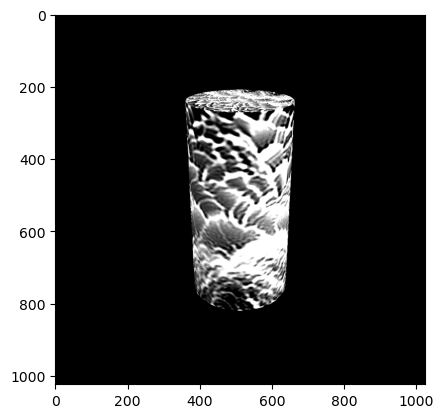

idx 50000 - img_loss: 0.3116239905357361, adv_loss 2.0964245796203613, grad norm 9.583983421325684, lpips_loss 0
idx 50000 - img_loss: 0.3116239905357361, adv_loss 2.0964245796203613, grad norm 9.583983421325684, lpips_loss 0
candle: 9.2%
coffee mug: 9.7%
nan found in prediction


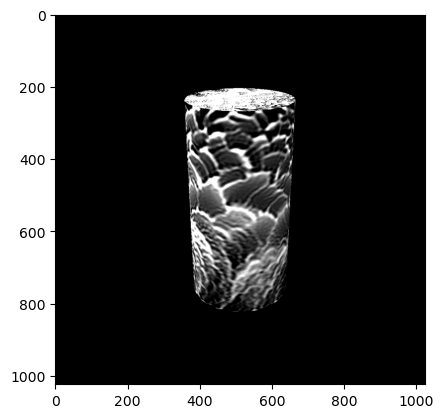

idx 51000 - img_loss: 0.31157514452934265, adv_loss 1.6448246240615845, grad norm 6.090329647064209, lpips_loss 0


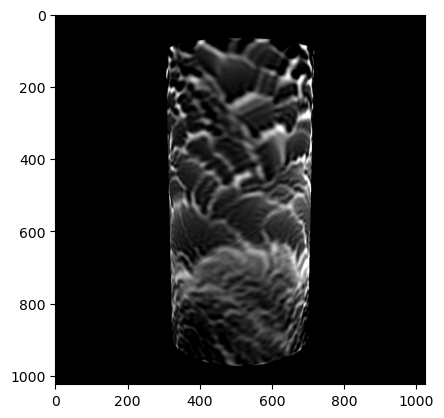

idx 52000 - img_loss: 0.1799667775630951, adv_loss 0.3754348158836365, grad norm 1.541654109954834, lpips_loss 0
idx 52000 - img_loss: 0.1799667775630951, adv_loss 0.3754348158836365, grad norm 1.541654109954834, lpips_loss 0
black swan: 82.3%
lampshade: 6.5%


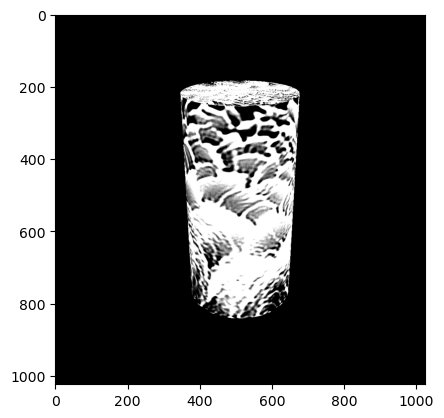

idx 53000 - img_loss: 0.19378706812858582, adv_loss 3.2494497299194336, grad norm 31.20540428161621, lpips_loss 0


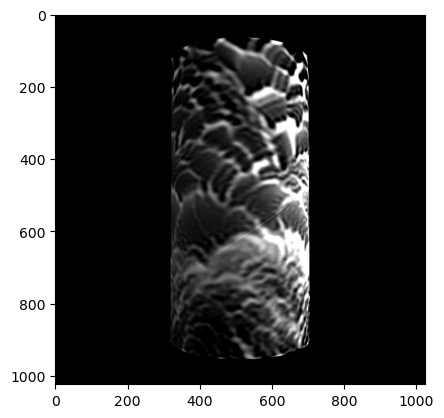

idx 54000 - img_loss: 0.21616964042186737, adv_loss 0.3558332920074463, grad norm 1.7759058475494385, lpips_loss 0
idx 54000 - img_loss: 0.21616964042186737, adv_loss 0.3558332920074463, grad norm 1.7759058475494385, lpips_loss 0
black swan: 78.3%
lampshade: 13.9%


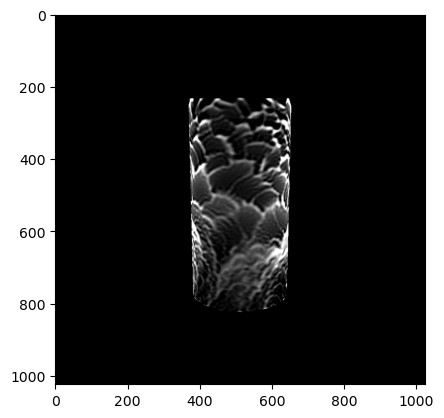

idx 55000 - img_loss: 0.22639821469783783, adv_loss 0.6349964737892151, grad norm 1.0756607055664062, lpips_loss 0


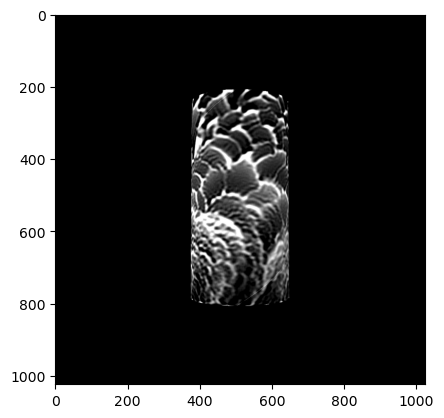

idx 56000 - img_loss: 0.3712987005710602, adv_loss 0.39013832807540894, grad norm 1.2501635551452637, lpips_loss 0
idx 56000 - img_loss: 0.3712987005710602, adv_loss 0.39013832807540894, grad norm 1.2501635551452637, lpips_loss 0
black swan: 67.7%
lampshade: 24.8%


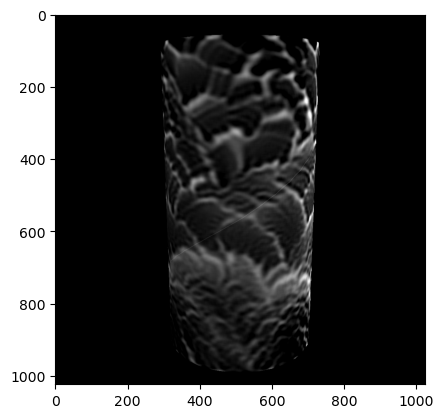

idx 57000 - img_loss: 0.13056404888629913, adv_loss 0.3408472239971161, grad norm 1.1638747453689575, lpips_loss 0


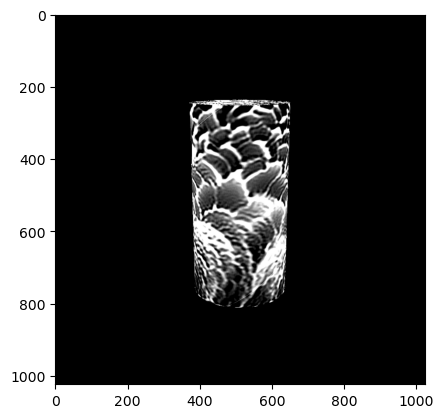

idx 58000 - img_loss: 0.46505987644195557, adv_loss 1.0627553462982178, grad norm 6.866098403930664, lpips_loss 0
idx 58000 - img_loss: 0.46505987644195557, adv_loss 1.0627553462982178, grad norm 6.866098403930664, lpips_loss 0
black swan: 52.6%
coffee mug: 6.5%


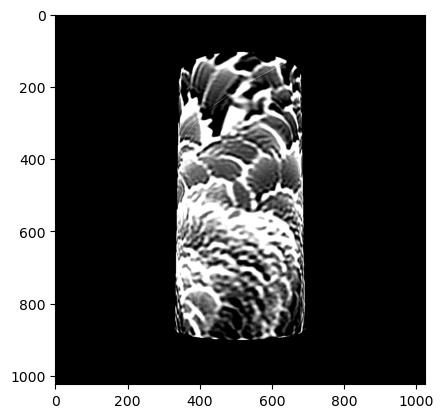

idx 59000 - img_loss: 0.42036253213882446, adv_loss 0.5897969007492065, grad norm 5.18746280670166, lpips_loss 0


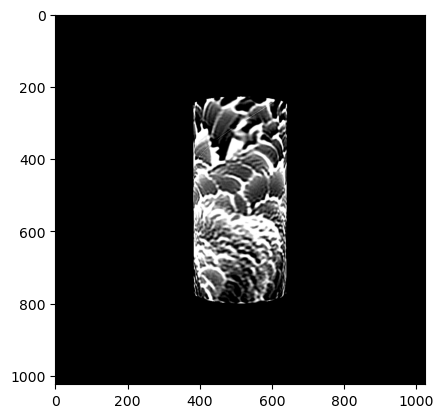

idx 60000 - img_loss: 0.4580065906047821, adv_loss 0.5608738660812378, grad norm 1.840596079826355, lpips_loss 0
idx 60000 - img_loss: 0.4580065906047821, adv_loss 0.5608738660812378, grad norm 1.840596079826355, lpips_loss 0
black swan: 60.0%
lampshade: 14.0%


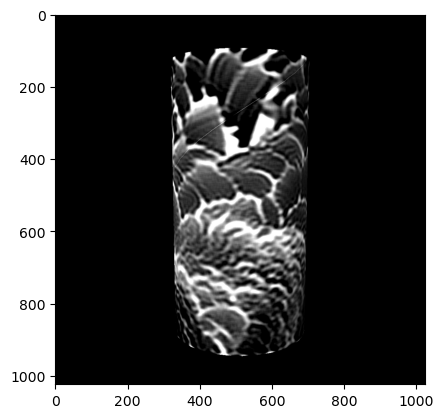

idx 61000 - img_loss: 0.3693327009677887, adv_loss 0.32148104906082153, grad norm 2.015984535217285, lpips_loss 0


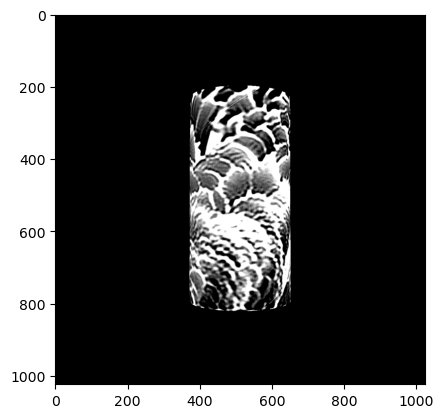

idx 62000 - img_loss: 0.35462552309036255, adv_loss 0.5770791172981262, grad norm 2.039191961288452, lpips_loss 0
idx 62000 - img_loss: 0.35462552309036255, adv_loss 0.5770791172981262, grad norm 2.039191961288452, lpips_loss 0
black swan: 65.5%
lampshade: 13.0%


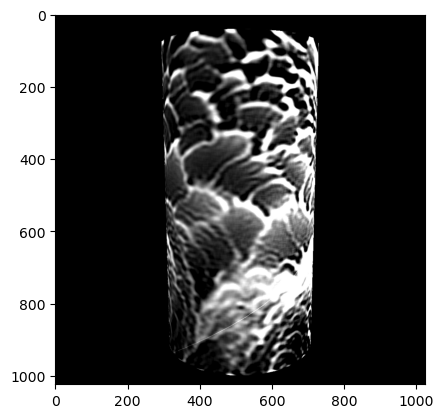

idx 63000 - img_loss: 0.34362345933914185, adv_loss 0.4645000696182251, grad norm 2.2232272624969482, lpips_loss 0


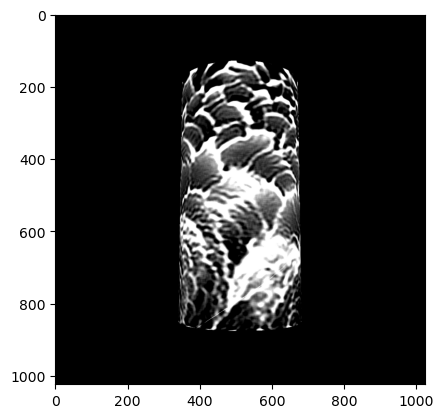

idx 64000 - img_loss: 0.44509658217430115, adv_loss 0.3497719466686249, grad norm 1.3456883430480957, lpips_loss 0
idx 64000 - img_loss: 0.44509658217430115, adv_loss 0.3497719466686249, grad norm 1.3456883430480957, lpips_loss 0
black swan: 72.2%
lampshade: 14.2%


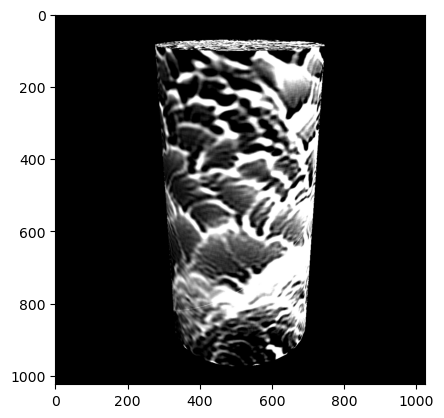

idx 65000 - img_loss: 0.35297849774360657, adv_loss 0.8280073404312134, grad norm 4.9488630294799805, lpips_loss 0


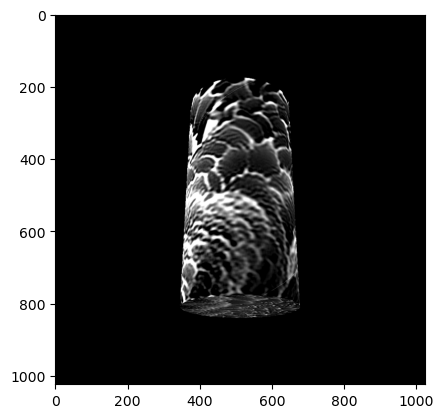

idx 66000 - img_loss: 0.3337261378765106, adv_loss 0.44953733682632446, grad norm 1.4057303667068481, lpips_loss 0
idx 66000 - img_loss: 0.3337261378765106, adv_loss 0.44953733682632446, grad norm 1.4057303667068481, lpips_loss 0
black swan: 65.9%
lampshade: 18.6%


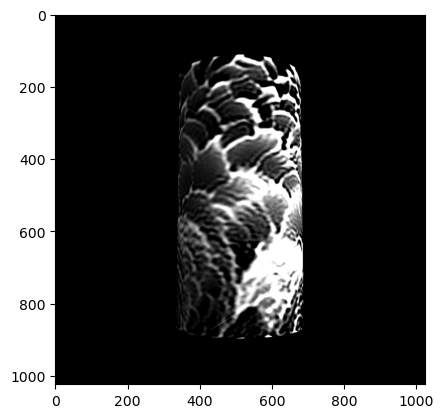

idx 67000 - img_loss: 0.3253733217716217, adv_loss 0.4713921546936035, grad norm 2.14076566696167, lpips_loss 0


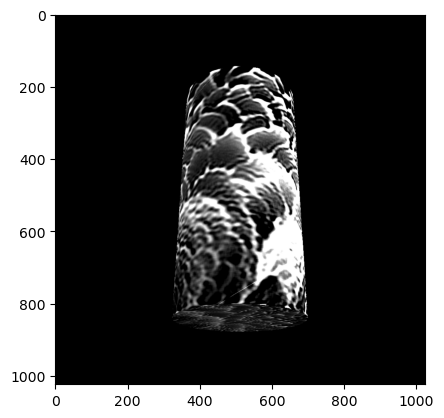

idx 68000 - img_loss: 0.3708169758319855, adv_loss 0.42078524827957153, grad norm 1.8983808755874634, lpips_loss 0
idx 68000 - img_loss: 0.3708169758319855, adv_loss 0.42078524827957153, grad norm 1.8983808755874634, lpips_loss 0
black swan: 64.6%
lampshade: 26.5%


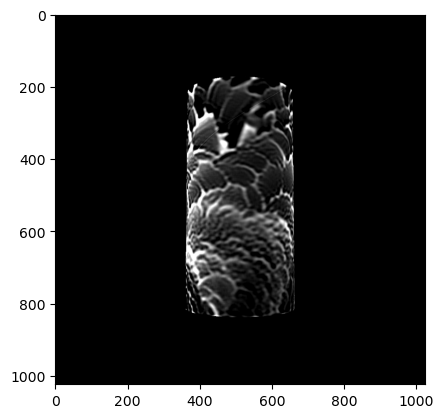

idx 69000 - img_loss: 0.2704686224460602, adv_loss 0.5636371374130249, grad norm 1.496273159980774, lpips_loss 0


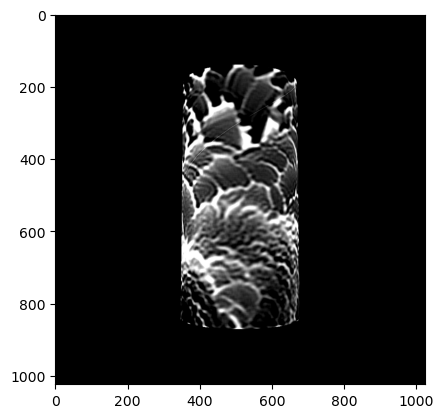

idx 70000 - img_loss: 0.38359877467155457, adv_loss 0.40597090125083923, grad norm 2.8907523155212402, lpips_loss 0
idx 70000 - img_loss: 0.38359877467155457, adv_loss 0.40597090125083923, grad norm 2.8907523155212402, lpips_loss 0
black swan: 66.6%
lighter: 16.0%


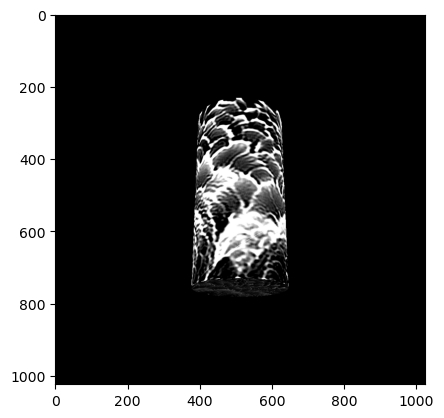

idx 71000 - img_loss: 0.4175718426704407, adv_loss 1.033399224281311, grad norm 11.906311988830566, lpips_loss 0


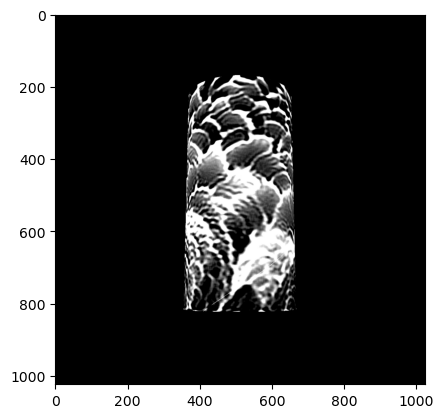

idx 72000 - img_loss: 0.432365357875824, adv_loss 0.4076835811138153, grad norm 2.00618052482605, lpips_loss 0
idx 72000 - img_loss: 0.432365357875824, adv_loss 0.4076835811138153, grad norm 2.00618052482605, lpips_loss 0
black swan: 72.5%
lampshade: 16.6%


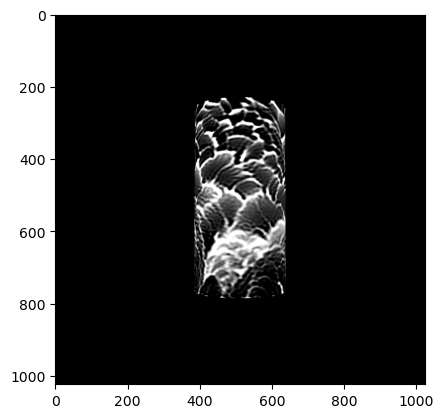

idx 73000 - img_loss: 0.4251321852207184, adv_loss 0.4003602862358093, grad norm 1.164516806602478, lpips_loss 0


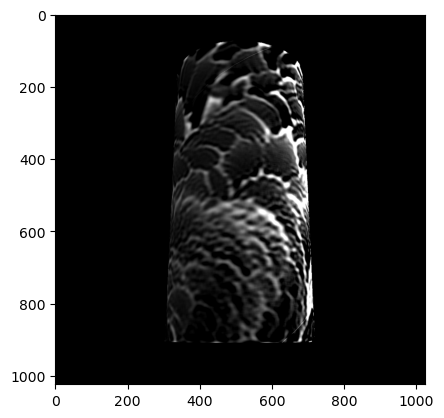

idx 74000 - img_loss: 0.25648167729377747, adv_loss 0.31101930141448975, grad norm 1.4906326532363892, lpips_loss 0
idx 74000 - img_loss: 0.25648167729377747, adv_loss 0.31101930141448975, grad norm 1.4906326532363892, lpips_loss 0
black swan: 72.2%
lampshade: 54.2%


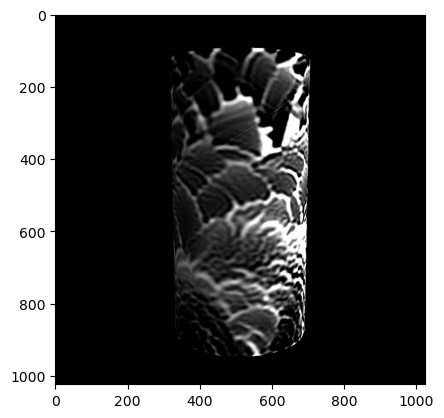

idx 75000 - img_loss: 0.28059402108192444, adv_loss 0.26122963428497314, grad norm 1.347001552581787, lpips_loss 0


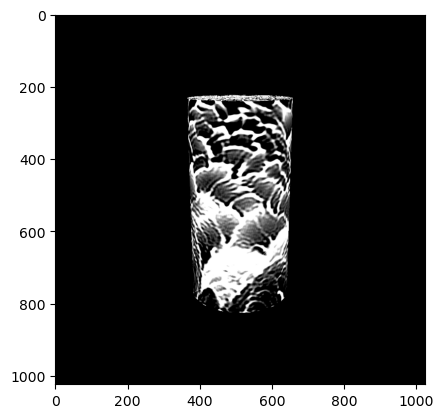

idx 76000 - img_loss: 0.3745269477367401, adv_loss 0.7376477122306824, grad norm 2.594848871231079, lpips_loss 0
idx 76000 - img_loss: 0.3745269477367401, adv_loss 0.7376477122306824, grad norm 2.594848871231079, lpips_loss 0
black swan: 61.5%
lampshade: 11.0%


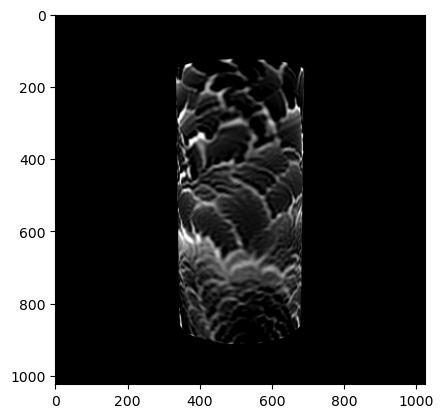

idx 77000 - img_loss: 0.20418758690357208, adv_loss 0.36719122529029846, grad norm 1.0689446926116943, lpips_loss 0
nan found in prediction


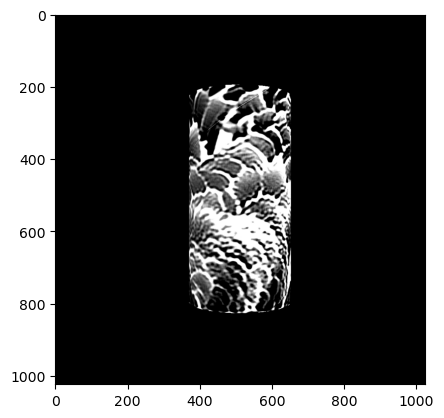

idx 78000 - img_loss: 0.377566933631897, adv_loss 0.5469655394554138, grad norm 3.1933352947235107, lpips_loss 0
idx 78000 - img_loss: 0.377566933631897, adv_loss 0.5469655394554138, grad norm 3.1933352947235107, lpips_loss 0
black swan: 69.2%
lampshade: 12.3%


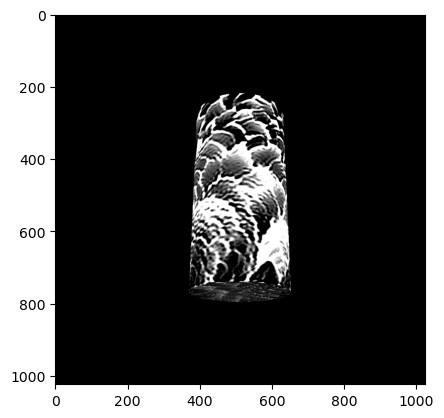

idx 79000 - img_loss: 0.3596005439758301, adv_loss 1.6101434230804443, grad norm 21.86609649658203, lpips_loss 0
nan found in prediction


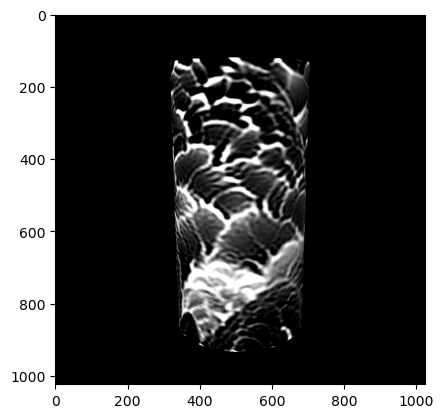

idx 80000 - img_loss: 0.3995387554168701, adv_loss 0.17593537271022797, grad norm 1.3136361837387085, lpips_loss 0
idx 80000 - img_loss: 0.3995387554168701, adv_loss 0.17593537271022797, grad norm 1.3136361837387085, lpips_loss 0
black swan: 83.9%
cup: 17.2%
nan found in prediction


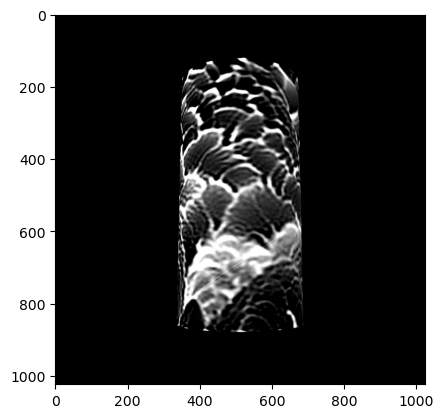

idx 81000 - img_loss: 0.4096846878528595, adv_loss 0.2727983593940735, grad norm 0.8606011867523193, lpips_loss 0


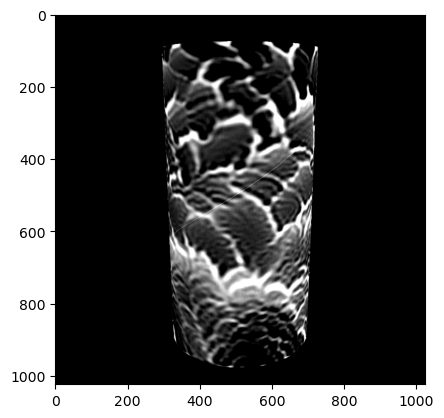

idx 82000 - img_loss: 0.3765384256839752, adv_loss 0.31221261620521545, grad norm 1.7449226379394531, lpips_loss 0
idx 82000 - img_loss: 0.3765384256839752, adv_loss 0.31221261620521545, grad norm 1.7449226379394531, lpips_loss 0
black swan: 81.8%
lampshade: 10.0%


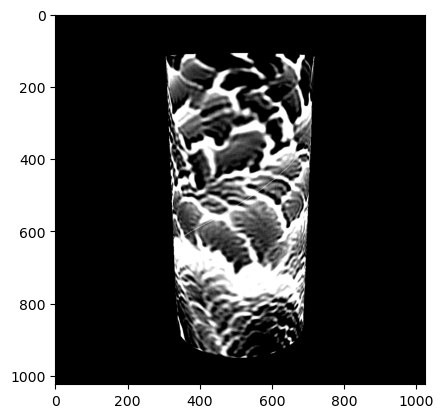

idx 83000 - img_loss: 0.44227126240730286, adv_loss 0.2996652126312256, grad norm 2.79054856300354, lpips_loss 0
nan found in prediction


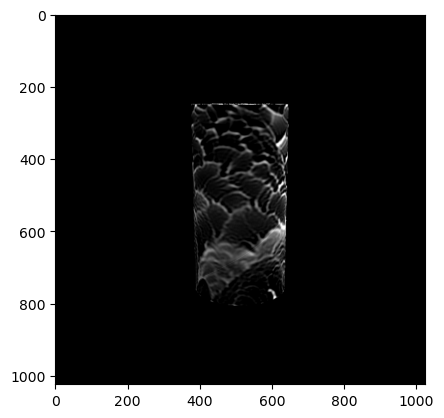

idx 84000 - img_loss: 0.16743512451648712, adv_loss 0.7795653939247131, grad norm 2.483217716217041, lpips_loss 0
idx 84000 - img_loss: 0.16743512451648712, adv_loss 0.7795653939247131, grad norm 2.483217716217041, lpips_loss 0
black swan: 70.7%
lampshade: 8.8%


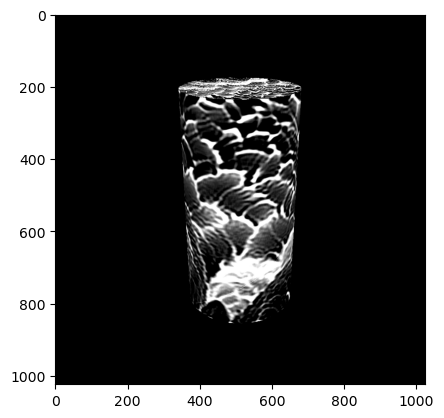

idx 85000 - img_loss: 0.45432570576667786, adv_loss 0.46049484610557556, grad norm 1.0323246717453003, lpips_loss 0
nan found in prediction


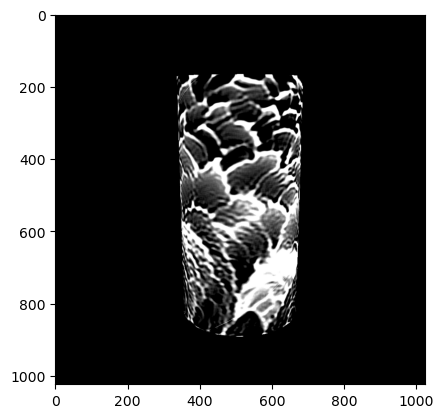

idx 86000 - img_loss: 0.4880129396915436, adv_loss 0.42051243782043457, grad norm 1.2830621004104614, lpips_loss 0
idx 86000 - img_loss: 0.4880129396915436, adv_loss 0.42051243782043457, grad norm 1.2830621004104614, lpips_loss 0
black swan: 84.6%
lampshade: 10.7%


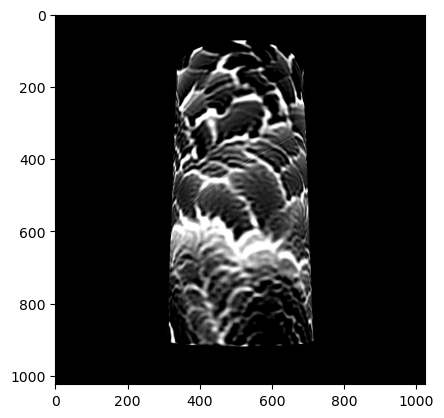

idx 87000 - img_loss: 0.3997025787830353, adv_loss 0.29770880937576294, grad norm 1.4412986040115356, lpips_loss 0


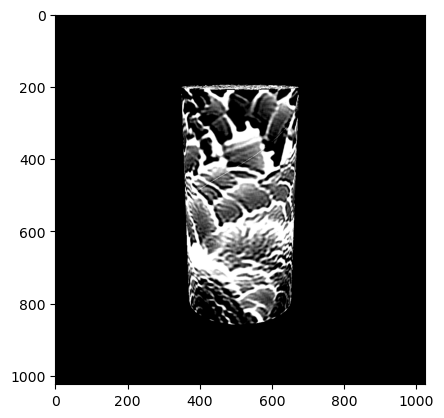

idx 88000 - img_loss: 0.3969203233718872, adv_loss 0.4224592447280884, grad norm 3.5451807975769043, lpips_loss 0
idx 88000 - img_loss: 0.3969203233718872, adv_loss 0.4224592447280884, grad norm 3.5451807975769043, lpips_loss 0
black swan: 65.5%
lampshade: 8.3%
nan found in prediction


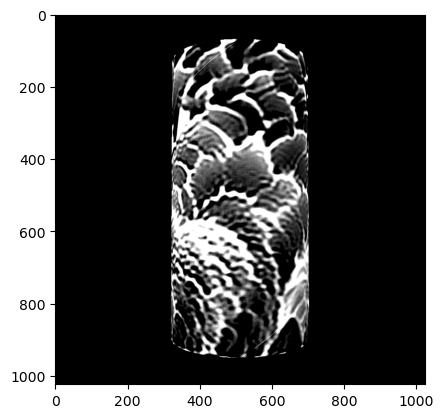

idx 89000 - img_loss: 0.45986703038215637, adv_loss 0.24770227074623108, grad norm 1.6098930835723877, lpips_loss 0


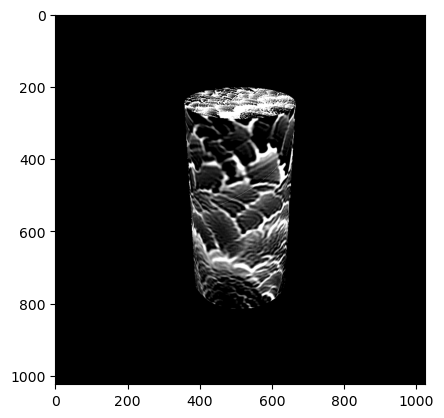

idx 90000 - img_loss: 0.37528344988822937, adv_loss 3.049759864807129, grad norm 18.05401039123535, lpips_loss 0
idx 90000 - img_loss: 0.37528344988822937, adv_loss 3.049759864807129, grad norm 18.05401039123535, lpips_loss 0
black swan: 30.2%
cup: 34.3%


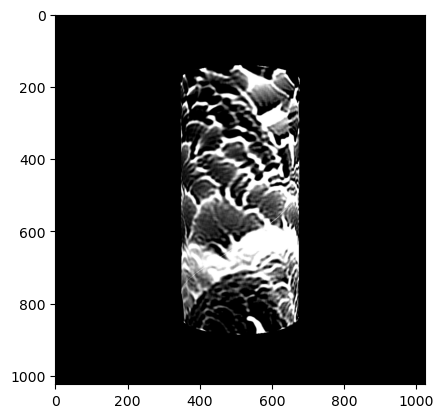

idx 91000 - img_loss: 0.41892382502555847, adv_loss 0.3623006045818329, grad norm 1.4264219999313354, lpips_loss 0


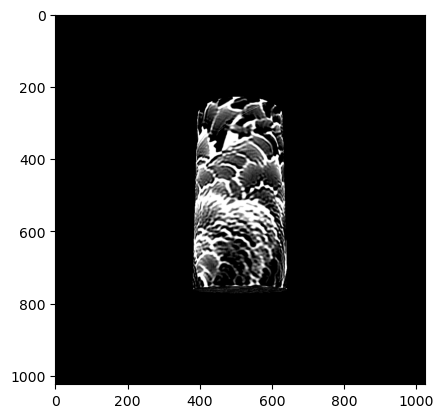

idx 92000 - img_loss: 0.4680785834789276, adv_loss 0.43124085664749146, grad norm 1.8956096172332764, lpips_loss 0
idx 92000 - img_loss: 0.4680785834789276, adv_loss 0.43124085664749146, grad norm 1.8956096172332764, lpips_loss 0
black swan: 65.0%
lampshade: 27.0%


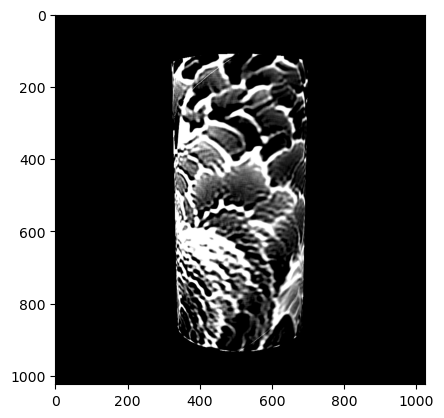

idx 93000 - img_loss: 0.432691365480423, adv_loss 0.30806103348731995, grad norm 1.472800612449646, lpips_loss 0


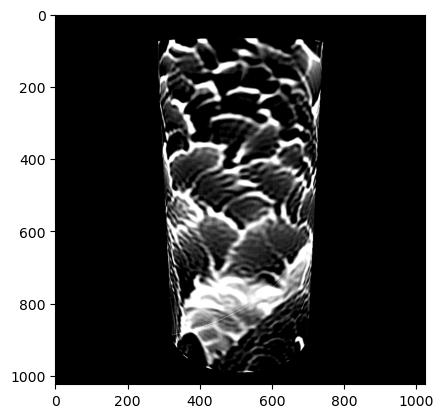

idx 94000 - img_loss: 0.46411222219467163, adv_loss 0.22225318849086761, grad norm 1.1459569931030273, lpips_loss 0
idx 94000 - img_loss: 0.46411222219467163, adv_loss 0.22225318849086761, grad norm 1.1459569931030273, lpips_loss 0
black swan: 84.6%
cup: 12.2%


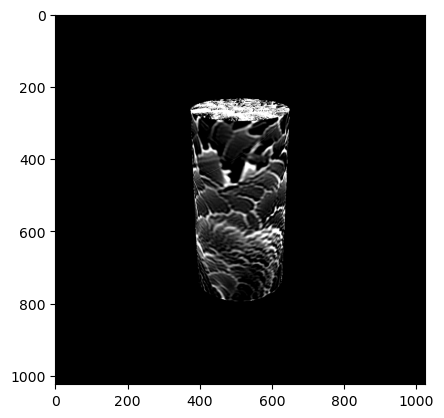

idx 95000 - img_loss: 0.30815330147743225, adv_loss 0.5002761483192444, grad norm 1.3136875629425049, lpips_loss 0
nan found in prediction


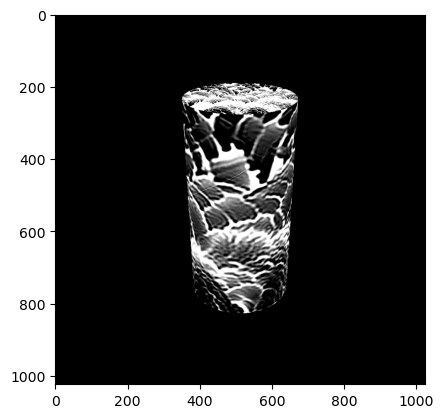

idx 96000 - img_loss: 0.4530622959136963, adv_loss 1.2803550958633423, grad norm 20.297304153442383, lpips_loss 0
idx 96000 - img_loss: 0.4530622959136963, adv_loss 1.2803550958633423, grad norm 20.297304153442383, lpips_loss 0
black swan: 27.8%
lampshade: 11.6%


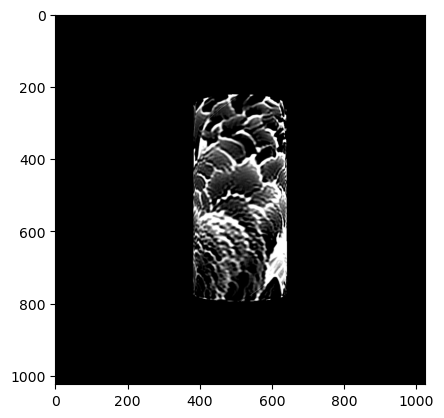

idx 97000 - img_loss: 0.5158551931381226, adv_loss 0.27691879868507385, grad norm 1.4944744110107422, lpips_loss 0


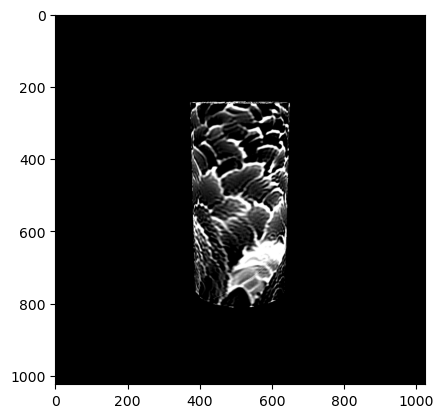

idx 98000 - img_loss: 0.4484812319278717, adv_loss 0.5817165970802307, grad norm 1.447009801864624, lpips_loss 0
idx 98000 - img_loss: 0.4484812319278717, adv_loss 0.5817165970802307, grad norm 1.447009801864624, lpips_loss 0
black swan: 67.6%
cup: 8.0%


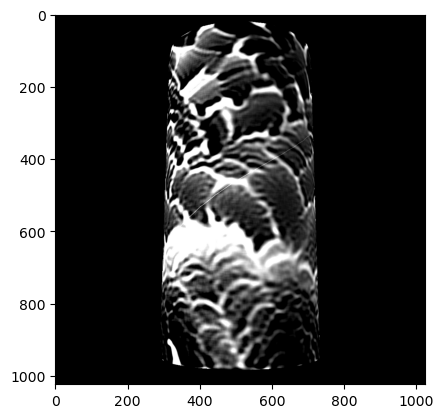

idx 99000 - img_loss: 0.41781526803970337, adv_loss 0.20729395747184753, grad norm 1.3392616510391235, lpips_loss 0


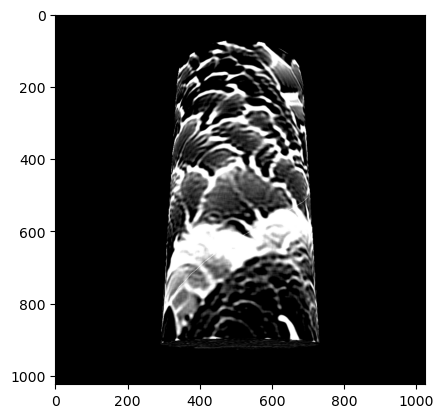

idx 100000 - img_loss: 0.46652182936668396, adv_loss 0.357433557510376, grad norm 2.8318943977355957, lpips_loss 0
idx 100000 - img_loss: 0.46652182936668396, adv_loss 0.357433557510376, grad norm 2.8318943977355957, lpips_loss 0
black swan: 87.8%
lampshade: 28.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpgggi29u2, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpd99kyna7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


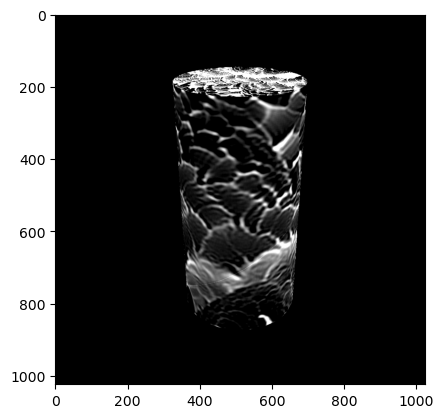

idx 101000 - img_loss: 0.26448947191238403, adv_loss 0.4812474250793457, grad norm 1.0969456434249878, lpips_loss 0
nan found in prediction


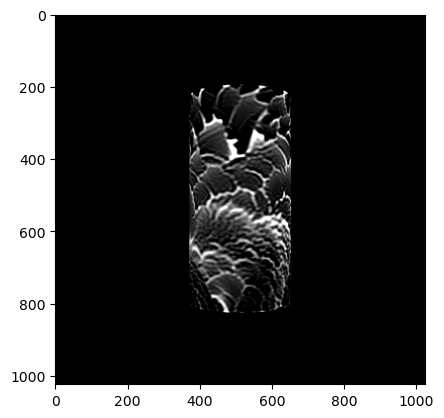

idx 102000 - img_loss: 0.35650956630706787, adv_loss 0.40586358308792114, grad norm 1.3614816665649414, lpips_loss 0
idx 102000 - img_loss: 0.35650956630706787, adv_loss 0.40586358308792114, grad norm 1.3614816665649414, lpips_loss 0
black swan: 69.2%
lampshade: 16.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpogqxjr14, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp96obdi2c, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


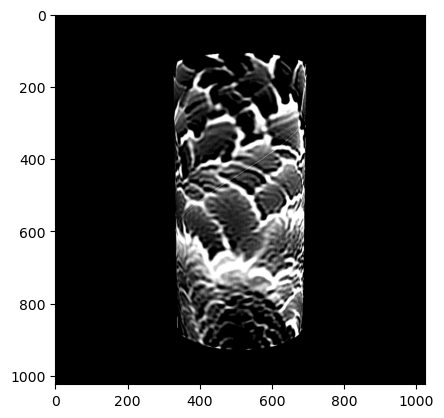

idx 103000 - img_loss: 0.46215978264808655, adv_loss 0.24688920378684998, grad norm 2.2245168685913086, lpips_loss 0


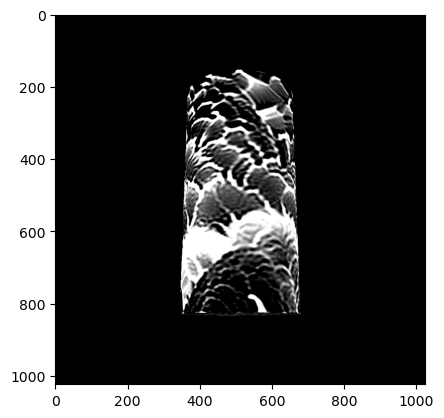

idx 104000 - img_loss: 0.4553207457065582, adv_loss 0.42579180002212524, grad norm 1.3854483366012573, lpips_loss 0
idx 104000 - img_loss: 0.4553207457065582, adv_loss 0.42579180002212524, grad norm 1.3854483366012573, lpips_loss 0
black swan: 79.4%
lampshade: 7.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpo16xn8r3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpm5wkhl10, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


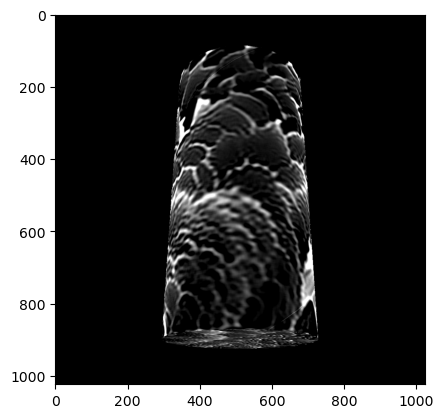

idx 105000 - img_loss: 0.30840569734573364, adv_loss 0.461762011051178, grad norm 3.0562312602996826, lpips_loss 0


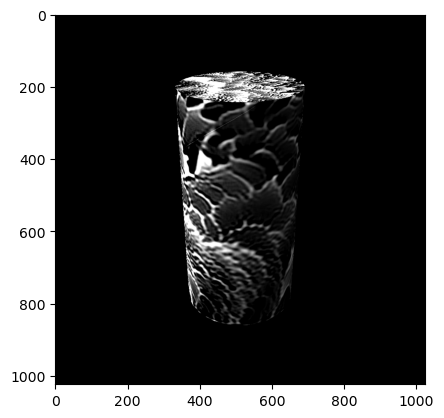

idx 106000 - img_loss: 0.2789158523082733, adv_loss 0.49290475249290466, grad norm 1.4716836214065552, lpips_loss 0
idx 106000 - img_loss: 0.2789158523082733, adv_loss 0.49290475249290466, grad norm 1.4716836214065552, lpips_loss 0
black swan: 63.5%
cup: 24.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3l8ye44c, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpmxaamx84, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


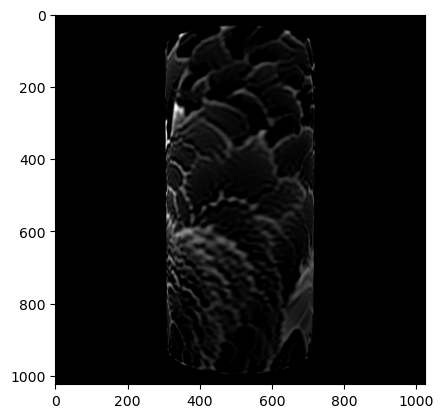

idx 107000 - img_loss: 0.11578232795000076, adv_loss 0.232025146484375, grad norm 1.3572245836257935, lpips_loss 0


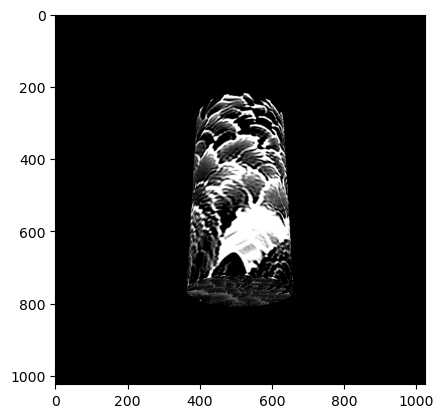

idx 108000 - img_loss: 0.3569755256175995, adv_loss 0.9905328750610352, grad norm 8.814499855041504, lpips_loss 0
idx 108000 - img_loss: 0.3569755256175995, adv_loss 0.9905328750610352, grad norm 8.814499855041504, lpips_loss 0
black swan: 62.9%
lampshade: 22.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpy31u_97q, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp6q40a84q, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


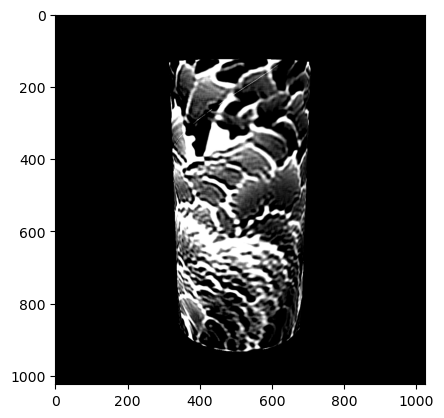

idx 109000 - img_loss: 0.4561573565006256, adv_loss 0.2966770827770233, grad norm 1.9789149761199951, lpips_loss 0


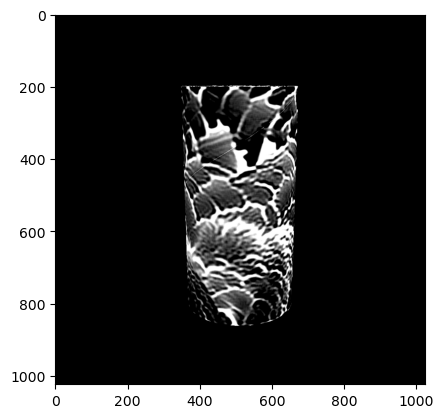

idx 110000 - img_loss: 0.49431997537612915, adv_loss 0.4905679523944855, grad norm 1.6042486429214478, lpips_loss 0
idx 110000 - img_loss: 0.49431997537612915, adv_loss 0.4905679523944855, grad norm 1.6042486429214478, lpips_loss 0
black swan: 63.6%
pedestal: 6.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp06irmyrn, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp4u1yiw9y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


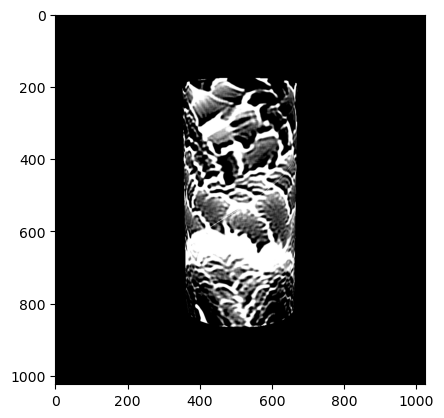

idx 111000 - img_loss: 0.36051106452941895, adv_loss 0.44284966588020325, grad norm 2.2500369548797607, lpips_loss 0


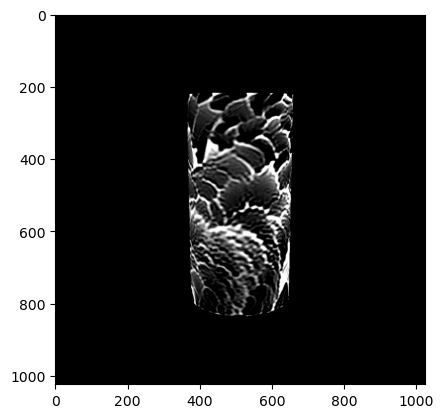

idx 112000 - img_loss: 0.4701686203479767, adv_loss 0.3819538950920105, grad norm 0.9077098965644836, lpips_loss 0
idx 112000 - img_loss: 0.4701686203479767, adv_loss 0.3819538950920105, grad norm 0.9077098965644836, lpips_loss 0
black swan: 67.3%
coffee mug: 10.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp0ilb7_f6, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpt8zjq1pb, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


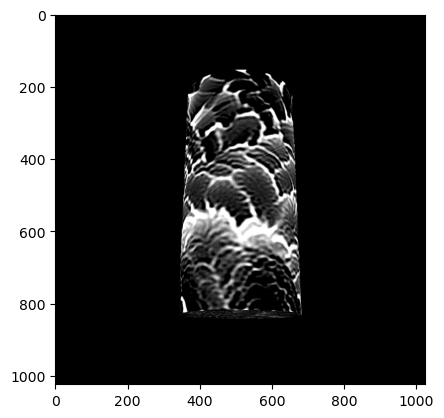

idx 113000 - img_loss: 0.4418657720088959, adv_loss 0.45149871706962585, grad norm 1.6645660400390625, lpips_loss 0


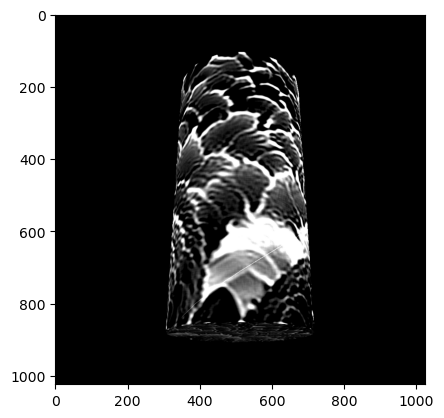

idx 114000 - img_loss: 0.44004932045936584, adv_loss 0.31496021151542664, grad norm 1.8937805891036987, lpips_loss 0
idx 114000 - img_loss: 0.44004932045936584, adv_loss 0.31496021151542664, grad norm 1.8937805891036987, lpips_loss 0
black swan: 78.9%
lampshade: 36.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpxybyrd30, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpvcuy4qii, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


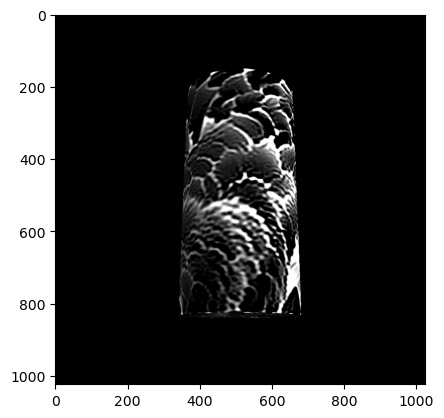

idx 115000 - img_loss: 0.4234074652194977, adv_loss 0.3401464819908142, grad norm 1.5173571109771729, lpips_loss 0


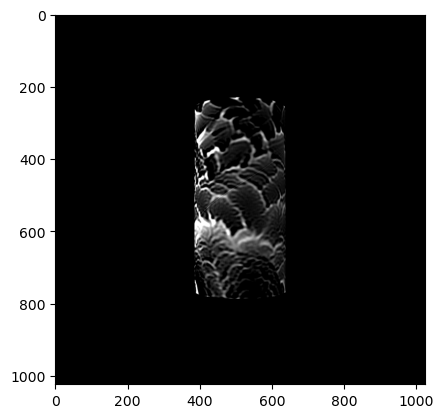

idx 116000 - img_loss: 0.2644549310207367, adv_loss 0.48588043451309204, grad norm 0.6608715653419495, lpips_loss 0
idx 116000 - img_loss: 0.2644549310207367, adv_loss 0.48588043451309204, grad norm 0.6608715653419495, lpips_loss 0
black swan: 71.9%
lampshade: 17.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_9wkdkdg, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpf4mrcrem, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


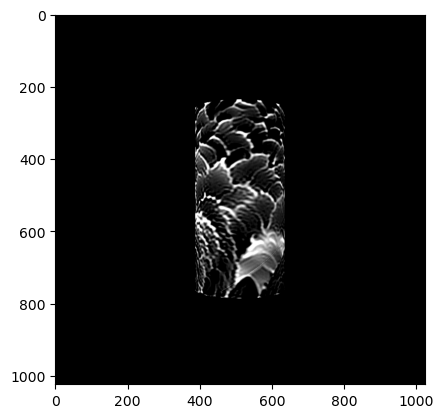

idx 117000 - img_loss: 0.40150195360183716, adv_loss 0.42552122473716736, grad norm 1.7119333744049072, lpips_loss 0


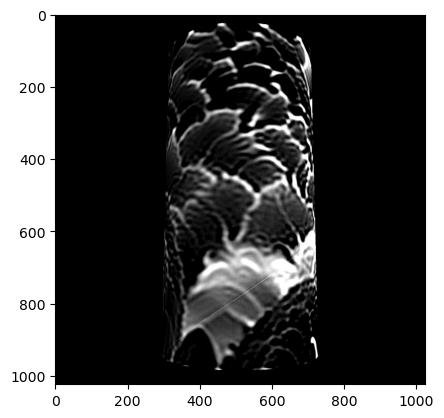

idx 118000 - img_loss: 0.3282940983772278, adv_loss 0.5381470322608948, grad norm 6.4407877922058105, lpips_loss 0
idx 118000 - img_loss: 0.3282940983772278, adv_loss 0.5381470322608948, grad norm 6.4407877922058105, lpips_loss 0
black swan: 89.1%
lampshade: 39.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpllcfq57z, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpke46dyyw, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


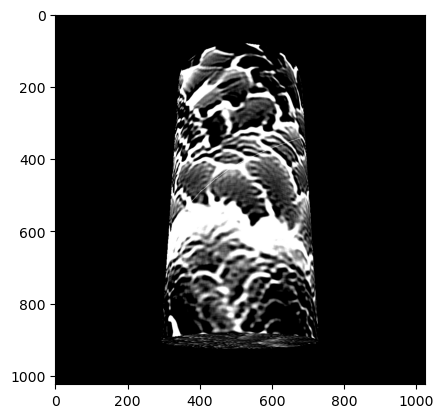

idx 119000 - img_loss: 0.4247680902481079, adv_loss 0.2475271224975586, grad norm 1.8900175094604492, lpips_loss 0


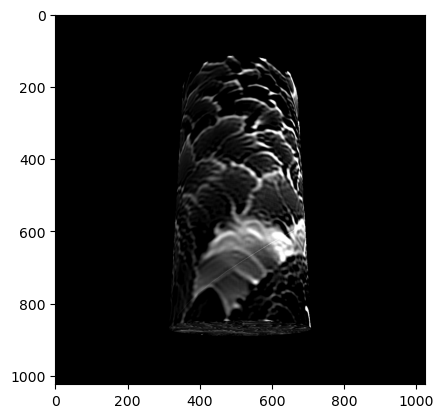

idx 120000 - img_loss: 0.24497488141059875, adv_loss 0.34005433320999146, grad norm 1.6646993160247803, lpips_loss 0
idx 120000 - img_loss: 0.24497488141059875, adv_loss 0.34005433320999146, grad norm 1.6646993160247803, lpips_loss 0
black swan: 88.0%
lampshade: 45.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpuhlzurv2, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpk5qxbg02, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


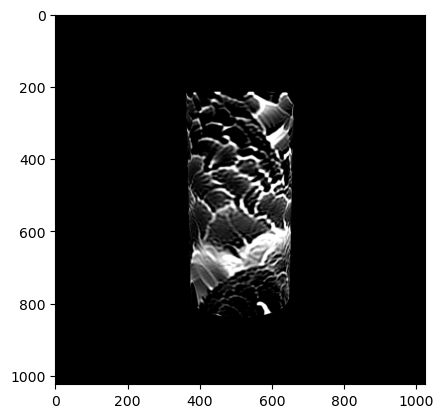

idx 121000 - img_loss: 0.418858140707016, adv_loss 0.32532814145088196, grad norm 0.8706923723220825, lpips_loss 0


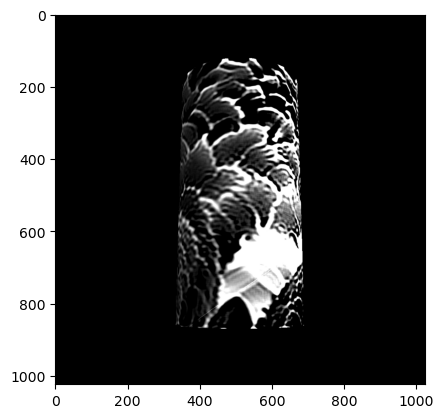

idx 122000 - img_loss: 0.35565268993377686, adv_loss 0.11482778936624527, grad norm 0.8622862100601196, lpips_loss 0
idx 122000 - img_loss: 0.35565268993377686, adv_loss 0.11482778936624527, grad norm 0.8622862100601196, lpips_loss 0
black swan: 78.5%
lampshade: 39.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8kp69b2v, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpkuc8ife7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


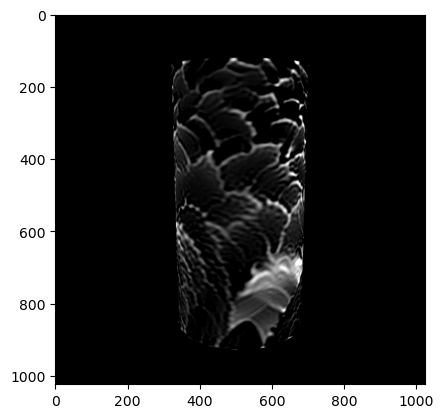

idx 123000 - img_loss: 0.20109453797340393, adv_loss 0.18294209241867065, grad norm 0.7816826701164246, lpips_loss 0


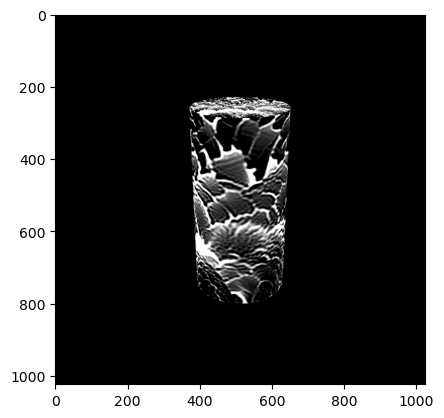

idx 124000 - img_loss: 0.4540455937385559, adv_loss 0.7778568863868713, grad norm 2.7751224040985107, lpips_loss 0
idx 124000 - img_loss: 0.4540455937385559, adv_loss 0.7778568863868713, grad norm 2.7751224040985107, lpips_loss 0
black swan: 66.1%
coffee mug: 17.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmptb_chxzz, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmppglnzkq3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


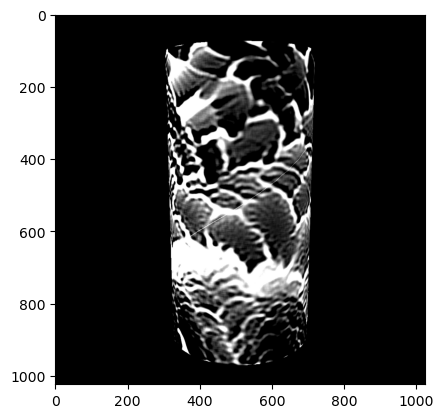

idx 125000 - img_loss: 0.4703783690929413, adv_loss 0.2176416665315628, grad norm 1.4271150827407837, lpips_loss 0


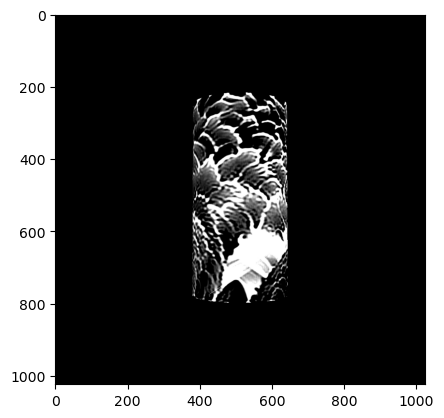

idx 126000 - img_loss: 0.41237974166870117, adv_loss 0.3524535298347473, grad norm 1.4741984605789185, lpips_loss 0
idx 126000 - img_loss: 0.41237974166870117, adv_loss 0.3524535298347473, grad norm 1.4741984605789185, lpips_loss 0
black swan: 71.7%
lampshade: 16.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp95ag_w8e, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpyohoysg1, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


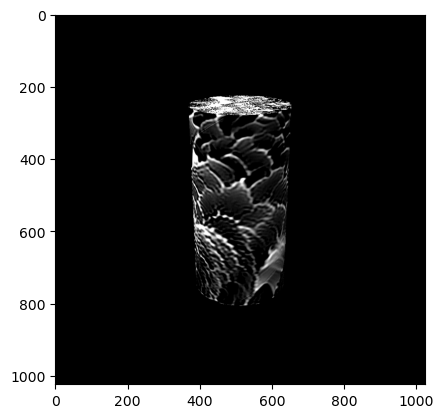

idx 127000 - img_loss: 0.3177841603755951, adv_loss 0.6217491030693054, grad norm 2.986743927001953, lpips_loss 0


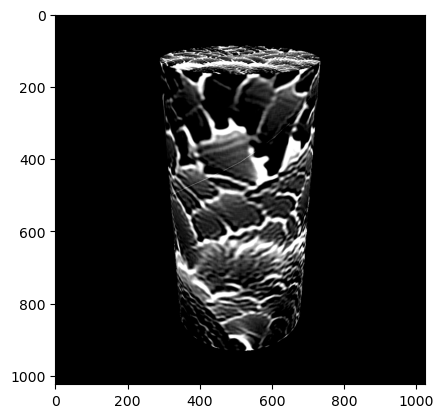

idx 128000 - img_loss: 0.47065672278404236, adv_loss 0.5671555399894714, grad norm 6.99390172958374, lpips_loss 0
idx 128000 - img_loss: 0.47065672278404236, adv_loss 0.5671555399894714, grad norm 6.99390172958374, lpips_loss 0
black swan: 45.7%
cup: 25.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpeibkl6wn, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpqfokgals, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


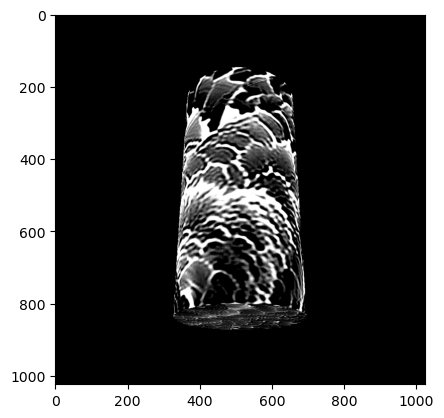

idx 129000 - img_loss: 0.45222562551498413, adv_loss 0.35136187076568604, grad norm 1.7757800817489624, lpips_loss 0


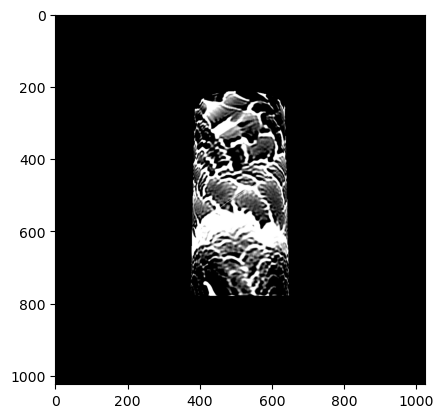

idx 130000 - img_loss: 0.3847436308860779, adv_loss 0.6270666122436523, grad norm 6.476877212524414, lpips_loss 0
idx 130000 - img_loss: 0.3847436308860779, adv_loss 0.6270666122436523, grad norm 6.476877212524414, lpips_loss 0
black swan: 70.1%
lampshade: 12.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpfh585anc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpp02wm9km, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


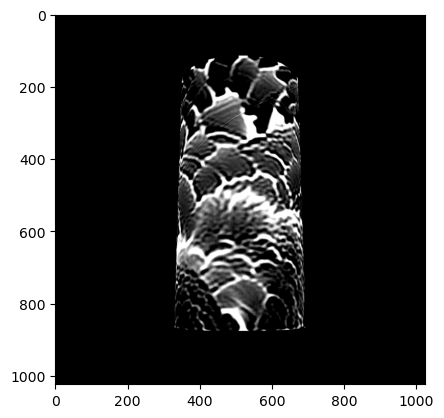

idx 131000 - img_loss: 0.5250874757766724, adv_loss 0.22478120028972626, grad norm 1.3777035474777222, lpips_loss 0
nan found in prediction


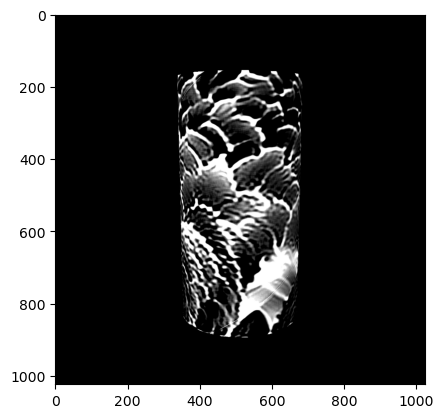

idx 132000 - img_loss: 0.4594346880912781, adv_loss 0.6167660355567932, grad norm 4.4889655113220215, lpips_loss 0
idx 132000 - img_loss: 0.4594346880912781, adv_loss 0.6167660355567932, grad norm 4.4889655113220215, lpips_loss 0
black swan: 76.8%
lampshade: 9.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpd9klnjbc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpcdygahdu, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


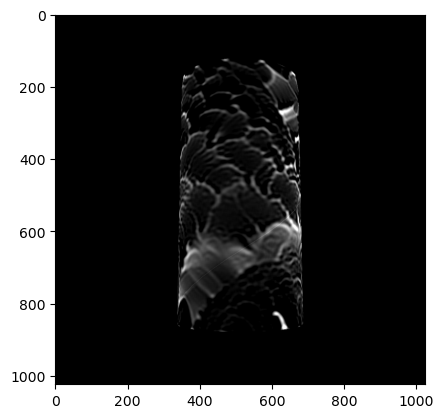

idx 133000 - img_loss: 0.16227328777313232, adv_loss 0.2584041655063629, grad norm 0.8987333178520203, lpips_loss 0


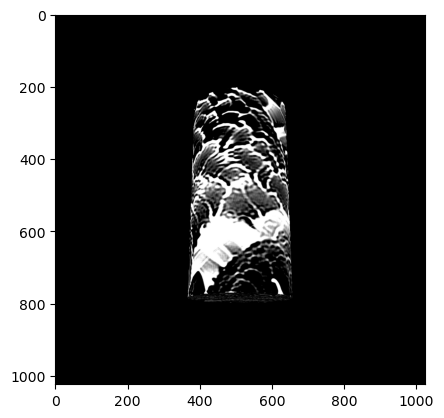

idx 134000 - img_loss: 0.38418179750442505, adv_loss 0.42980846762657166, grad norm 1.7746671438217163, lpips_loss 0
idx 134000 - img_loss: 0.38418179750442505, adv_loss 0.42980846762657166, grad norm 1.7746671438217163, lpips_loss 0
black swan: 73.9%
lampshade: 32.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmprf431ihd, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3pqdxly1, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


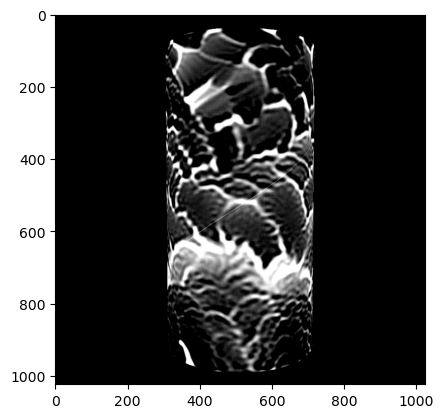

idx 135000 - img_loss: 0.47477248311042786, adv_loss 0.13117776811122894, grad norm 2.0015172958374023, lpips_loss 0


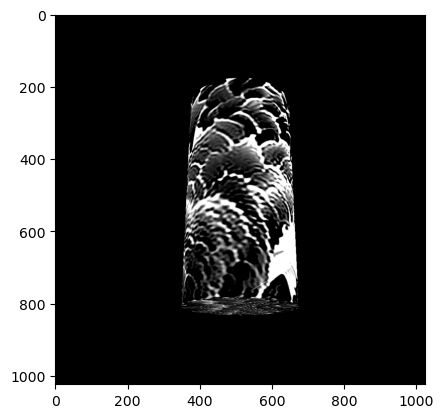

idx 136000 - img_loss: 0.46652352809906006, adv_loss 0.26881879568099976, grad norm 1.1003704071044922, lpips_loss 0
idx 136000 - img_loss: 0.46652352809906006, adv_loss 0.26881879568099976, grad norm 1.1003704071044922, lpips_loss 0
black swan: 69.0%
lampshade: 18.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpe0y93541, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpu8etgudi, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


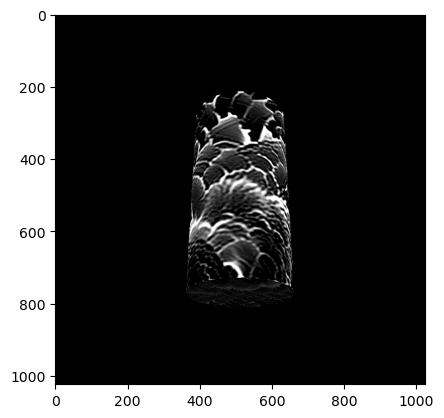

idx 137000 - img_loss: 0.38465940952301025, adv_loss 0.7145427465438843, grad norm 3.422950267791748, lpips_loss 0


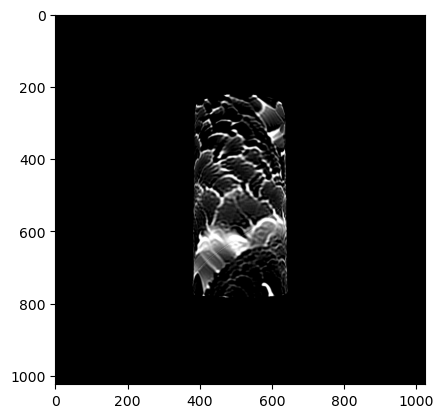

idx 138000 - img_loss: 0.357324481010437, adv_loss 0.3700968027114868, grad norm 1.209679126739502, lpips_loss 0
idx 138000 - img_loss: 0.357324481010437, adv_loss 0.3700968027114868, grad norm 1.209679126739502, lpips_loss 0
black swan: 81.1%
lampshade: 20.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpcpesi0cy, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpw4gdll8q, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


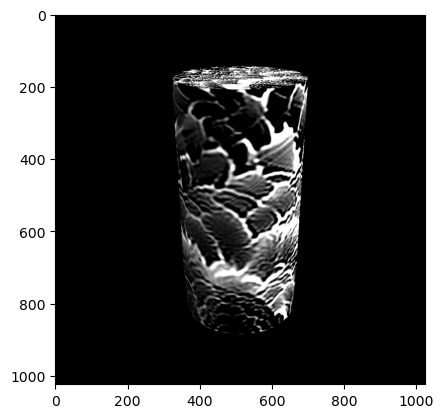

idx 139000 - img_loss: 0.3836800754070282, adv_loss 0.7050151824951172, grad norm 3.2970449924468994, lpips_loss 0


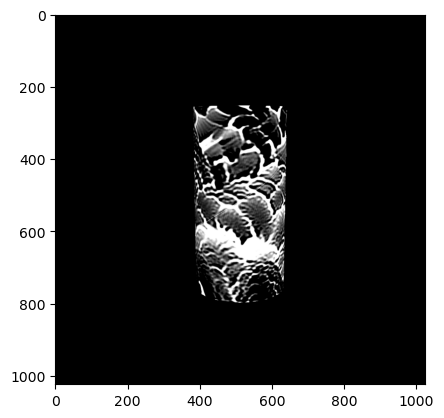

idx 140000 - img_loss: 0.4455821216106415, adv_loss 0.4384341537952423, grad norm 1.3388530015945435, lpips_loss 0
idx 140000 - img_loss: 0.4455821216106415, adv_loss 0.4384341537952423, grad norm 1.3388530015945435, lpips_loss 0
black swan: 72.0%
lampshade: 8.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp7bel5ded, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp7m3fvqvk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


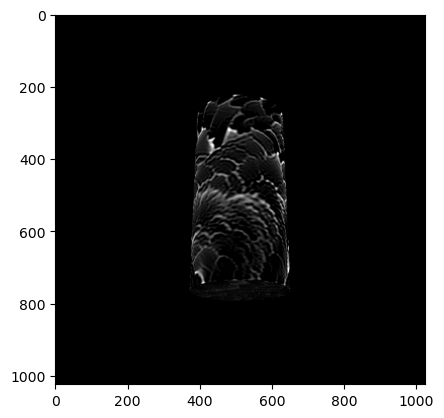

idx 141000 - img_loss: 0.19306981563568115, adv_loss 0.6859314441680908, grad norm 1.9321460723876953, lpips_loss 0


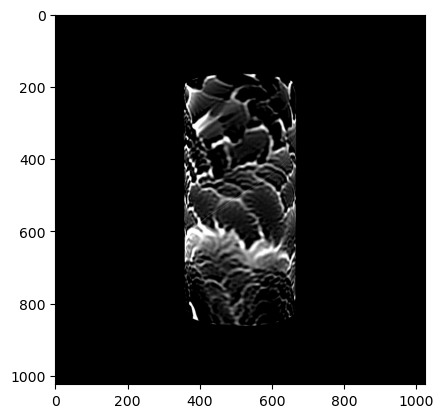

idx 142000 - img_loss: 0.3481738567352295, adv_loss 0.3497130572795868, grad norm 1.1411570310592651, lpips_loss 0
idx 142000 - img_loss: 0.3481738567352295, adv_loss 0.3497130572795868, grad norm 1.1411570310592651, lpips_loss 0
black swan: 77.3%
lighter: 10.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpzohfy3vz, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpevdlhfuk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


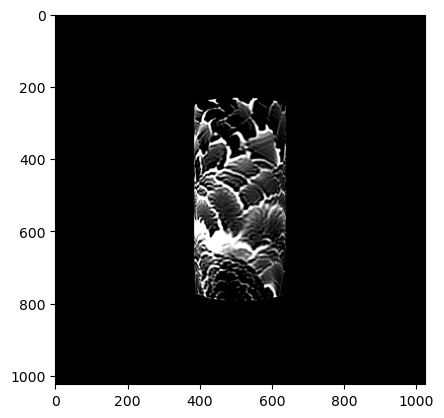

idx 143000 - img_loss: 0.452329158782959, adv_loss 0.5450631380081177, grad norm 2.0383825302124023, lpips_loss 0


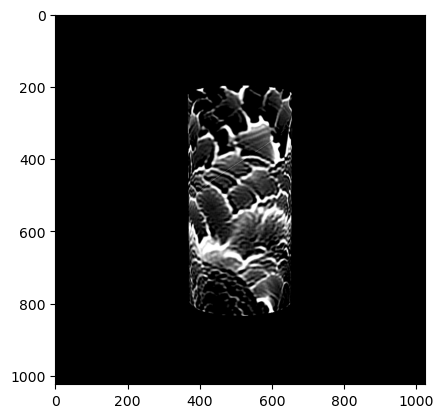

idx 144000 - img_loss: 0.4915781021118164, adv_loss 0.42451292276382446, grad norm 1.262549638748169, lpips_loss 0
idx 144000 - img_loss: 0.4915781021118164, adv_loss 0.42451292276382446, grad norm 1.262549638748169, lpips_loss 0
black swan: 73.3%
lampshade: 14.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpf7av_6xu, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpi3er_gpj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


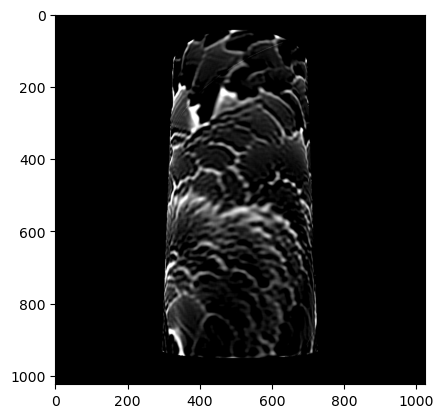

idx 145000 - img_loss: 0.2889006435871124, adv_loss 0.19480904936790466, grad norm 1.073317050933838, lpips_loss 0


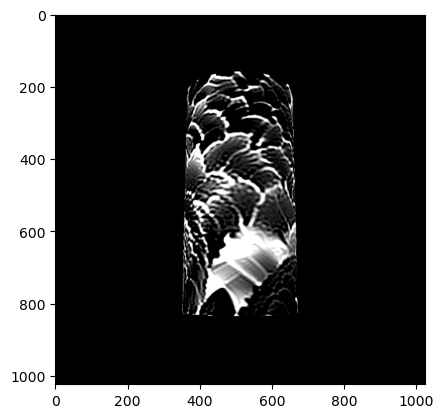

idx 146000 - img_loss: 0.45287999510765076, adv_loss 0.2647191286087036, grad norm 1.025080919265747, lpips_loss 0
idx 146000 - img_loss: 0.45287999510765076, adv_loss 0.2647191286087036, grad norm 1.025080919265747, lpips_loss 0
black swan: 88.6%
table lamp: 17.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp18f9d0i0, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1_fwjiu9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


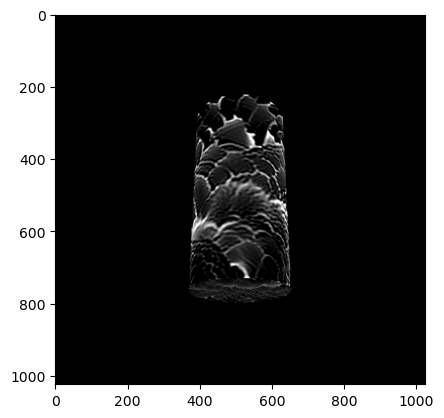

idx 147000 - img_loss: 0.27086082100868225, adv_loss 0.9516828060150146, grad norm 2.534761667251587, lpips_loss 0


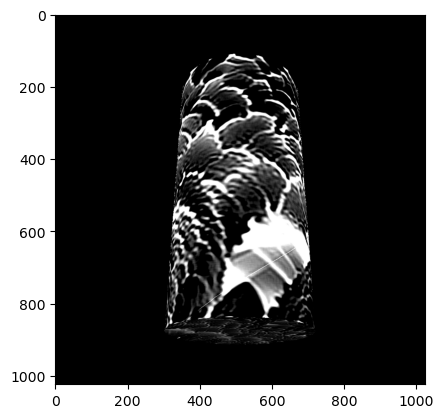

idx 148000 - img_loss: 0.47340014576911926, adv_loss 0.22888067364692688, grad norm 2.5927603244781494, lpips_loss 0
idx 148000 - img_loss: 0.47340014576911926, adv_loss 0.22888067364692688, grad norm 2.5927603244781494, lpips_loss 0
black swan: 85.3%
lampshade: 27.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp83kw27ph, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpahj55owb, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


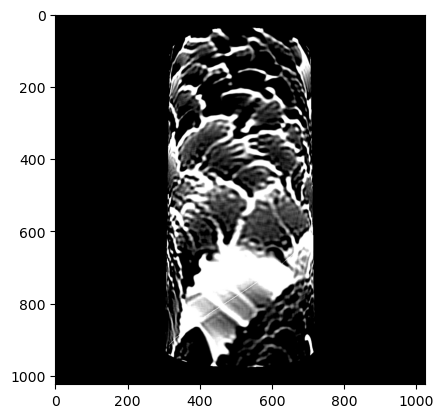

idx 149000 - img_loss: 0.4425711929798126, adv_loss 0.07450345903635025, grad norm 1.2358115911483765, lpips_loss 0


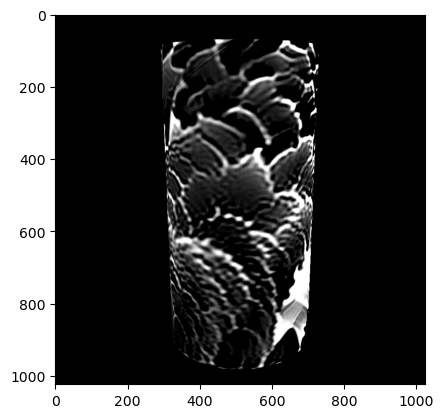

idx 150000 - img_loss: 0.4040818512439728, adv_loss 0.17896629869937897, grad norm 1.1233879327774048, lpips_loss 0
idx 150000 - img_loss: 0.4040818512439728, adv_loss 0.17896629869937897, grad norm 1.1233879327774048, lpips_loss 0
black swan: 89.9%
cup: 18.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpoz9rp979, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8mk6pakm, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


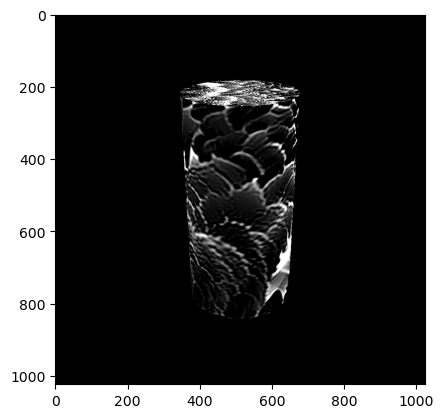

idx 151000 - img_loss: 0.29078006744384766, adv_loss 0.6288958191871643, grad norm 0.6900609135627747, lpips_loss 0


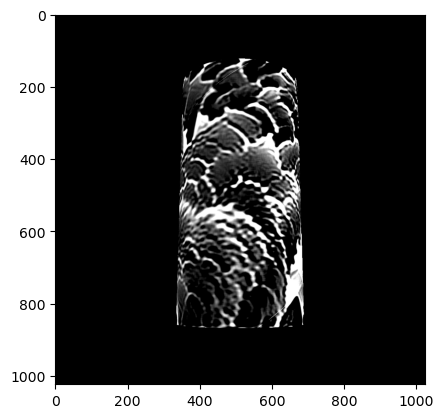

idx 152000 - img_loss: 0.5131561756134033, adv_loss 0.21378305554389954, grad norm 0.8984314203262329, lpips_loss 0
idx 152000 - img_loss: 0.5131561756134033, adv_loss 0.21378305554389954, grad norm 0.8984314203262329, lpips_loss 0
black swan: 76.6%
lampshade: 37.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp4hw_5pg8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3g_evtec, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


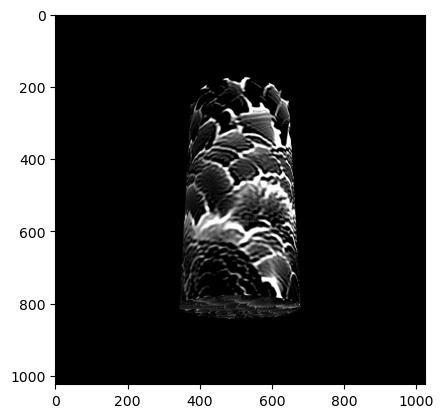

idx 153000 - img_loss: 0.4286629855632782, adv_loss 0.37045761942863464, grad norm 1.4289560317993164, lpips_loss 0


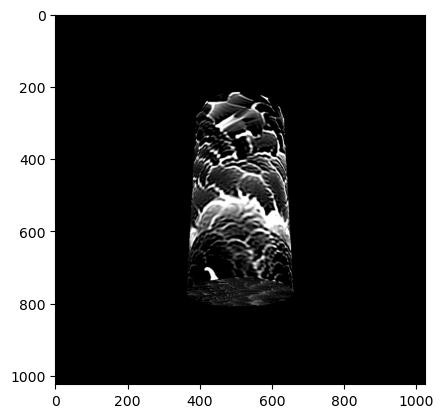

idx 154000 - img_loss: 0.44127050042152405, adv_loss 0.6212490200996399, grad norm 5.078808784484863, lpips_loss 0
idx 154000 - img_loss: 0.44127050042152405, adv_loss 0.6212490200996399, grad norm 5.078808784484863, lpips_loss 0
black swan: 66.1%
lampshade: 24.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpe49dlkae, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpltv9frrz, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


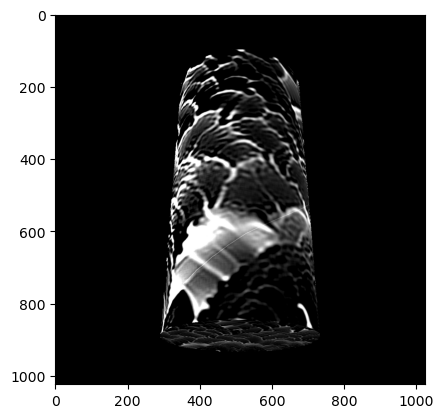

idx 155000 - img_loss: 0.31373581290245056, adv_loss 0.17335602641105652, grad norm 1.4090255498886108, lpips_loss 0


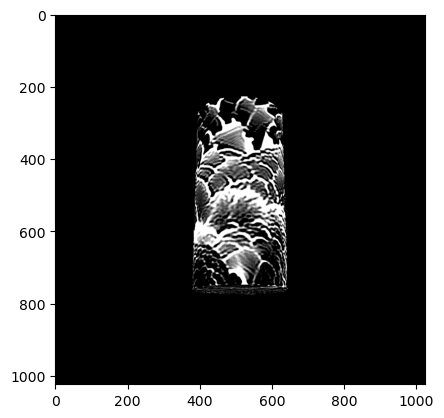

idx 156000 - img_loss: 0.41416242718696594, adv_loss 0.8440786004066467, grad norm 7.099093914031982, lpips_loss 0
idx 156000 - img_loss: 0.41416242718696594, adv_loss 0.8440786004066467, grad norm 7.099093914031982, lpips_loss 0
black swan: 68.2%
lampshade: 28.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp0gqgj7qh, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpx2xw8ety, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


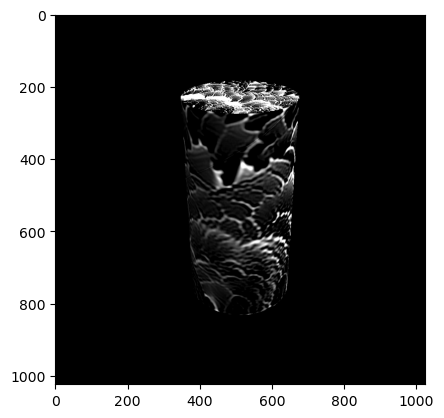

idx 157000 - img_loss: 0.2659246027469635, adv_loss 0.4627305865287781, grad norm 1.755780577659607, lpips_loss 0
nan found in prediction


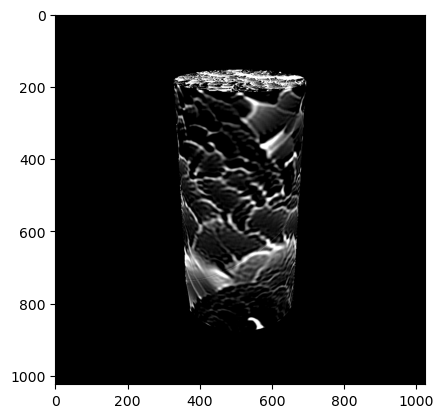

idx 158000 - img_loss: 0.28634506464004517, adv_loss 0.8759127259254456, grad norm 5.647454738616943, lpips_loss 0
idx 158000 - img_loss: 0.28634506464004517, adv_loss 0.8759127259254456, grad norm 5.647454738616943, lpips_loss 0
black swan: 75.3%
cup: 19.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpngg50fm9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpy67x7oak, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


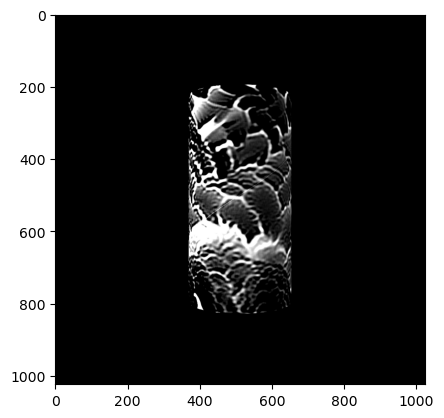

idx 159000 - img_loss: 0.4270746409893036, adv_loss 0.5140233039855957, grad norm 2.5718483924865723, lpips_loss 0
nan found in prediction


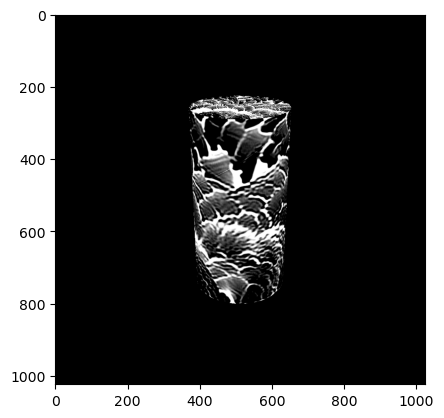

idx 160000 - img_loss: 0.49117177724838257, adv_loss 0.6954902410507202, grad norm 1.6680325269699097, lpips_loss 0
idx 160000 - img_loss: 0.49117177724838257, adv_loss 0.6954902410507202, grad norm 1.6680325269699097, lpips_loss 0
black swan: 67.4%
beaker: 13.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpzh3mg0mg, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpslswpoy2, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


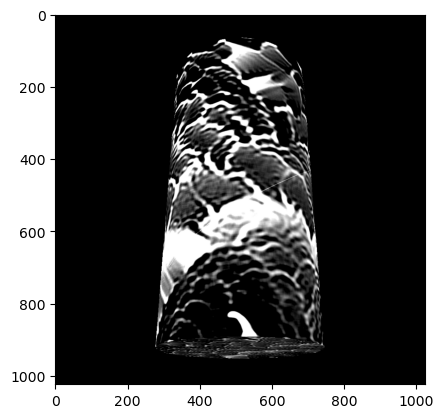

idx 161000 - img_loss: 0.4402614235877991, adv_loss 0.7071974277496338, grad norm 13.725997924804688, lpips_loss 0


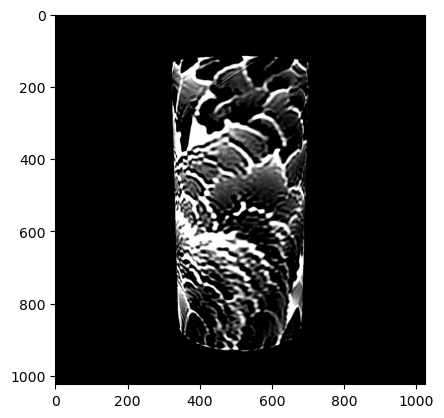

idx 162000 - img_loss: 0.4865109622478485, adv_loss 0.19694426655769348, grad norm 1.1925485134124756, lpips_loss 0
idx 162000 - img_loss: 0.4865109622478485, adv_loss 0.19694426655769348, grad norm 1.1925485134124756, lpips_loss 0
black swan: 83.0%
coffee mug: 6.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpr12cd3sh, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmptydhjj22, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


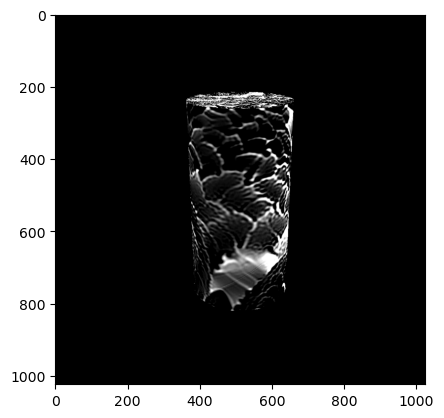

idx 163000 - img_loss: 0.30366799235343933, adv_loss 0.5016336441040039, grad norm 2.020871877670288, lpips_loss 0
nan found in prediction


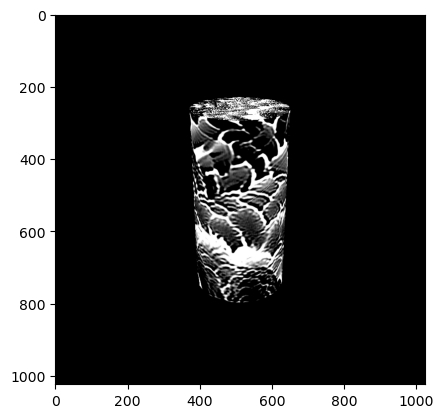

idx 164000 - img_loss: 0.44505468010902405, adv_loss 2.208101987838745, grad norm 27.026920318603516, lpips_loss 0
idx 164000 - img_loss: 0.44505468010902405, adv_loss 2.208101987838745, grad norm 27.026920318603516, lpips_loss 0
black swan: 46.7%
beaker: 14.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpb86e_wo0, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpeh1cfoan, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


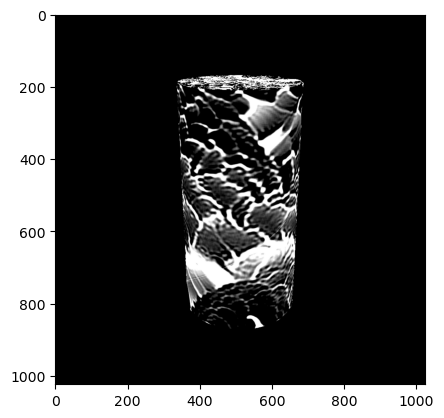

idx 165000 - img_loss: 0.4710317552089691, adv_loss 0.501567542552948, grad norm 2.3615081310272217, lpips_loss 0


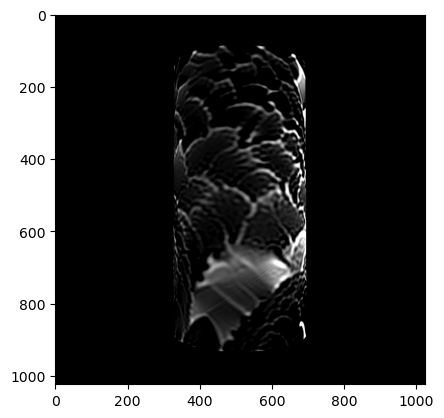

idx 166000 - img_loss: 0.20016980171203613, adv_loss 0.2548239529132843, grad norm 1.108170509338379, lpips_loss 0
idx 166000 - img_loss: 0.20016980171203613, adv_loss 0.2548239529132843, grad norm 1.108170509338379, lpips_loss 0
black swan: 93.6%
lampshade: 9.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpavfjmn4o, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpebbumee8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


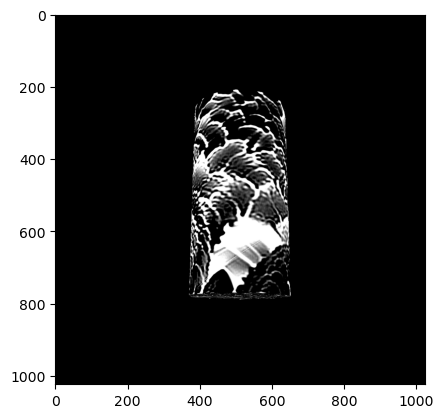

idx 167000 - img_loss: 0.40187060832977295, adv_loss 0.38010042905807495, grad norm 1.2522733211517334, lpips_loss 0


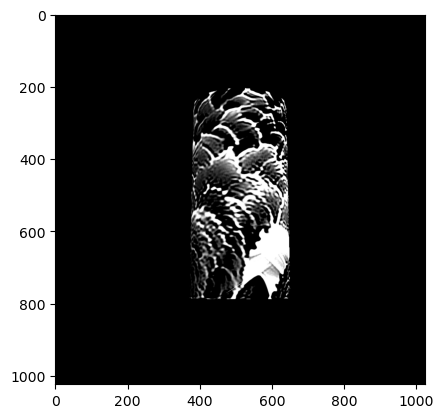

idx 168000 - img_loss: 0.4079858064651489, adv_loss 0.2481219470500946, grad norm 0.9736368656158447, lpips_loss 0
idx 168000 - img_loss: 0.4079858064651489, adv_loss 0.2481219470500946, grad norm 0.9736368656158447, lpips_loss 0
black swan: 76.1%
table lamp: 15.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpge1_eqlk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphykpbes8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


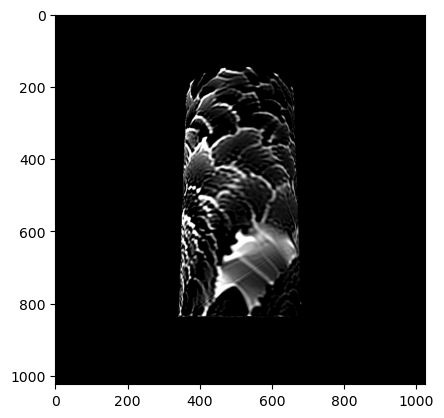

idx 169000 - img_loss: 0.3451077938079834, adv_loss 0.2037726491689682, grad norm 0.7669510245323181, lpips_loss 0


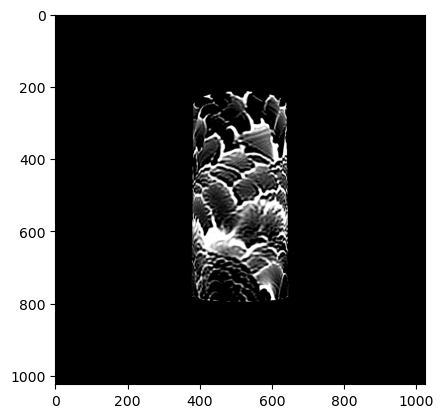

idx 170000 - img_loss: 0.5364872217178345, adv_loss 0.44085076451301575, grad norm 1.443245530128479, lpips_loss 0
idx 170000 - img_loss: 0.5364872217178345, adv_loss 0.44085076451301575, grad norm 1.443245530128479, lpips_loss 0
black swan: 72.8%
lampshade: 19.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_f69msvc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpxtwom2le, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


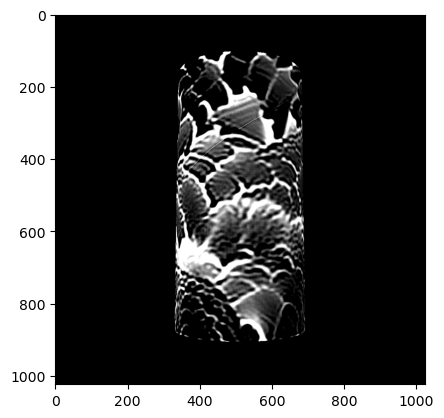

idx 171000 - img_loss: 0.4904892146587372, adv_loss 0.18898411095142365, grad norm 1.5297147035598755, lpips_loss 0


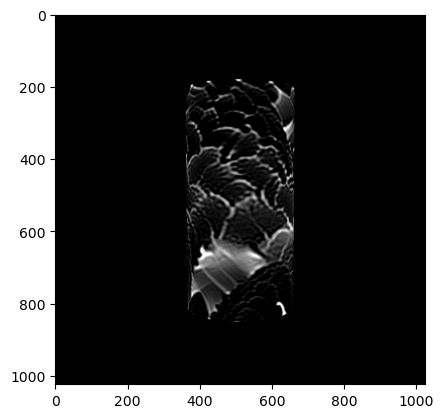

idx 172000 - img_loss: 0.2179284691810608, adv_loss 0.33676090836524963, grad norm 0.9216112494468689, lpips_loss 0
idx 172000 - img_loss: 0.2179284691810608, adv_loss 0.33676090836524963, grad norm 0.9216112494468689, lpips_loss 0
black swan: 80.5%
lampshade: 17.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpbe4p4fop, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphqg7yigx, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


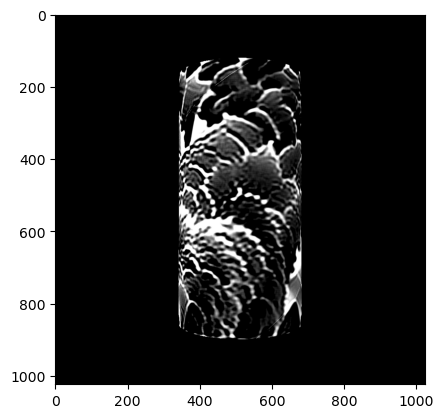

idx 173000 - img_loss: 0.49832290410995483, adv_loss 0.17922352254390717, grad norm 0.7470341920852661, lpips_loss 0


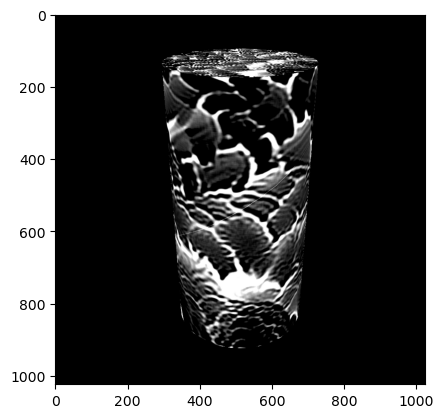

idx 174000 - img_loss: 0.4964279234409332, adv_loss 0.2739506661891937, grad norm 1.3305079936981201, lpips_loss 0
idx 174000 - img_loss: 0.4964279234409332, adv_loss 0.2739506661891937, grad norm 1.3305079936981201, lpips_loss 0
black swan: 68.6%
cup: 18.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3kh5sv5w, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8ijsey7d, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


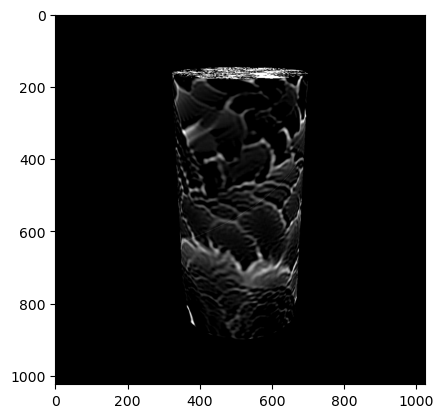

idx 175000 - img_loss: 0.18864305317401886, adv_loss 0.29838404059410095, grad norm 0.8277792930603027, lpips_loss 0


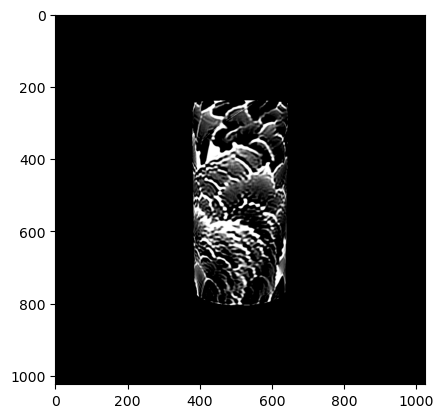

idx 176000 - img_loss: 0.5100696682929993, adv_loss 0.4535026550292969, grad norm 1.4327888488769531, lpips_loss 0
idx 176000 - img_loss: 0.5100696682929993, adv_loss 0.4535026550292969, grad norm 1.4327888488769531, lpips_loss 0
black swan: 70.7%
lampshade: 9.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpo7r_vtn3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpr3cx3bjn, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


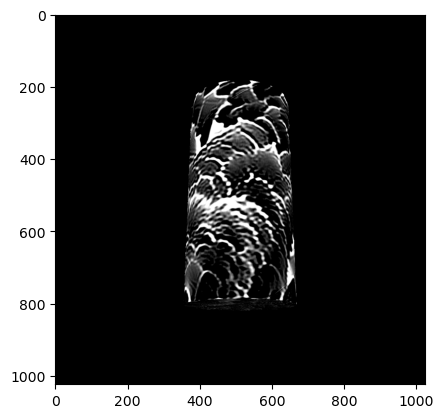

idx 177000 - img_loss: 0.5076857805252075, adv_loss 0.3513893783092499, grad norm 1.0575915575027466, lpips_loss 0


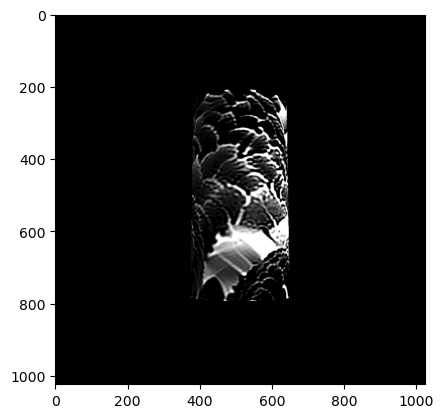

idx 178000 - img_loss: 0.34124210476875305, adv_loss 0.2648543417453766, grad norm 0.9922599196434021, lpips_loss 0
idx 178000 - img_loss: 0.34124210476875305, adv_loss 0.2648543417453766, grad norm 0.9922599196434021, lpips_loss 0
black swan: 81.7%
lampshade: 18.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphfh8mrrn, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpb782tus_, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


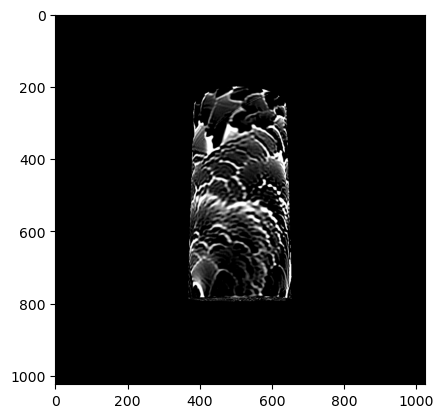

idx 179000 - img_loss: 0.46582233905792236, adv_loss 0.3147403299808502, grad norm 1.632383942604065, lpips_loss 0


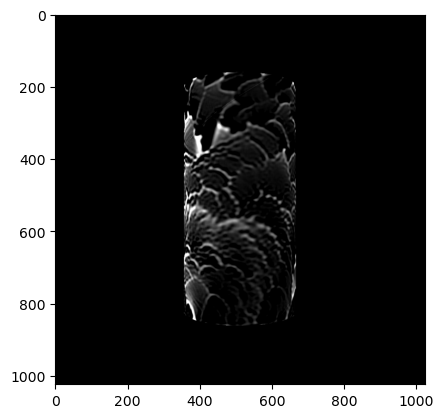

idx 180000 - img_loss: 0.21253152191638947, adv_loss 0.40615564584732056, grad norm 1.953693151473999, lpips_loss 0
idx 180000 - img_loss: 0.21253152191638947, adv_loss 0.40615564584732056, grad norm 1.953693151473999, lpips_loss 0
black swan: 74.7%
lighter: 13.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpq039o39e, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpkqmmf8p1, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


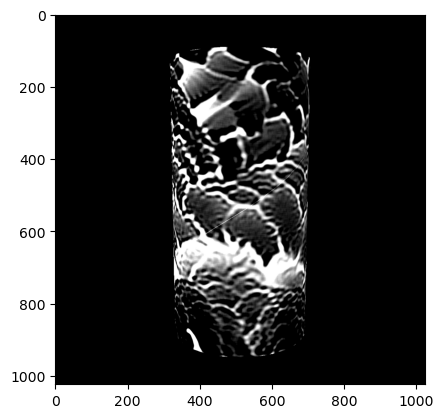

idx 181000 - img_loss: 0.5136798024177551, adv_loss 0.10234475880861282, grad norm 2.2713749408721924, lpips_loss 0


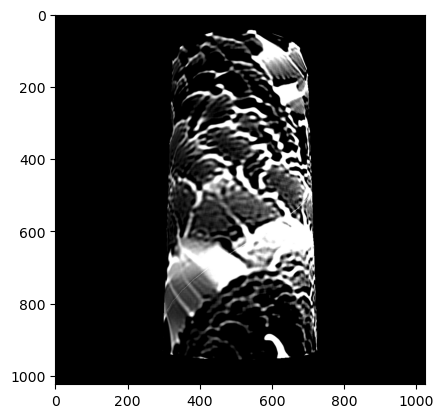

idx 182000 - img_loss: 0.39275890588760376, adv_loss 0.06317978352308273, grad norm 0.8594401478767395, lpips_loss 0
idx 182000 - img_loss: 0.39275890588760376, adv_loss 0.06317978352308273, grad norm 0.8594401478767395, lpips_loss 0
black swan: 97.8%
lampshade: 41.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpykv69_ht, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpw7ie0cvc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


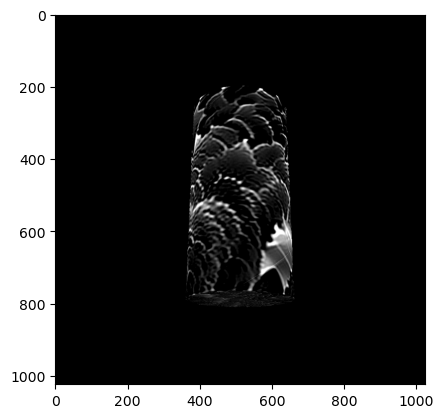

idx 183000 - img_loss: 0.2729426920413971, adv_loss 0.37160733342170715, grad norm 0.9320929646492004, lpips_loss 0


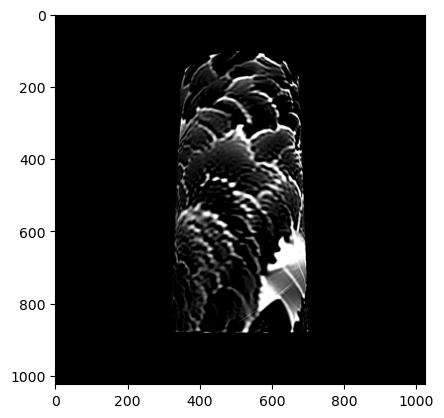

idx 184000 - img_loss: 0.38826286792755127, adv_loss 0.20901277661323547, grad norm 1.3425836563110352, lpips_loss 0
idx 184000 - img_loss: 0.38826286792755127, adv_loss 0.20901277661323547, grad norm 1.3425836563110352, lpips_loss 0
black swan: 88.0%
lampshade: 33.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpy4_uyukj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpxyxptrmz, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


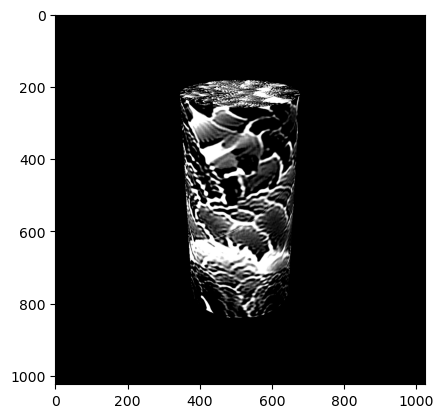

idx 185000 - img_loss: 0.43658584356307983, adv_loss 0.539378821849823, grad norm 3.0789029598236084, lpips_loss 0


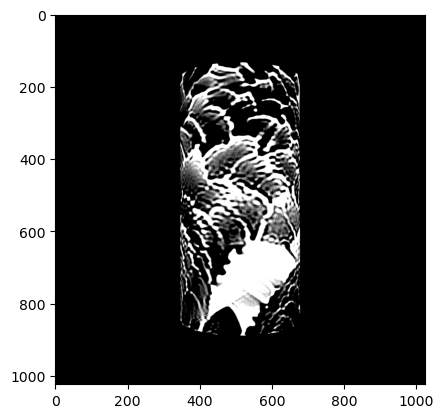

idx 186000 - img_loss: 0.31379061937332153, adv_loss 0.16233879327774048, grad norm 1.2467049360275269, lpips_loss 0
idx 186000 - img_loss: 0.31379061937332153, adv_loss 0.16233879327774048, grad norm 1.2467049360275269, lpips_loss 0
black swan: 86.4%
lampshade: 11.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8d7dibt2, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3jr_9wvt, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


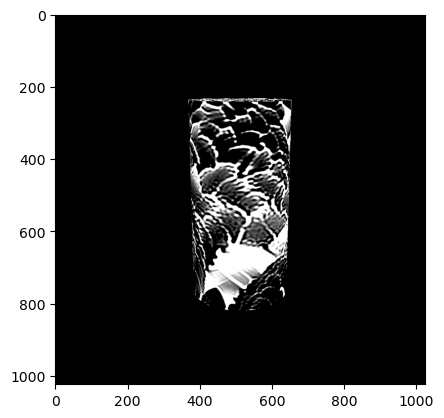

idx 187000 - img_loss: 0.37825408577919006, adv_loss 0.4350948631763458, grad norm 1.369249701499939, lpips_loss 0


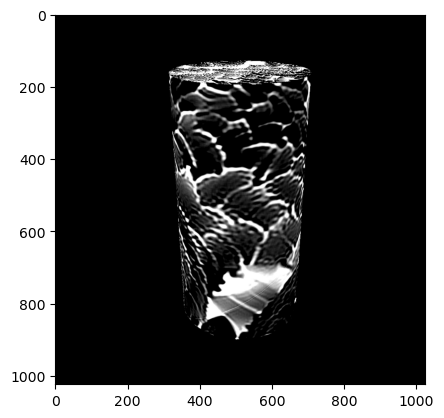

idx 188000 - img_loss: 0.4407459497451782, adv_loss 0.14155156910419464, grad norm 1.5901113748550415, lpips_loss 0
idx 188000 - img_loss: 0.4407459497451782, adv_loss 0.14155156910419464, grad norm 1.5901113748550415, lpips_loss 0
black swan: 79.6%
cup: 23.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpo_abgifo, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpa9ms6232, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


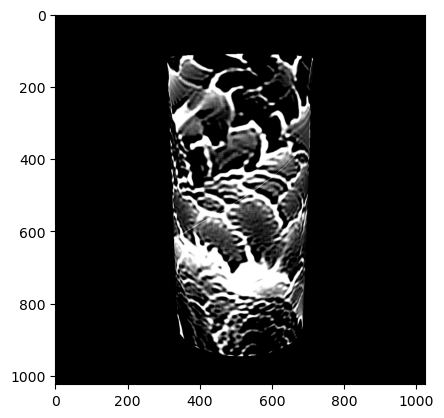

idx 189000 - img_loss: 0.4579865634441376, adv_loss 0.2366335242986679, grad norm 2.14302134513855, lpips_loss 0


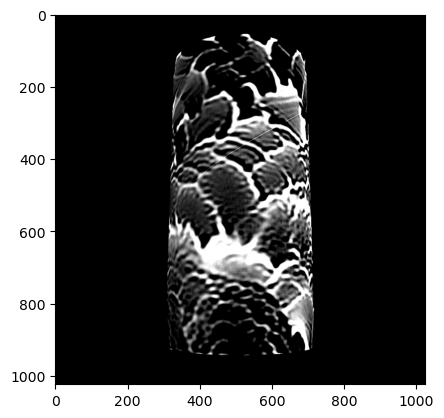

idx 190000 - img_loss: 0.46800538897514343, adv_loss 0.21260668337345123, grad norm 1.399656057357788, lpips_loss 0
idx 190000 - img_loss: 0.46800538897514343, adv_loss 0.21260668337345123, grad norm 1.399656057357788, lpips_loss 0
black swan: 81.3%
lampshade: 40.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmprhqn21lc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpdvl60s00, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


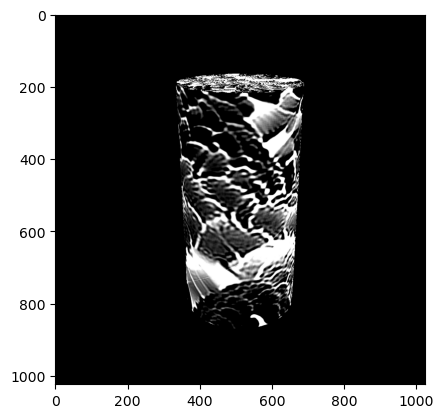

idx 191000 - img_loss: 0.41585078835487366, adv_loss 0.40771350264549255, grad norm 2.8492701053619385, lpips_loss 0
nan found in prediction


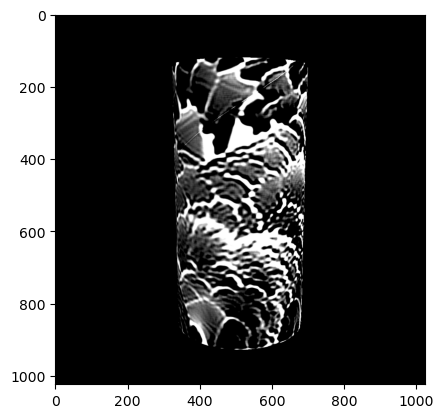

idx 192000 - img_loss: 0.4395977556705475, adv_loss 0.17640745639801025, grad norm 1.70652437210083, lpips_loss 0
idx 192000 - img_loss: 0.4395977556705475, adv_loss 0.17640745639801025, grad norm 1.70652437210083, lpips_loss 0
black swan: 89.2%
lampshade: 10.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_9vz32o7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphpu8ud3n, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


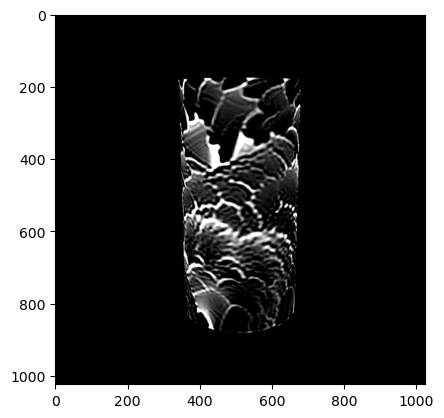

idx 193000 - img_loss: 0.44902777671813965, adv_loss 0.15447644889354706, grad norm 0.7334804534912109, lpips_loss 0


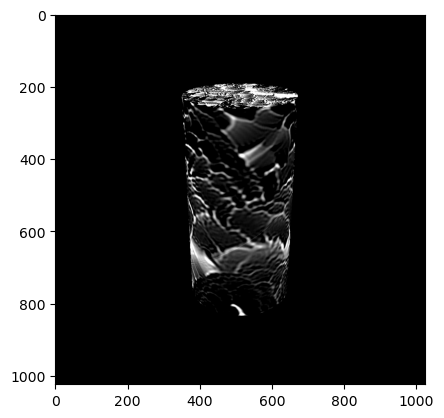

idx 194000 - img_loss: 0.26085883378982544, adv_loss 0.47503358125686646, grad norm 1.5114588737487793, lpips_loss 0
idx 194000 - img_loss: 0.26085883378982544, adv_loss 0.47503358125686646, grad norm 1.5114588737487793, lpips_loss 0
black swan: 54.0%
cup: 12.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpb86xs7xb, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpj_9re1lq, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


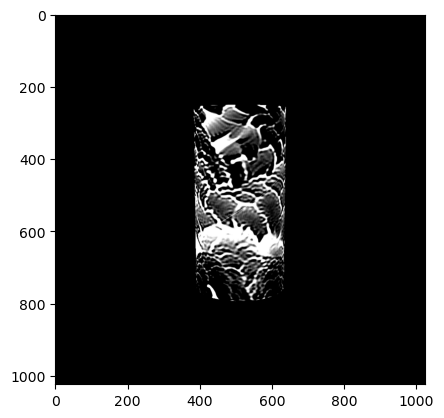

idx 195000 - img_loss: 0.45800045132637024, adv_loss 0.3489511013031006, grad norm 1.628700852394104, lpips_loss 0


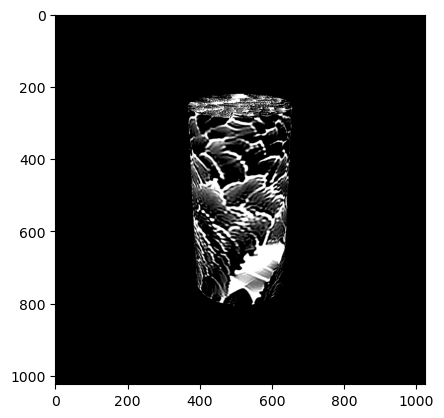

idx 196000 - img_loss: 0.45822903513908386, adv_loss 0.5839929580688477, grad norm 8.165972709655762, lpips_loss 0
idx 196000 - img_loss: 0.45822903513908386, adv_loss 0.5839929580688477, grad norm 8.165972709655762, lpips_loss 0
black swan: 72.3%
beaker: 14.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpmgj0d34f, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpjlu3spim, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


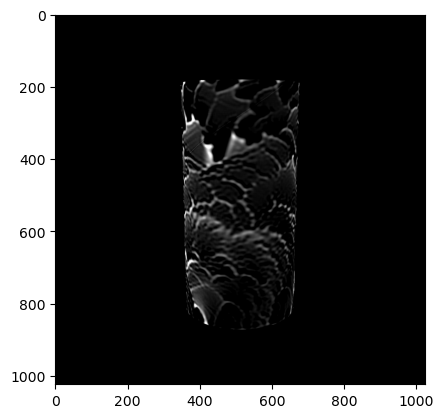

idx 197000 - img_loss: 0.18433932960033417, adv_loss 0.7843136787414551, grad norm 2.2577781677246094, lpips_loss 0


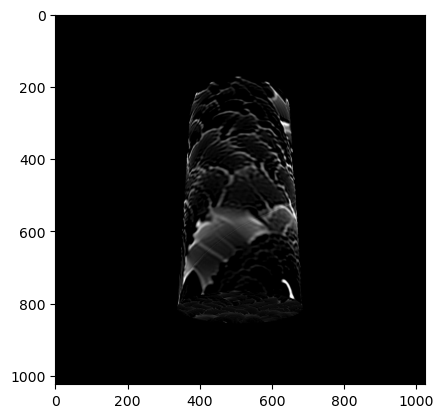

idx 198000 - img_loss: 0.1435999721288681, adv_loss 0.3954859972000122, grad norm 0.9470097422599792, lpips_loss 0
idx 198000 - img_loss: 0.1435999721288681, adv_loss 0.3954859972000122, grad norm 0.9470097422599792, lpips_loss 0
black swan: 81.6%
lampshade: 30.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp7gsaut0a, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp5qtne19a, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


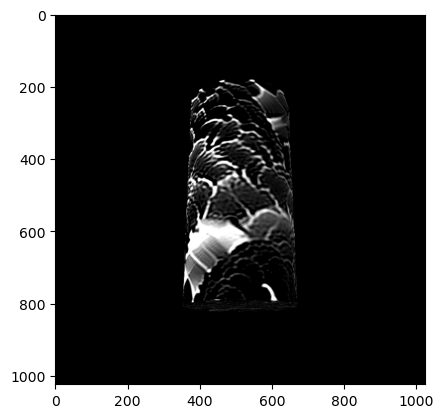

idx 199000 - img_loss: 0.3194428086280823, adv_loss 0.23499558866024017, grad norm 1.1857541799545288, lpips_loss 0


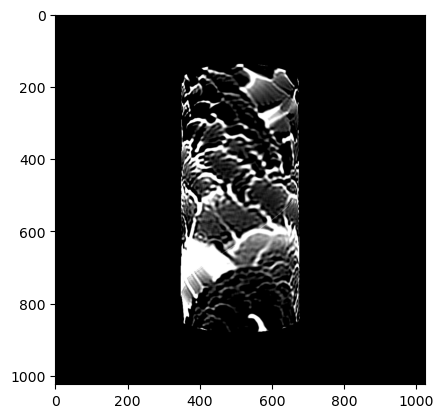

idx 200000 - img_loss: 0.4487215578556061, adv_loss 0.1504283845424652, grad norm 1.0573022365570068, lpips_loss 0
idx 200000 - img_loss: 0.4487215578556061, adv_loss 0.1504283845424652, grad norm 1.0573022365570068, lpips_loss 0
black swan: 97.4%
lighter: 10.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp2w7bwfx_, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpppczpz6r, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


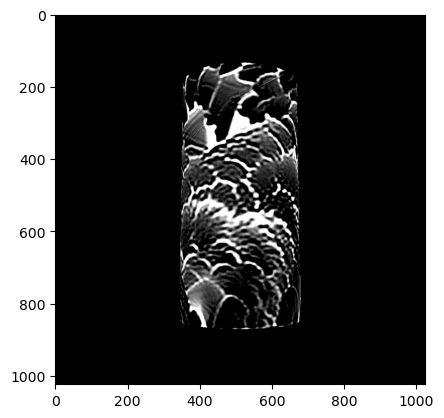

idx 201000 - img_loss: 0.5525203347206116, adv_loss 0.24426351487636566, grad norm 1.9855538606643677, lpips_loss 0


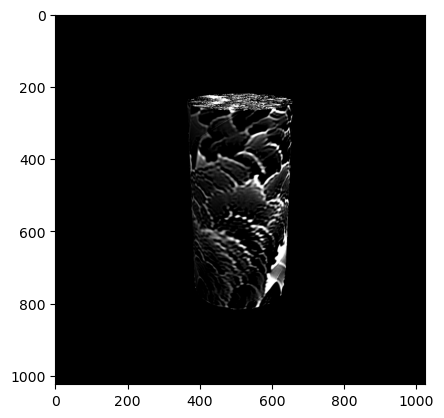

idx 202000 - img_loss: 0.3189443349838257, adv_loss 0.4185824692249298, grad norm 1.1100094318389893, lpips_loss 0
idx 202000 - img_loss: 0.3189443349838257, adv_loss 0.4185824692249298, grad norm 1.1100094318389893, lpips_loss 0
black swan: 64.6%
cup: 13.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpyp0afpl1, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpqirr0nzb, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


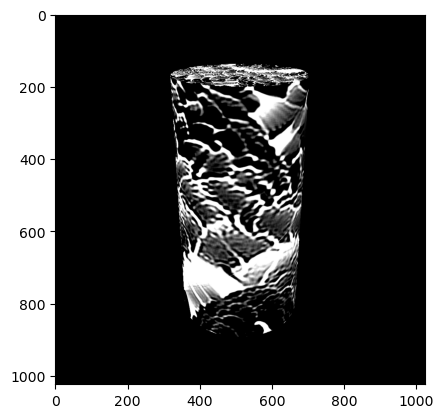

idx 203000 - img_loss: 0.41144105792045593, adv_loss 0.4127035439014435, grad norm 1.5136737823486328, lpips_loss 0


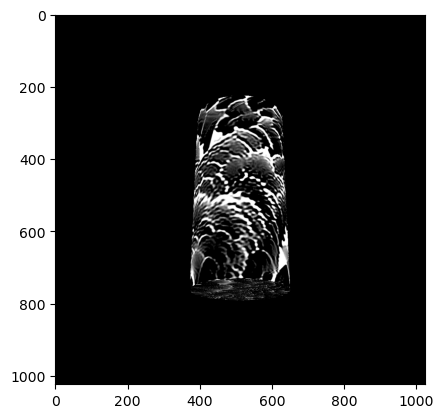

idx 204000 - img_loss: 0.49322572350502014, adv_loss 0.6816603541374207, grad norm 2.7261486053466797, lpips_loss 0
idx 204000 - img_loss: 0.49322572350502014, adv_loss 0.6816603541374207, grad norm 2.7261486053466797, lpips_loss 0
black swan: 62.9%
lampshade: 17.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1emydnmo, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpdjhpwwz7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


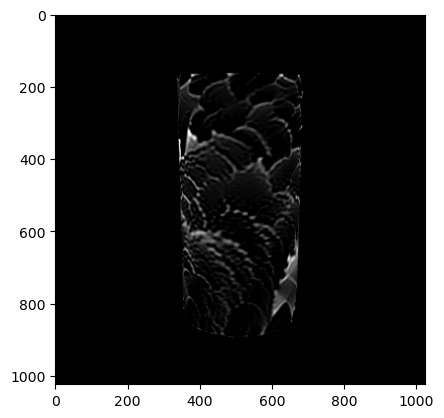

idx 205000 - img_loss: 0.150284081697464, adv_loss 0.205980122089386, grad norm 0.7582438588142395, lpips_loss 0


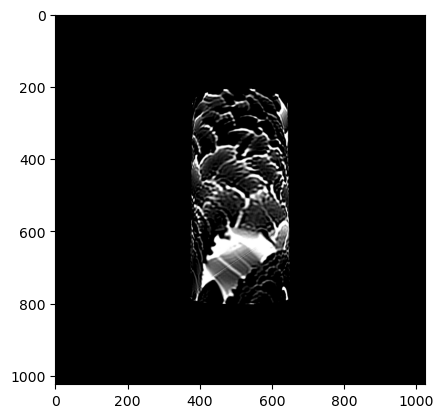

idx 206000 - img_loss: 0.41783004999160767, adv_loss 0.34371218085289, grad norm 0.9513010382652283, lpips_loss 0
idx 206000 - img_loss: 0.41783004999160767, adv_loss 0.34371218085289, grad norm 0.9513010382652283, lpips_loss 0
black swan: 83.8%
lampshade: 34.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_wijkjur, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpx2cusrg7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


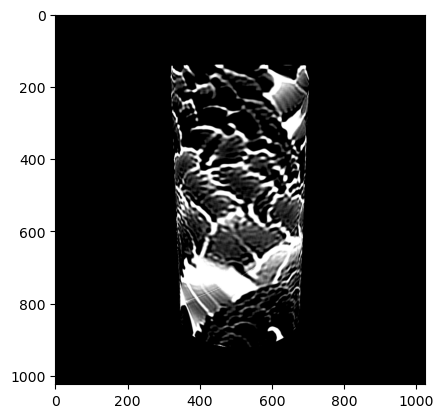

idx 207000 - img_loss: 0.5016906261444092, adv_loss 0.1985965073108673, grad norm 1.1939743757247925, lpips_loss 0
nan found in prediction


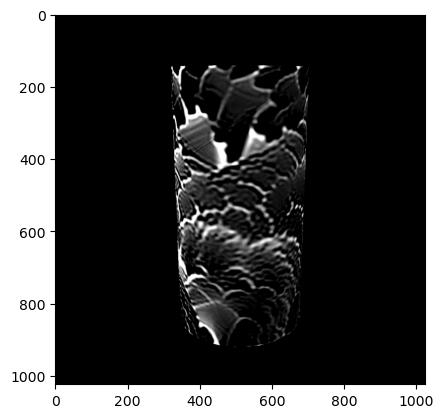

idx 208000 - img_loss: 0.3317815065383911, adv_loss 0.19016680121421814, grad norm 1.155548334121704, lpips_loss 0
idx 208000 - img_loss: 0.3317815065383911, adv_loss 0.19016680121421814, grad norm 1.155548334121704, lpips_loss 0
black swan: 86.4%
cup: 12.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpc5wnji31, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp7feyaf7p, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


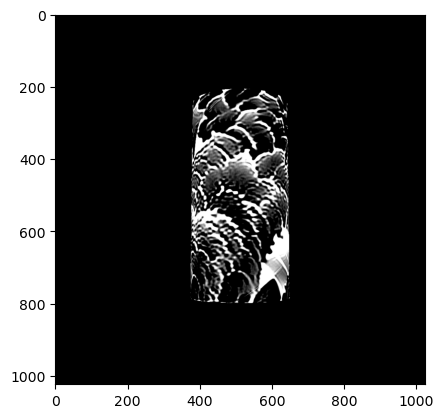

idx 209000 - img_loss: 0.4531458020210266, adv_loss 0.2648903727531433, grad norm 1.2942073345184326, lpips_loss 0


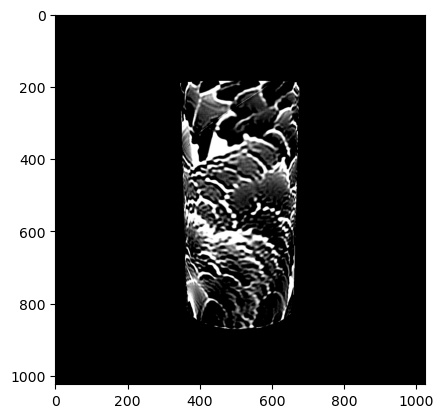

idx 210000 - img_loss: 0.5214248895645142, adv_loss 0.270646333694458, grad norm 0.7099963426589966, lpips_loss 0
idx 210000 - img_loss: 0.5214248895645142, adv_loss 0.270646333694458, grad norm 0.7099963426589966, lpips_loss 0
black swan: 72.6%
table lamp: 8.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp5tmy4ccc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3wakc6jv, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


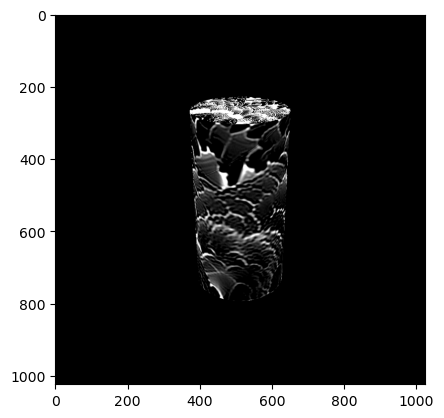

idx 211000 - img_loss: 0.296454519033432, adv_loss 1.7433762550354004, grad norm 15.03772258758545, lpips_loss 0


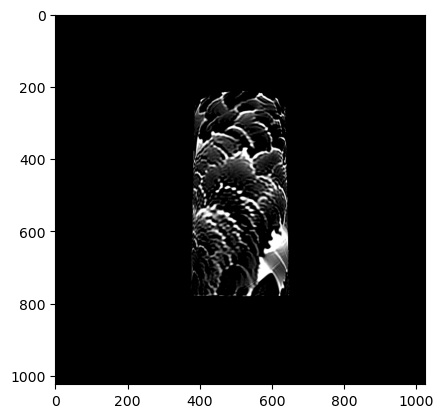

idx 212000 - img_loss: 0.448147714138031, adv_loss 0.4086166322231293, grad norm 1.150071144104004, lpips_loss 0
idx 212000 - img_loss: 0.448147714138031, adv_loss 0.4086166322231293, grad norm 1.150071144104004, lpips_loss 0
black swan: 78.9%
lampshade: 22.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpft993zzk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_eh0htnh, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


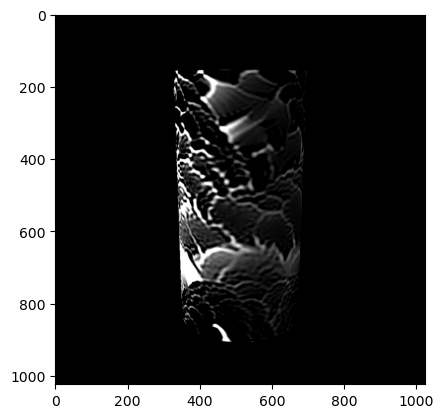

idx 213000 - img_loss: 0.2411373406648636, adv_loss 0.09674953669309616, grad norm 1.0608820915222168, lpips_loss 0


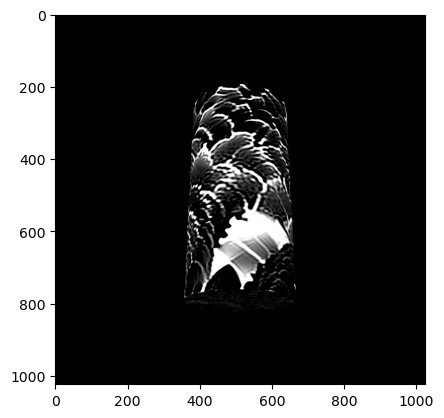

idx 214000 - img_loss: 0.4249649941921234, adv_loss 0.19980214536190033, grad norm 1.909032940864563, lpips_loss 0
idx 214000 - img_loss: 0.4249649941921234, adv_loss 0.19980214536190033, grad norm 1.909032940864563, lpips_loss 0
black swan: 81.9%
lampshade: 20.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpb5jtqgbc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmplzq543m9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


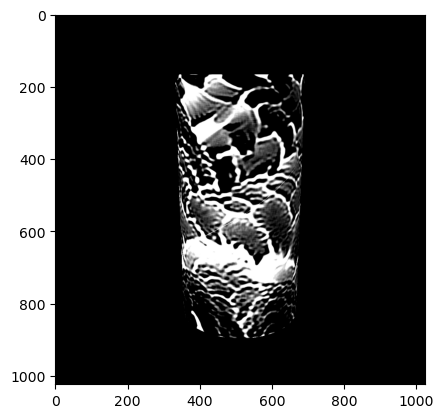

idx 215000 - img_loss: 0.3985939919948578, adv_loss 0.2023366540670395, grad norm 2.004774332046509, lpips_loss 0


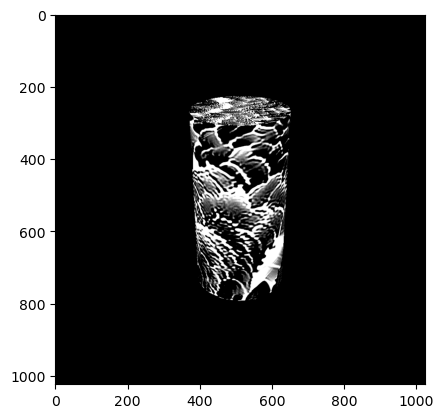

idx 216000 - img_loss: 0.3582290709018707, adv_loss 0.5132914185523987, grad norm 4.666823387145996, lpips_loss 0
idx 216000 - img_loss: 0.3582290709018707, adv_loss 0.5132914185523987, grad norm 4.666823387145996, lpips_loss 0
black swan: 25.6%
beaker: 15.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpdcvlud_6, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpal2cs1zr, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


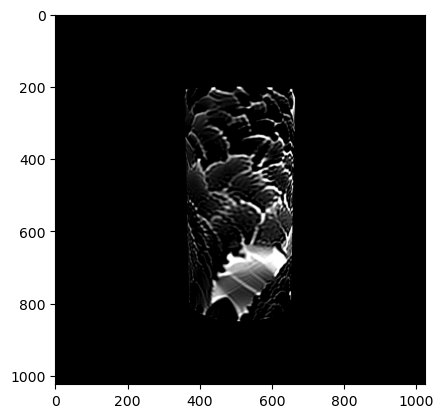

idx 217000 - img_loss: 0.31481996178627014, adv_loss 0.25349730253219604, grad norm 0.6031405925750732, lpips_loss 0


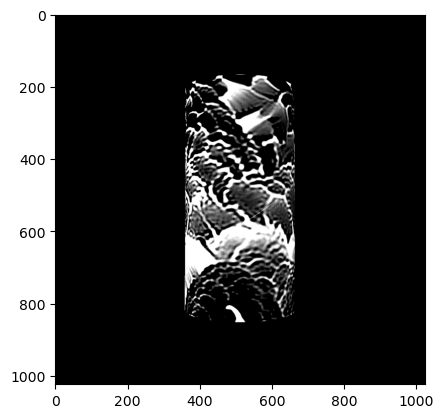

idx 218000 - img_loss: 0.4431392252445221, adv_loss 0.2739948034286499, grad norm 1.2498310804367065, lpips_loss 0
idx 218000 - img_loss: 0.4431392252445221, adv_loss 0.2739948034286499, grad norm 1.2498310804367065, lpips_loss 0
black swan: 87.9%
lampshade: 11.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp12itgknh, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpc133o8s5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


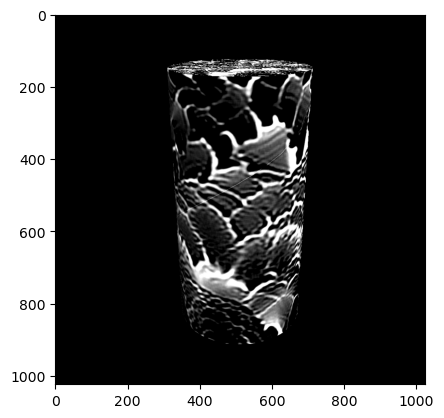

idx 219000 - img_loss: 0.4880363643169403, adv_loss 0.34375089406967163, grad norm 1.2315690517425537, lpips_loss 0


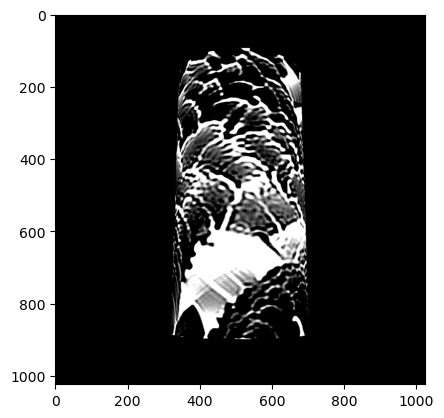

idx 220000 - img_loss: 0.35265713930130005, adv_loss 0.041529521346092224, grad norm 0.9389680624008179, lpips_loss 0
idx 220000 - img_loss: 0.35265713930130005, adv_loss 0.041529521346092224, grad norm 0.9389680624008179, lpips_loss 0
black swan: 95.9%
lampshade: 29.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphl062jct, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3m39b5t9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


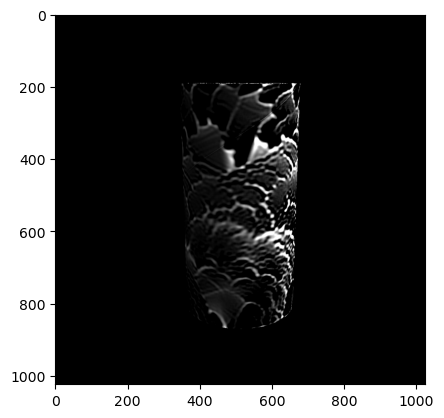

idx 221000 - img_loss: 0.2491227239370346, adv_loss 0.3075721859931946, grad norm 1.0977452993392944, lpips_loss 0


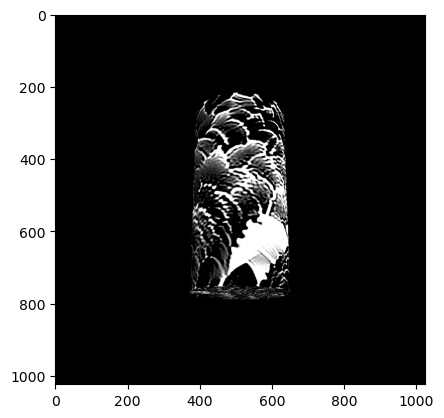

idx 222000 - img_loss: 0.3524220287799835, adv_loss 0.6968403458595276, grad norm 7.081230163574219, lpips_loss 0
idx 222000 - img_loss: 0.3524220287799835, adv_loss 0.6968403458595276, grad norm 7.081230163574219, lpips_loss 0
black swan: 74.8%
lampshade: 30.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1jdd09ry, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3rgcflsl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


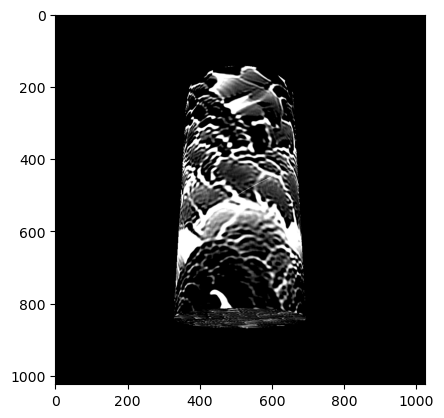

idx 223000 - img_loss: 0.4623006582260132, adv_loss 0.25107860565185547, grad norm 1.271166443824768, lpips_loss 0


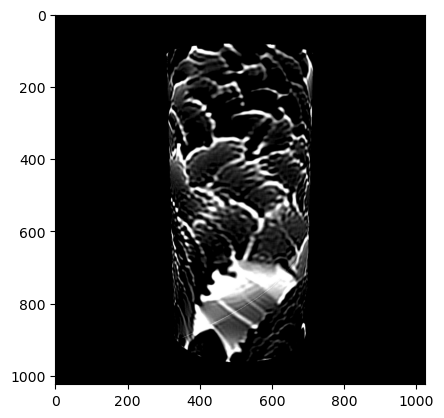

idx 224000 - img_loss: 0.405793160200119, adv_loss 0.07056151330471039, grad norm 0.42979368567466736, lpips_loss 0
idx 224000 - img_loss: 0.405793160200119, adv_loss 0.07056151330471039, grad norm 0.42979368567466736, lpips_loss 0
black swan: 96.5%
lampshade: 12.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpt0qu9xfo, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpb7577rj7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


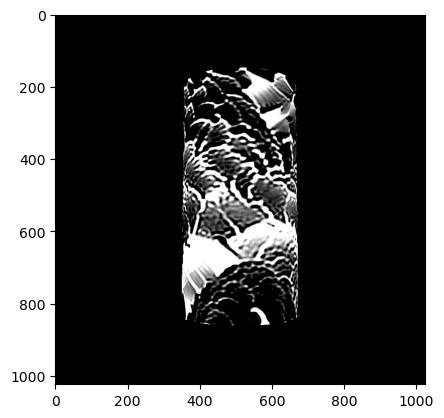

idx 225000 - img_loss: 0.3774615228176117, adv_loss 0.1283472627401352, grad norm 4.355681419372559, lpips_loss 0


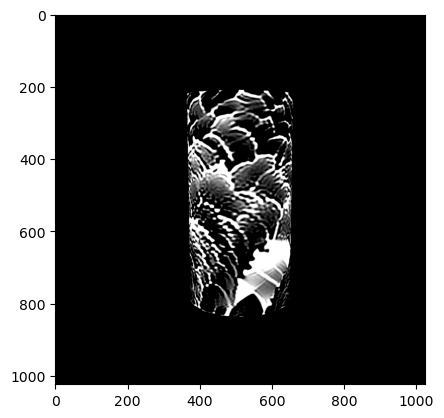

idx 226000 - img_loss: 0.4295734465122223, adv_loss 0.37599965929985046, grad norm 2.752854824066162, lpips_loss 0
idx 226000 - img_loss: 0.4295734465122223, adv_loss 0.37599965929985046, grad norm 2.752854824066162, lpips_loss 0
black swan: 78.8%
table lamp: 8.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpso_t9p7b, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp2ebrs4vk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


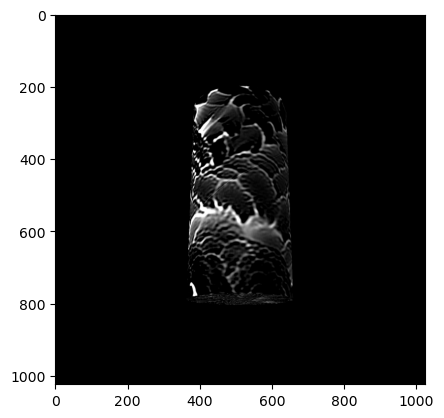

idx 227000 - img_loss: 0.2797947824001312, adv_loss 1.071492075920105, grad norm 9.604799270629883, lpips_loss 0


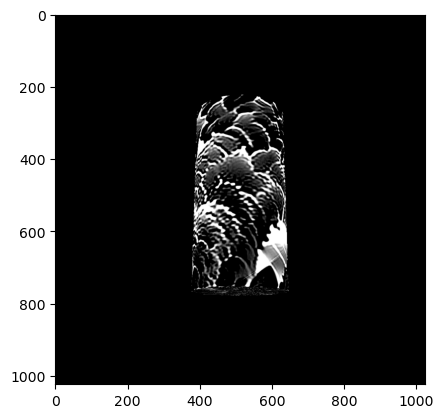

idx 228000 - img_loss: 0.49964386224746704, adv_loss 0.4145154058933258, grad norm 1.0932472944259644, lpips_loss 0
idx 228000 - img_loss: 0.49964386224746704, adv_loss 0.4145154058933258, grad norm 1.0932472944259644, lpips_loss 0
black swan: 78.0%
table lamp: 18.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmptafw3kzy, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp13im9stc, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


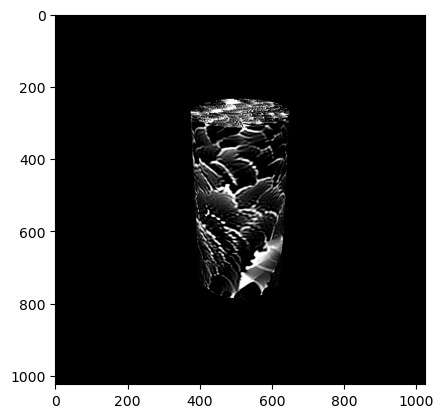

idx 229000 - img_loss: 0.40871840715408325, adv_loss 1.0733213424682617, grad norm 8.648916244506836, lpips_loss 0
nan found in prediction


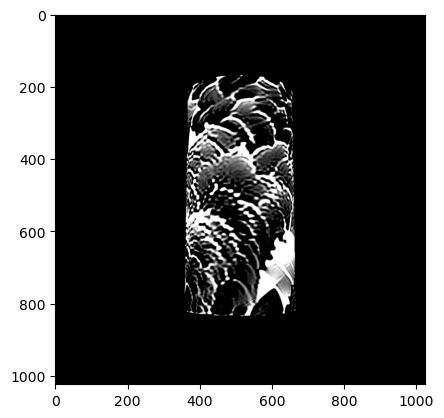

idx 230000 - img_loss: 0.44786882400512695, adv_loss 0.3043437898159027, grad norm 1.672406554222107, lpips_loss 0
idx 230000 - img_loss: 0.44786882400512695, adv_loss 0.3043437898159027, grad norm 1.672406554222107, lpips_loss 0
black swan: 78.5%
table lamp: 19.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp6_e7pdph, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpmc2hyg9g, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


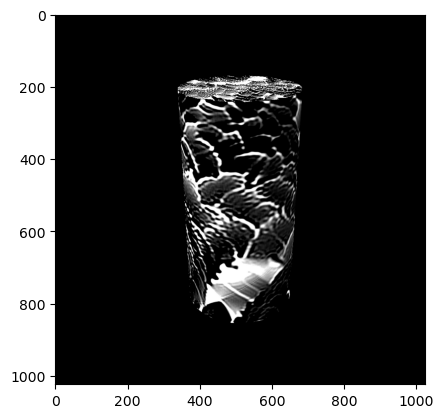

idx 231000 - img_loss: 0.4089514911174774, adv_loss 0.3592229187488556, grad norm 1.163582444190979, lpips_loss 0


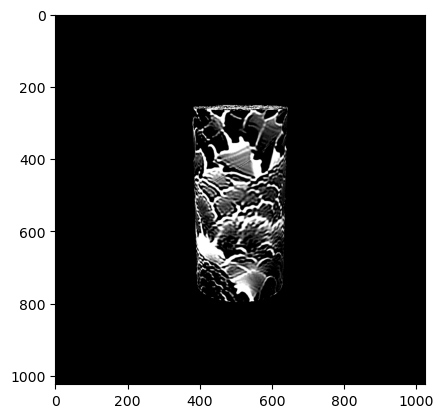

idx 232000 - img_loss: 0.43869420886039734, adv_loss 1.0935828685760498, grad norm 17.62509536743164, lpips_loss 0
idx 232000 - img_loss: 0.43869420886039734, adv_loss 1.0935828685760498, grad norm 17.62509536743164, lpips_loss 0
black swan: 75.6%
coffee mug: 12.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp556gfu56, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1agi0byn, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


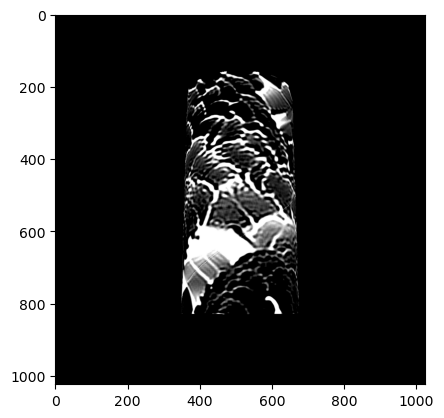

idx 233000 - img_loss: 0.45396319031715393, adv_loss 0.14708538353443146, grad norm 1.2822937965393066, lpips_loss 0


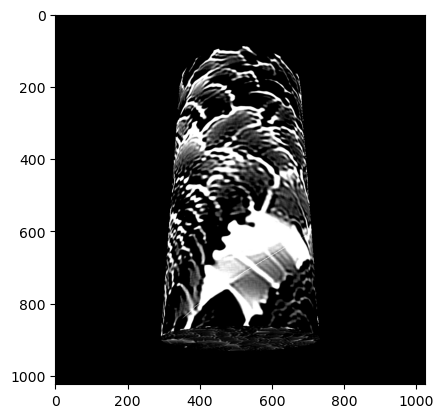

idx 234000 - img_loss: 0.3995720148086548, adv_loss 0.0469767227768898, grad norm 0.6335210204124451, lpips_loss 0
idx 234000 - img_loss: 0.3995720148086548, adv_loss 0.0469767227768898, grad norm 0.6335210204124451, lpips_loss 0
black swan: 91.7%
lampshade: 31.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpouyg3yhb, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpm5r35p60, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


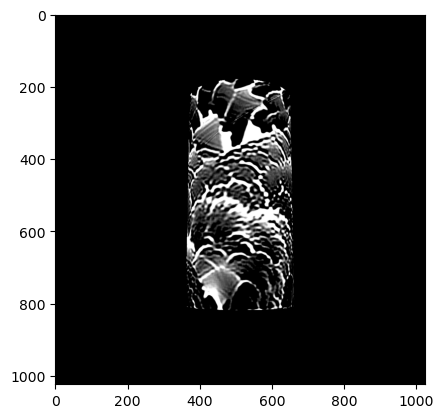

idx 235000 - img_loss: 0.48032841086387634, adv_loss 0.15947237610816956, grad norm 0.8358412981033325, lpips_loss 0
nan found in prediction


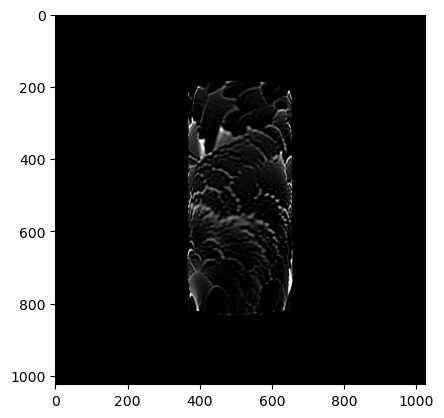

idx 236000 - img_loss: 0.1771971434354782, adv_loss 0.40927404165267944, grad norm 0.8426916599273682, lpips_loss 0
idx 236000 - img_loss: 0.1771971434354782, adv_loss 0.40927404165267944, grad norm 0.8426916599273682, lpips_loss 0
black swan: 71.1%
lighter: 8.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpsce9otz9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpdfz3gim_, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


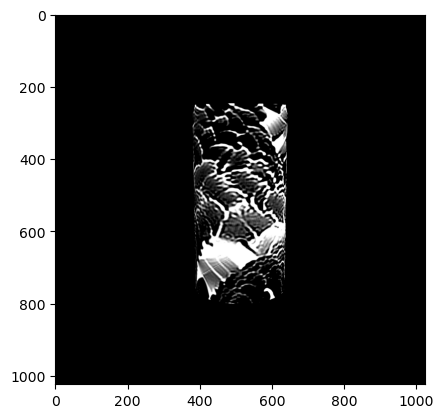

idx 237000 - img_loss: 0.42101383209228516, adv_loss 0.45506733655929565, grad norm 2.6844162940979004, lpips_loss 0


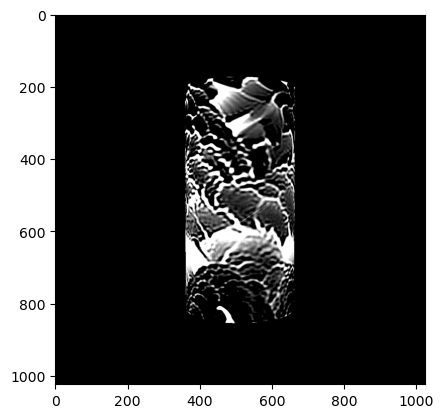

idx 238000 - img_loss: 0.4570996165275574, adv_loss 0.2779231667518616, grad norm 1.092538833618164, lpips_loss 0
idx 238000 - img_loss: 0.4570996165275574, adv_loss 0.2779231667518616, grad norm 1.092538833618164, lpips_loss 0
black swan: 90.2%
lighter: 9.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpv9rr8c6y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmphqq6ap0p, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


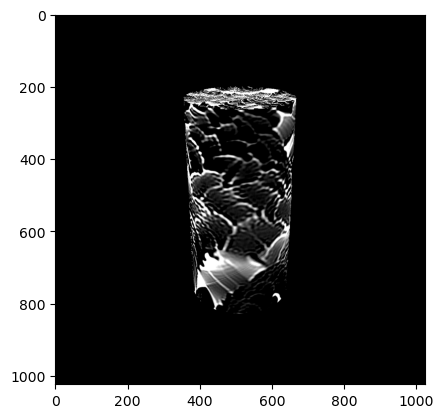

idx 239000 - img_loss: 0.330817848443985, adv_loss 0.3619002401828766, grad norm 0.9842249155044556, lpips_loss 0


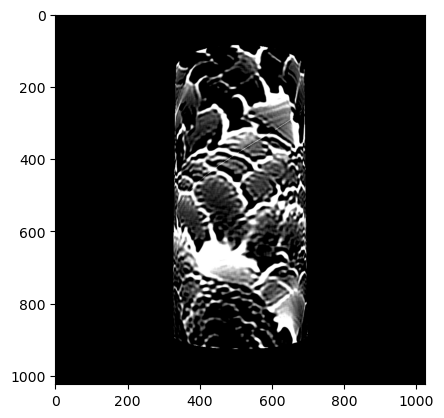

idx 240000 - img_loss: 0.4920786917209625, adv_loss 0.12264552712440491, grad norm 1.9611923694610596, lpips_loss 0
idx 240000 - img_loss: 0.4920786917209625, adv_loss 0.12264552712440491, grad norm 1.9611923694610596, lpips_loss 0
black swan: 82.6%
lampshade: 10.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpekzhcp5y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpbbyprlg8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


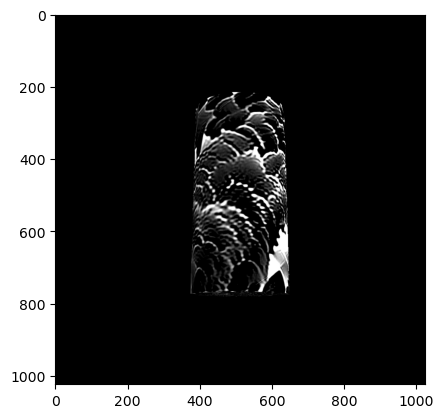

idx 241000 - img_loss: 0.43658915162086487, adv_loss 0.34098371863365173, grad norm 1.0656938552856445, lpips_loss 0


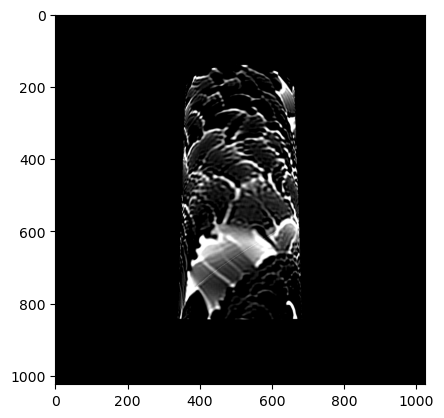

idx 242000 - img_loss: 0.35266393423080444, adv_loss 0.16731858253479004, grad norm 0.8970987200737, lpips_loss 0
idx 242000 - img_loss: 0.35266393423080444, adv_loss 0.16731858253479004, grad norm 0.8970987200737, lpips_loss 0
black swan: 94.6%
lampshade: 17.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpm4uh0hvl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_frnkf_r, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


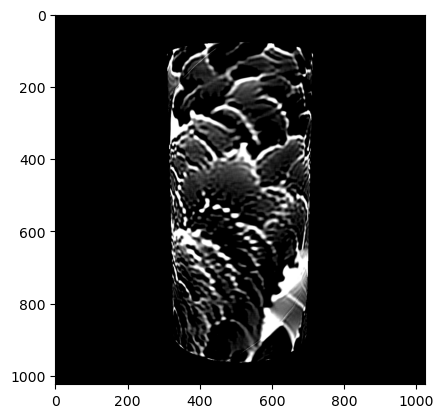

idx 243000 - img_loss: 0.48605620861053467, adv_loss 0.08191298693418503, grad norm 0.6163367629051208, lpips_loss 0


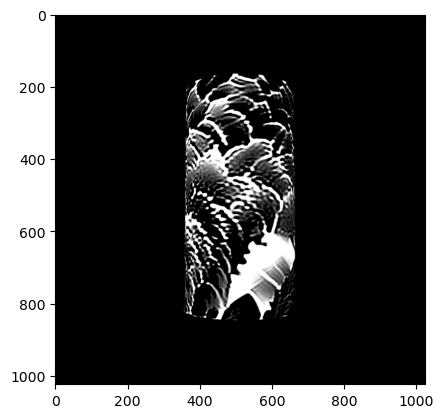

idx 244000 - img_loss: 0.40242138504981995, adv_loss 0.1034461036324501, grad norm 1.3374738693237305, lpips_loss 0
idx 244000 - img_loss: 0.40242138504981995, adv_loss 0.1034461036324501, grad norm 1.3374738693237305, lpips_loss 0
black swan: 90.2%
lighter: 12.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp7zz4f_fl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpd7oqweca, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


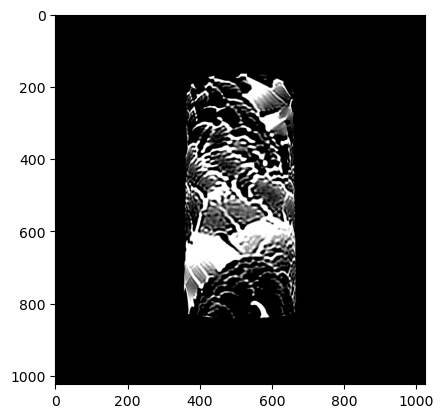

idx 245000 - img_loss: 0.37738585472106934, adv_loss 0.18049921095371246, grad norm 1.953502893447876, lpips_loss 0


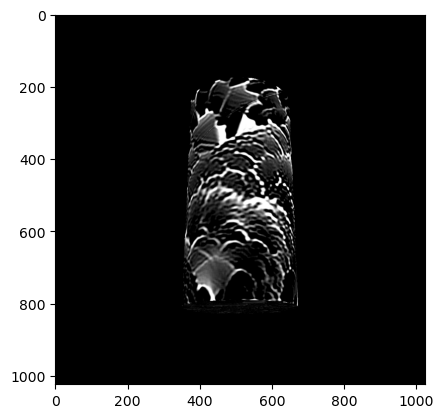

idx 246000 - img_loss: 0.45613494515419006, adv_loss 0.23916789889335632, grad norm 0.8860152363777161, lpips_loss 0
idx 246000 - img_loss: 0.45613494515419006, adv_loss 0.23916789889335632, grad norm 0.8860152363777161, lpips_loss 0
black swan: 89.1%
lampshade: 37.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_5mazaha, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpiibie8fe, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


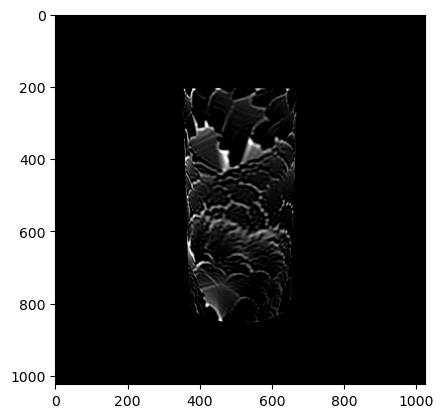

idx 247000 - img_loss: 0.21355873346328735, adv_loss 0.24004043638706207, grad norm 0.697159469127655, lpips_loss 0


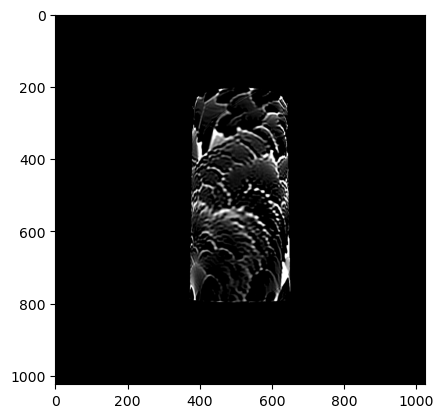

idx 248000 - img_loss: 0.3472509980201721, adv_loss 0.5675339102745056, grad norm 1.0359857082366943, lpips_loss 0
idx 248000 - img_loss: 0.3472509980201721, adv_loss 0.5675339102745056, grad norm 1.0359857082366943, lpips_loss 0
black swan: 71.9%
lampshade: 29.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpsm2dkm9k, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpiwxx8x1y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


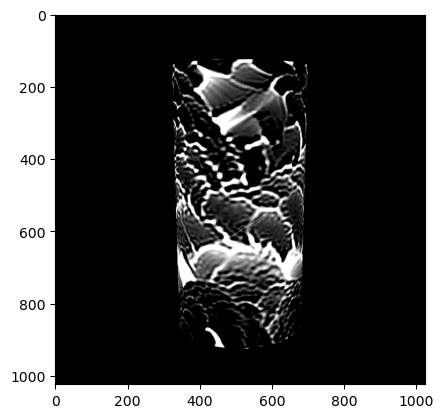

idx 249000 - img_loss: 0.5246185064315796, adv_loss 0.09915704280138016, grad norm 1.5629969835281372, lpips_loss 0


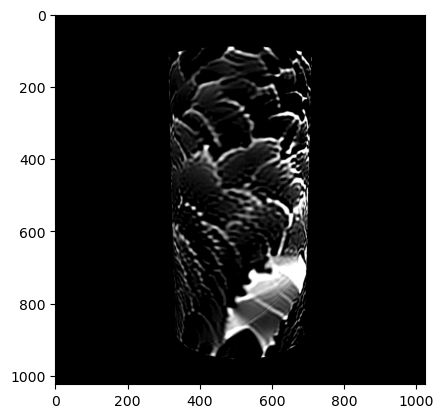

idx 250000 - img_loss: 0.30563417077064514, adv_loss 0.07238169759511948, grad norm 0.6875817179679871, lpips_loss 0
idx 250000 - img_loss: 0.30563417077064514, adv_loss 0.07238169759511948, grad norm 0.6875817179679871, lpips_loss 0
black swan: 93.0%
coffee mug: 15.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpa3_9dits, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpos89gn8r, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


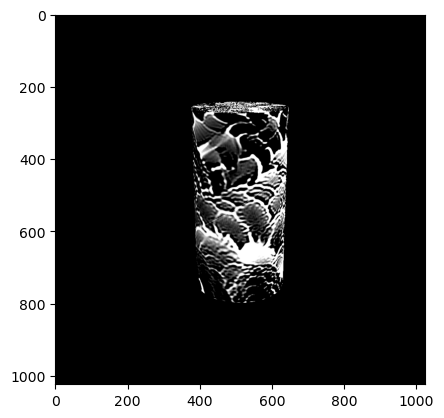

idx 251000 - img_loss: 0.4207454323768616, adv_loss 0.7062555551528931, grad norm 3.002514123916626, lpips_loss 0


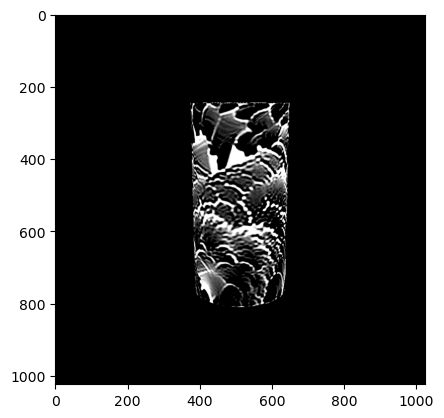

idx 252000 - img_loss: 0.5080111622810364, adv_loss 0.542141854763031, grad norm 1.4117411375045776, lpips_loss 0
idx 252000 - img_loss: 0.5080111622810364, adv_loss 0.542141854763031, grad norm 1.4117411375045776, lpips_loss 0
black swan: 83.7%
pill bottle: 6.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpmlk8zxvy, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpacfn0kwa, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


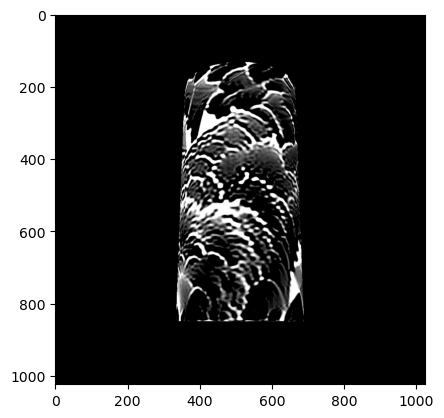

idx 253000 - img_loss: 0.4999921917915344, adv_loss 0.16809296607971191, grad norm 1.2648166418075562, lpips_loss 0
nan found in prediction
nan found in prediction


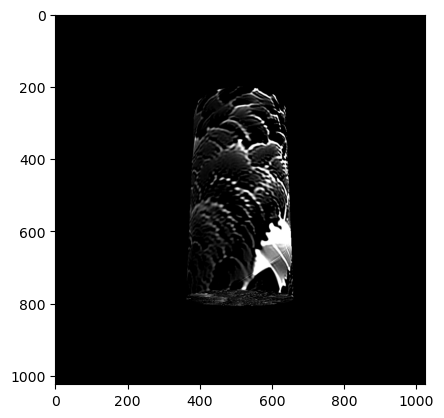

idx 254000 - img_loss: 0.29630595445632935, adv_loss 0.651951789855957, grad norm 1.5815621614456177, lpips_loss 0
idx 254000 - img_loss: 0.29630595445632935, adv_loss 0.651951789855957, grad norm 1.5815621614456177, lpips_loss 0
black swan: 70.9%
lampshade: 33.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp6x6m5k_u, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpz9ba01m3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


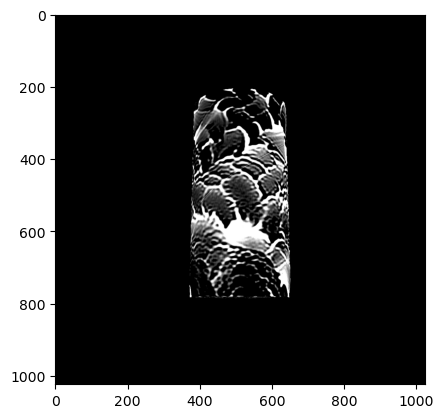

idx 255000 - img_loss: 0.4696469306945801, adv_loss 0.3298380672931671, grad norm 1.1376062631607056, lpips_loss 0


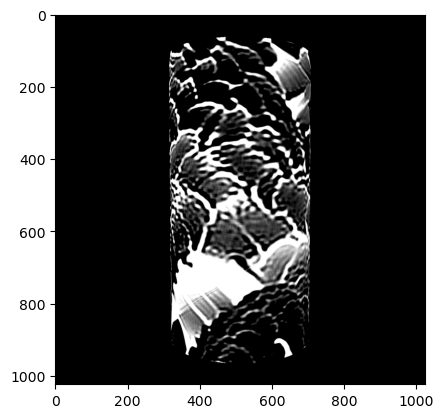

idx 256000 - img_loss: 0.4353545010089874, adv_loss 0.06205332651734352, grad norm 0.7318308353424072, lpips_loss 0
idx 256000 - img_loss: 0.4353545010089874, adv_loss 0.06205332651734352, grad norm 0.7318308353424072, lpips_loss 0
black swan: 98.6%
pill bottle: 7.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpxodr2yq7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpalor_d70, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


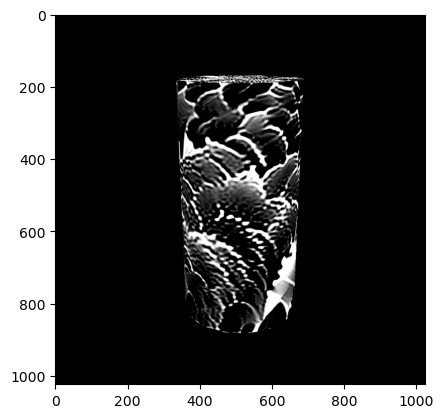

idx 257000 - img_loss: 0.510150671005249, adv_loss 0.20321622490882874, grad norm 0.8894135355949402, lpips_loss 0


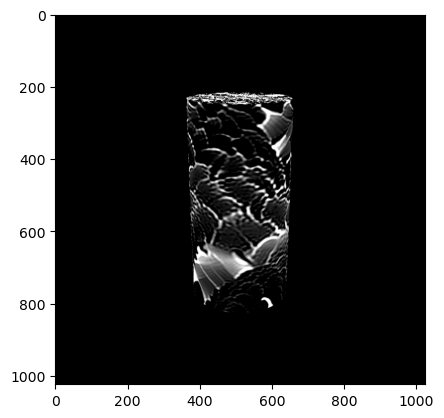

idx 258000 - img_loss: 0.31021225452423096, adv_loss 0.5511457324028015, grad norm 1.0885534286499023, lpips_loss 0
idx 258000 - img_loss: 0.31021225452423096, adv_loss 0.5511457324028015, grad norm 1.0885534286499023, lpips_loss 0
black swan: 71.5%
cup: 17.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_iee5exa, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpiqpw62h2, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


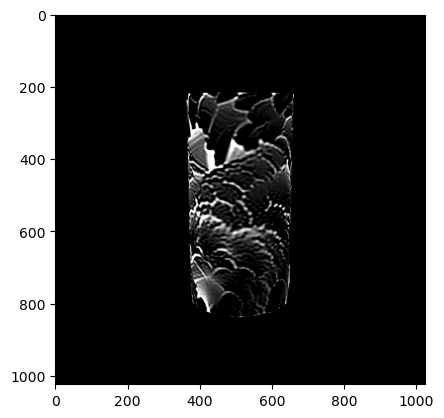

idx 259000 - img_loss: 0.33879631757736206, adv_loss 0.330824077129364, grad norm 0.9497291445732117, lpips_loss 0


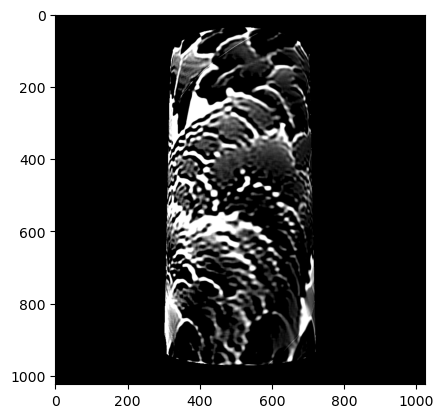

idx 260000 - img_loss: 0.44975635409355164, adv_loss 0.104813352227211, grad norm 1.6008673906326294, lpips_loss 0
idx 260000 - img_loss: 0.44975635409355164, adv_loss 0.104813352227211, grad norm 1.6008673906326294, lpips_loss 0
black swan: 93.7%
lampshade: 14.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnkr3hp6_, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp4ifql3nx, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


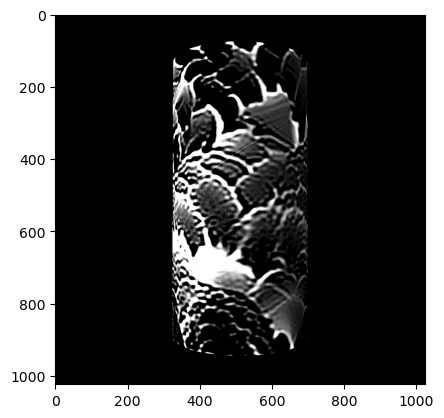

idx 261000 - img_loss: 0.38040798902511597, adv_loss 0.1549389511346817, grad norm 1.4701616764068604, lpips_loss 0
nan found in prediction


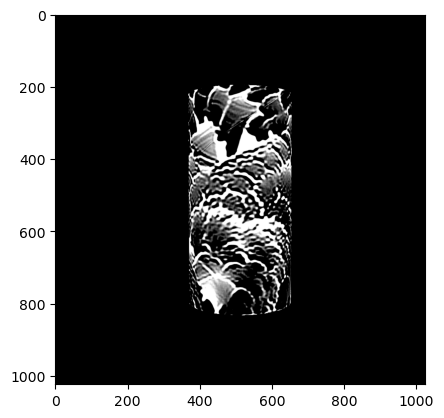

idx 262000 - img_loss: 0.3792203664779663, adv_loss 0.2961614429950714, grad norm 1.3867725133895874, lpips_loss 0
idx 262000 - img_loss: 0.3792203664779663, adv_loss 0.2961614429950714, grad norm 1.3867725133895874, lpips_loss 0
black swan: 84.0%
lampshade: 13.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_e5ewmhh, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp0mk01b_b, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


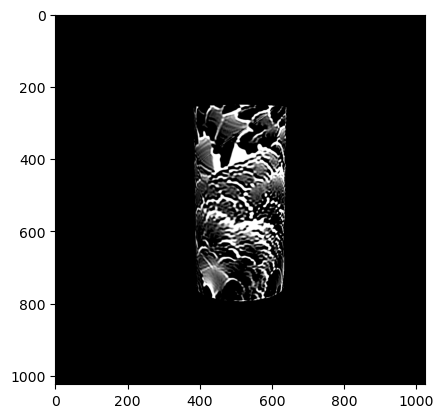

idx 263000 - img_loss: 0.4494447708129883, adv_loss 0.5563971400260925, grad norm 1.7972254753112793, lpips_loss 0


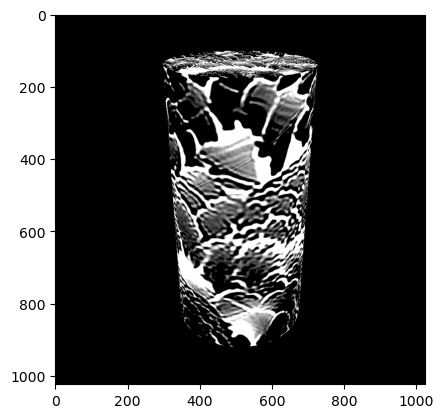

idx 264000 - img_loss: 0.35900017619132996, adv_loss 1.4175057411193848, grad norm 38.558082580566406, lpips_loss 0
idx 264000 - img_loss: 0.35900017619132996, adv_loss 1.4175057411193848, grad norm 38.558082580566406, lpips_loss 0
black swan: 64.2%
vase: 11.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpfxbnf6gj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp61ji8z9w, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


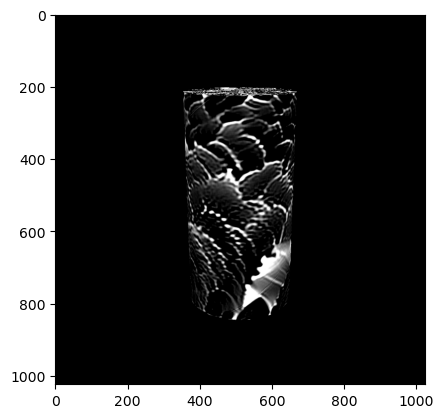

idx 265000 - img_loss: 0.3809037506580353, adv_loss 0.29347166419029236, grad norm 0.6711674332618713, lpips_loss 0


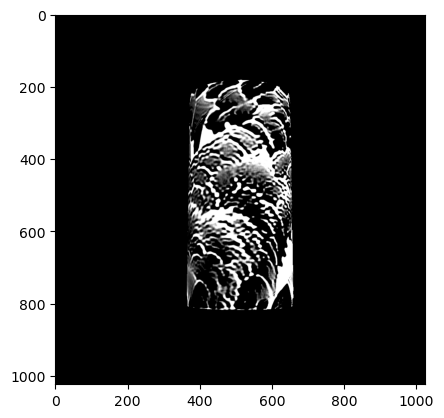

idx 266000 - img_loss: 0.34614065289497375, adv_loss 1.0896632671356201, grad norm 21.82451057434082, lpips_loss 0
idx 266000 - img_loss: 0.34614065289497375, adv_loss 1.0896632671356201, grad norm 21.82451057434082, lpips_loss 0
black swan: 33.6%
table lamp: 18.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpa1c2rx03, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpesm8eed4, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


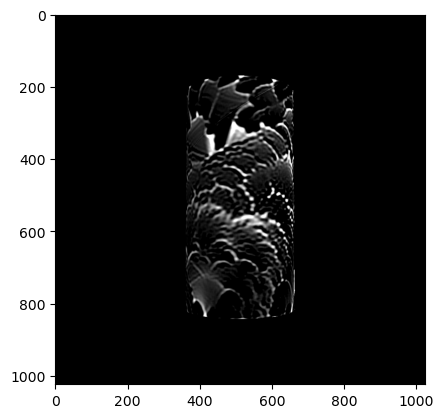

idx 267000 - img_loss: 0.31542742252349854, adv_loss 0.16571207344532013, grad norm 0.724456787109375, lpips_loss 0


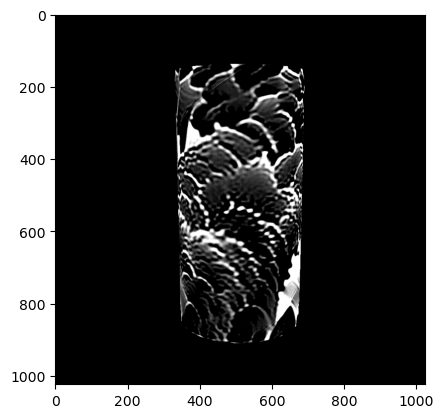

idx 268000 - img_loss: 0.48099613189697266, adv_loss 0.4512022137641907, grad norm 4.775362968444824, lpips_loss 0
idx 268000 - img_loss: 0.48099613189697266, adv_loss 0.4512022137641907, grad norm 4.775362968444824, lpips_loss 0
black swan: 86.6%
cup: 8.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpl3pidpq0, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpzx2qh8d0, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


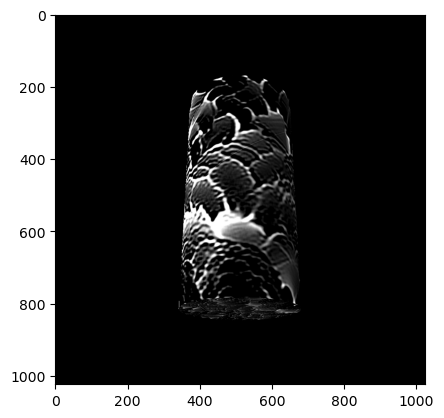

idx 269000 - img_loss: 0.3567901849746704, adv_loss 0.3644070327281952, grad norm 1.0267294645309448, lpips_loss 0


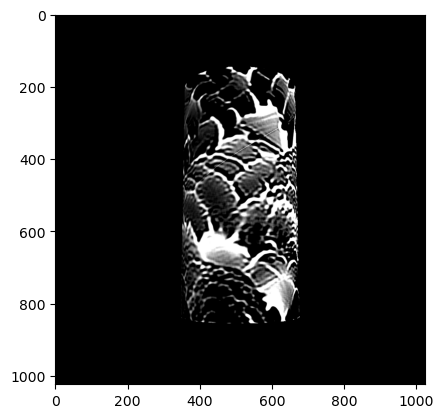

idx 270000 - img_loss: 0.4378019869327545, adv_loss 0.3492967486381531, grad norm 1.4383583068847656, lpips_loss 0
idx 270000 - img_loss: 0.4378019869327545, adv_loss 0.3492967486381531, grad norm 1.4383583068847656, lpips_loss 0
black swan: 78.5%
lampshade: 19.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpl3ej8bop, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpbv66ou_9, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


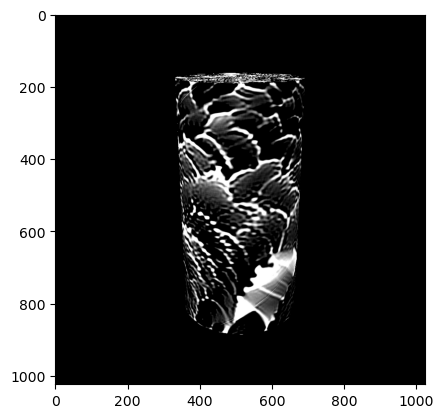

idx 271000 - img_loss: 0.4873175323009491, adv_loss 0.26091450452804565, grad norm 0.7819088101387024, lpips_loss 0


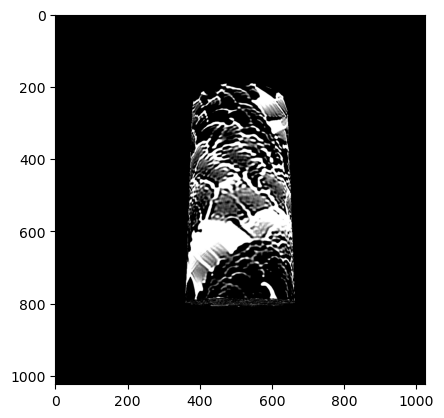

idx 272000 - img_loss: 0.33033713698387146, adv_loss 0.34501445293426514, grad norm 1.6677683591842651, lpips_loss 0
idx 272000 - img_loss: 0.33033713698387146, adv_loss 0.34501445293426514, grad norm 1.6677683591842651, lpips_loss 0
black swan: 82.9%
lampshade: 32.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnbwqz712, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpl12tfprv, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


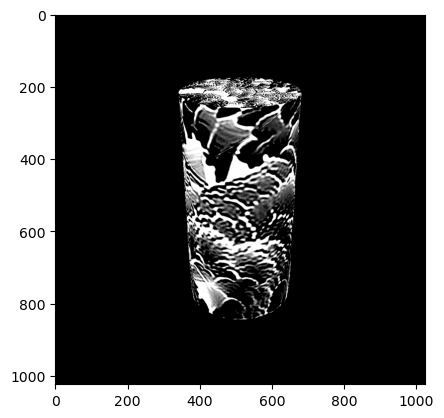

idx 273000 - img_loss: 0.38565802574157715, adv_loss 0.37812647223472595, grad norm 1.5144391059875488, lpips_loss 0


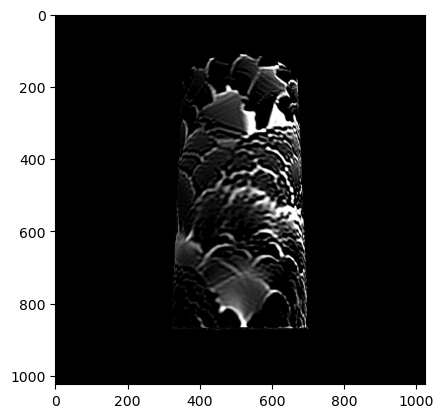

idx 274000 - img_loss: 0.3180379867553711, adv_loss 0.13086625933647156, grad norm 0.7099926471710205, lpips_loss 0
idx 274000 - img_loss: 0.3180379867553711, adv_loss 0.13086625933647156, grad norm 0.7099926471710205, lpips_loss 0
black swan: 93.9%
lampshade: 49.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpdkz77t8o, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpfg0k06a_, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


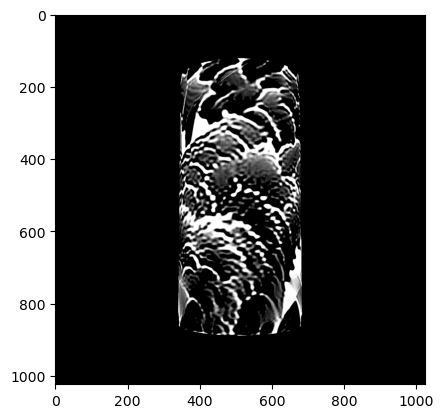

idx 275000 - img_loss: 0.4704788625240326, adv_loss 0.1711554378271103, grad norm 0.9505650997161865, lpips_loss 0


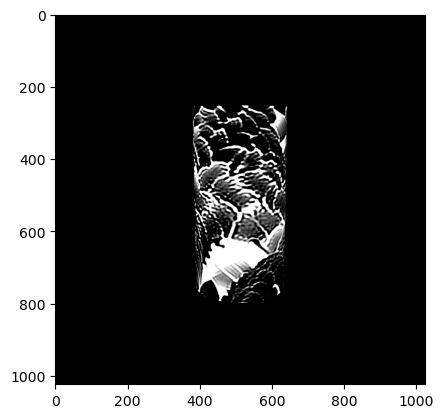

idx 276000 - img_loss: 0.37768563628196716, adv_loss 0.34733065962791443, grad norm 1.212827205657959, lpips_loss 0
idx 276000 - img_loss: 0.37768563628196716, adv_loss 0.34733065962791443, grad norm 1.212827205657959, lpips_loss 0
black swan: 78.3%
pill bottle: 8.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpoc8qyf6m, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpvta1vt4d, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


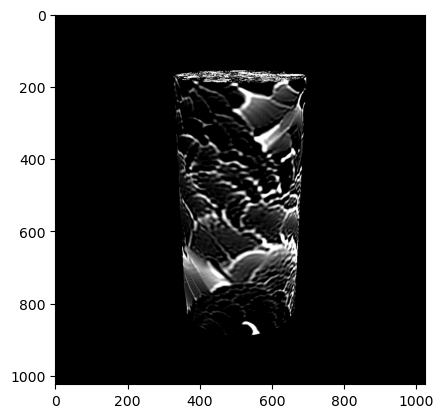

idx 277000 - img_loss: 0.3378361165523529, adv_loss 0.5862679481506348, grad norm 4.531462669372559, lpips_loss 0


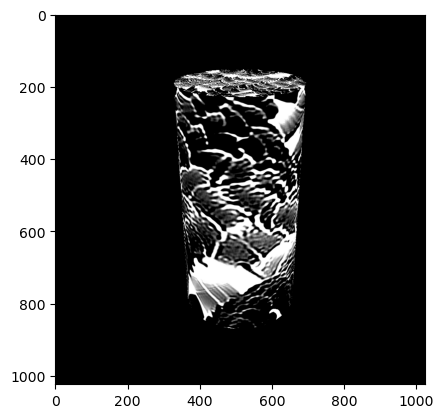

idx 278000 - img_loss: 0.39445725083351135, adv_loss 0.7448902130126953, grad norm 7.781261920928955, lpips_loss 0
idx 278000 - img_loss: 0.39445725083351135, adv_loss 0.7448902130126953, grad norm 7.781261920928955, lpips_loss 0
black swan: 72.8%
lampshade: 12.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpq_fo43bi, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpi691_yh5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


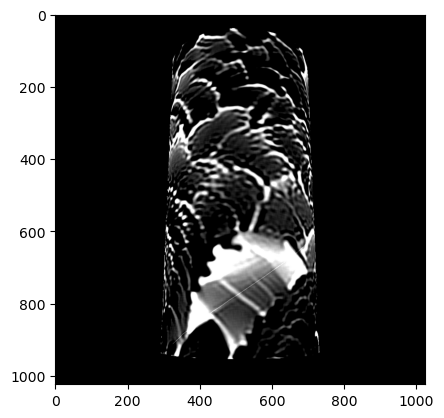

idx 279000 - img_loss: 0.4136294722557068, adv_loss 0.027602756395936012, grad norm 0.3987080156803131, lpips_loss 0


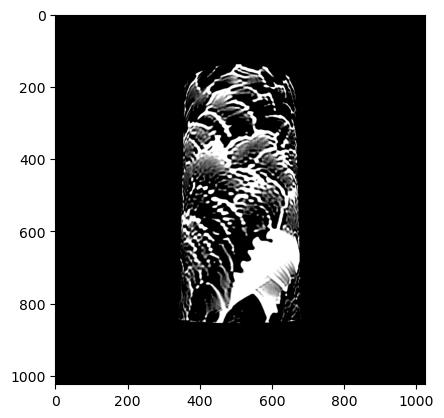

idx 280000 - img_loss: 0.33895963430404663, adv_loss 0.1345631331205368, grad norm 1.3847600221633911, lpips_loss 0
idx 280000 - img_loss: 0.33895963430404663, adv_loss 0.1345631331205368, grad norm 1.3847600221633911, lpips_loss 0
black swan: 80.4%
lampshade: 25.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpzl_hk3ww, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpvmw8pm94, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


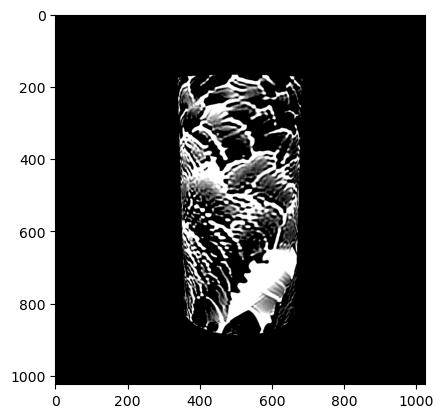

idx 281000 - img_loss: 0.32100704312324524, adv_loss 0.7275862693786621, grad norm 10.027440071105957, lpips_loss 0


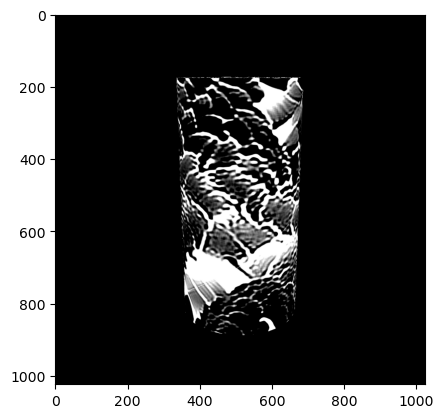

idx 282000 - img_loss: 0.3652936518192291, adv_loss 0.2418309599161148, grad norm 1.6455533504486084, lpips_loss 0
idx 282000 - img_loss: 0.3652936518192291, adv_loss 0.2418309599161148, grad norm 1.6455533504486084, lpips_loss 0
black swan: 92.6%
vase: 5.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpt_nw2vfj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmps0g9al1m, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


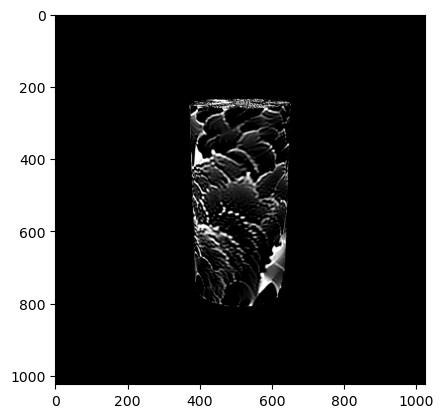

idx 283000 - img_loss: 0.3446284532546997, adv_loss 0.36023586988449097, grad norm 0.5560334324836731, lpips_loss 0


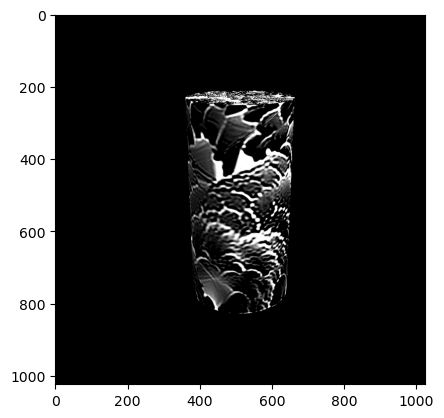

idx 284000 - img_loss: 0.4180261492729187, adv_loss 0.3926113247871399, grad norm 1.2326136827468872, lpips_loss 0
idx 284000 - img_loss: 0.4180261492729187, adv_loss 0.3926113247871399, grad norm 1.2326136827468872, lpips_loss 0
black swan: 81.3%
coffee mug: 16.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnhgyhdtz, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnn_nm5rs, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


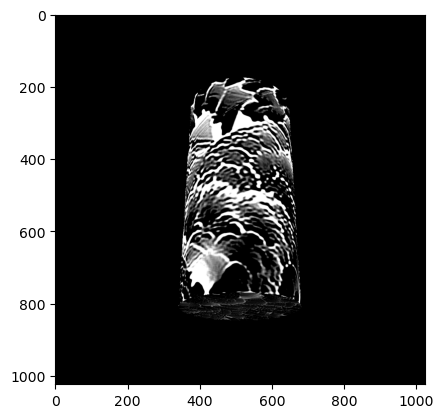

idx 285000 - img_loss: 0.38434410095214844, adv_loss 0.1888038069009781, grad norm 0.8218175172805786, lpips_loss 0


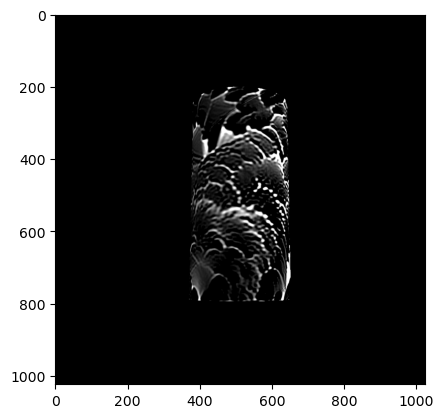

idx 286000 - img_loss: 0.3728928864002228, adv_loss 0.4461953938007355, grad norm 1.5146318674087524, lpips_loss 0
idx 286000 - img_loss: 0.3728928864002228, adv_loss 0.4461953938007355, grad norm 1.5146318674087524, lpips_loss 0
black swan: 82.6%
lampshade: 41.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpqtlxof5y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp4d52pr8u, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


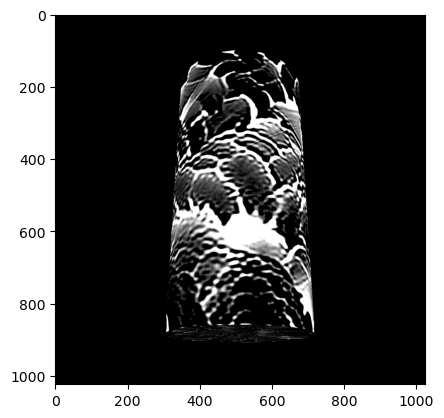

idx 287000 - img_loss: 0.4334276020526886, adv_loss 0.2954694330692291, grad norm 1.4270659685134888, lpips_loss 0


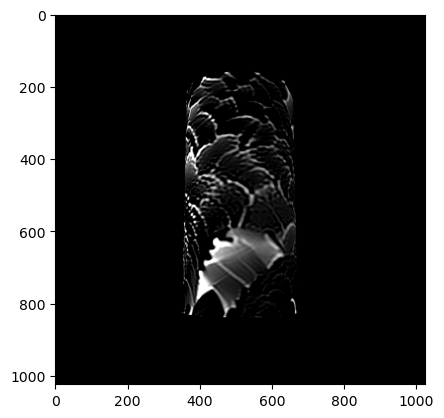

idx 288000 - img_loss: 0.23735006153583527, adv_loss 0.13819479942321777, grad norm 0.9559420347213745, lpips_loss 0
idx 288000 - img_loss: 0.23735006153583527, adv_loss 0.13819479942321777, grad norm 0.9559420347213745, lpips_loss 0
black swan: 87.1%
lampshade: 37.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpip_1x3c1, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpqi3vkt_7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


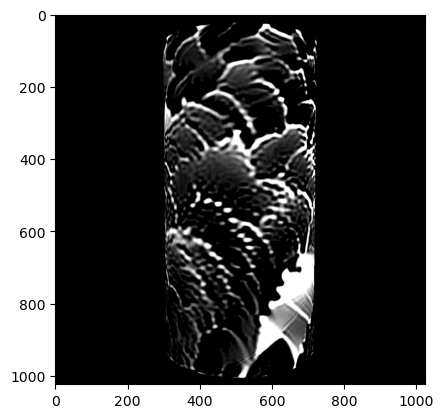

idx 289000 - img_loss: 0.4378200173377991, adv_loss 0.08695337921380997, grad norm 1.2374404668807983, lpips_loss 0


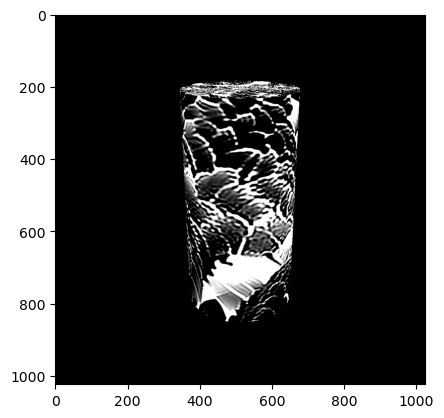

idx 290000 - img_loss: 0.3612572252750397, adv_loss 0.2757125496864319, grad norm 1.0080410242080688, lpips_loss 0
idx 290000 - img_loss: 0.3612572252750397, adv_loss 0.2757125496864319, grad norm 1.0080410242080688, lpips_loss 0
black swan: 71.2%
lampshade: 9.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpxro5k3e8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpef1k1mff, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


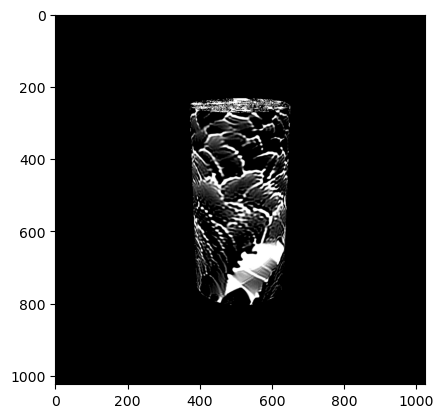

idx 291000 - img_loss: 0.4786282777786255, adv_loss 0.4209287762641907, grad norm 1.1672910451889038, lpips_loss 0
nan found in prediction


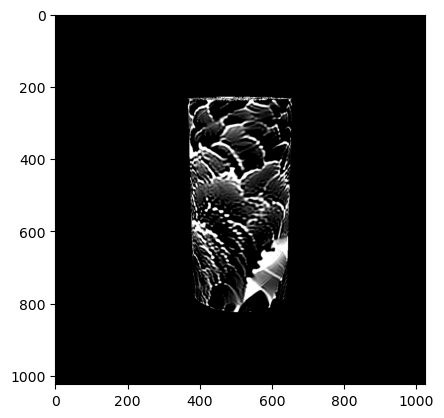

idx 292000 - img_loss: 0.48842546343803406, adv_loss 0.5678603053092957, grad norm 5.253617763519287, lpips_loss 0
idx 292000 - img_loss: 0.48842546343803406, adv_loss 0.5678603053092957, grad norm 5.253617763519287, lpips_loss 0
black swan: 86.8%
cup: 8.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpap81bid6, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpd1lj10_w, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


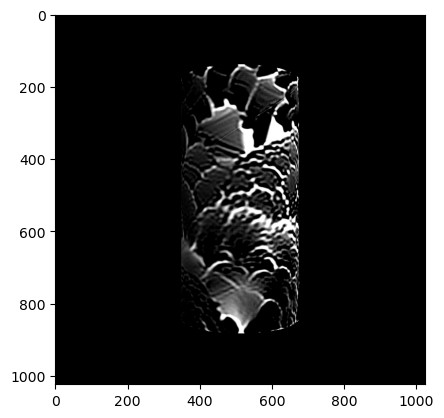

idx 293000 - img_loss: 0.39526763558387756, adv_loss 0.17328345775604248, grad norm 2.1705780029296875, lpips_loss 0


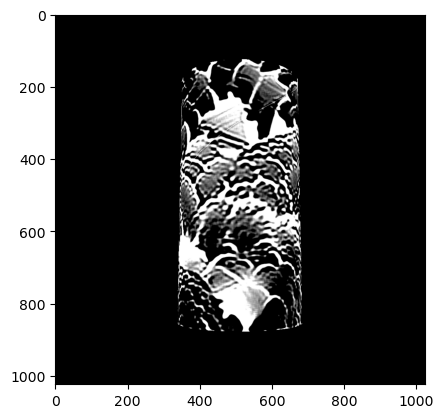

idx 294000 - img_loss: 0.32479485869407654, adv_loss 0.16710346937179565, grad norm 2.2288029193878174, lpips_loss 0
idx 294000 - img_loss: 0.32479485869407654, adv_loss 0.16710346937179565, grad norm 2.2288029193878174, lpips_loss 0
black swan: 91.5%
lampshade: 26.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_xv6uvga, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_uu_ikjq, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


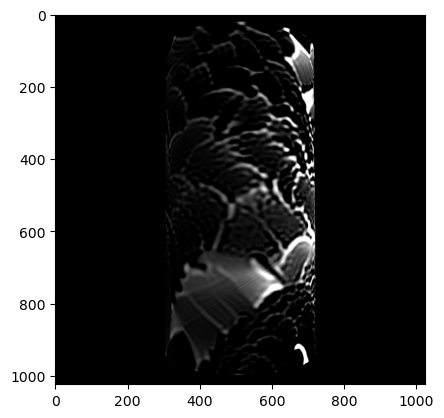

idx 295000 - img_loss: 0.1848570704460144, adv_loss 0.03118344582617283, grad norm 0.2752203345298767, lpips_loss 0


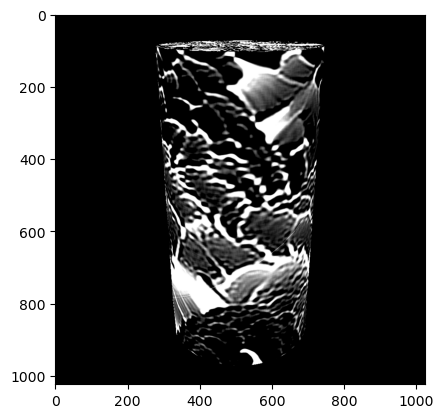

idx 296000 - img_loss: 0.4817309081554413, adv_loss 0.09888236969709396, grad norm 2.9581446647644043, lpips_loss 0
idx 296000 - img_loss: 0.4817309081554413, adv_loss 0.09888236969709396, grad norm 2.9581446647644043, lpips_loss 0
black swan: 90.6%
vase: 10.8%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp6s8cujm3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmppnw8o87c, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


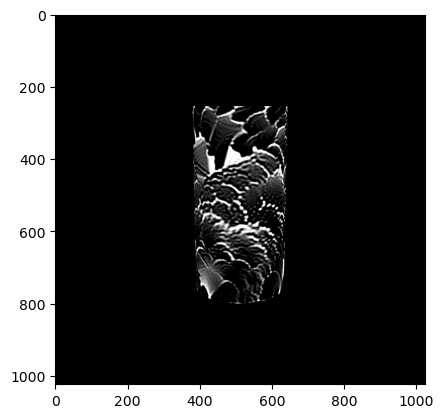

idx 297000 - img_loss: 0.4563368260860443, adv_loss 0.49501556158065796, grad norm 1.0931992530822754, lpips_loss 0
nan found in prediction


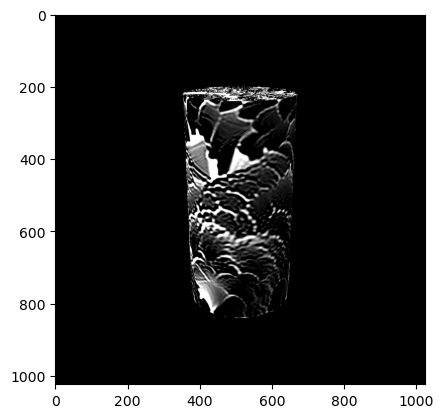

idx 298000 - img_loss: 0.37893447279930115, adv_loss 0.2640286386013031, grad norm 1.172371745109558, lpips_loss 0
idx 298000 - img_loss: 0.37893447279930115, adv_loss 0.2640286386013031, grad norm 1.172371745109558, lpips_loss 0
black swan: 75.7%
cup: 24.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp2si4nzg4, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpp528gyzm, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


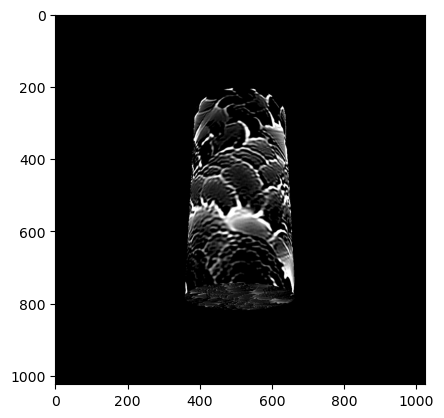

idx 299000 - img_loss: 0.37690165638923645, adv_loss 0.731635570526123, grad norm 1.488956332206726, lpips_loss 0


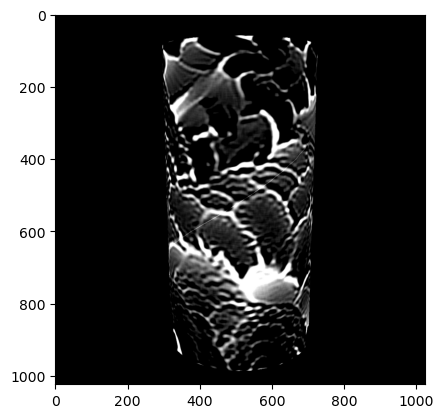

idx 300000 - img_loss: 0.45939305424690247, adv_loss 0.11550359427928925, grad norm 1.2547646760940552, lpips_loss 0
idx 300000 - img_loss: 0.45939305424690247, adv_loss 0.11550359427928925, grad norm 1.2547646760940552, lpips_loss 0
black swan: 91.2%
lampshade: 9.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpc0p_l273, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1pg_0u21, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


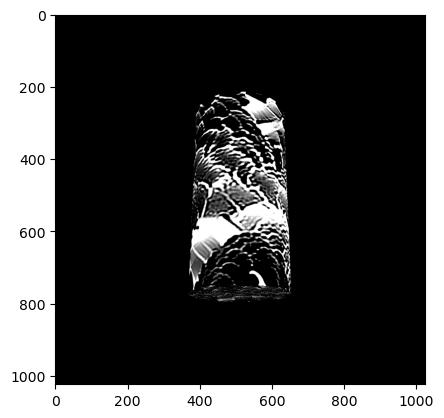

idx 301000 - img_loss: 0.3314908444881439, adv_loss 0.4097033739089966, grad norm 1.74167799949646, lpips_loss 0


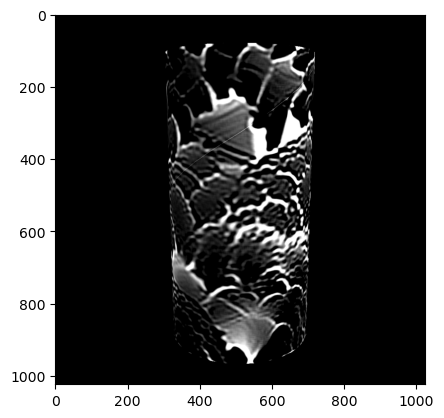

idx 302000 - img_loss: 0.42712095379829407, adv_loss 0.021097294986248016, grad norm 0.40908655524253845, lpips_loss 0
idx 302000 - img_loss: 0.42712095379829407, adv_loss 0.021097294986248016, grad norm 0.40908655524253845, lpips_loss 0
black swan: 97.9%
cup: 9.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpjv0mnsx5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpwwmadv5y, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


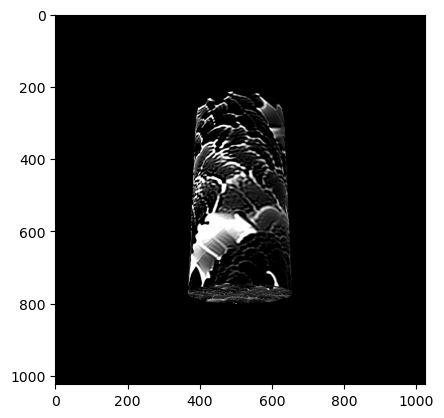

idx 303000 - img_loss: 0.33536699414253235, adv_loss 0.47331446409225464, grad norm 2.373195171356201, lpips_loss 0
nan found in prediction


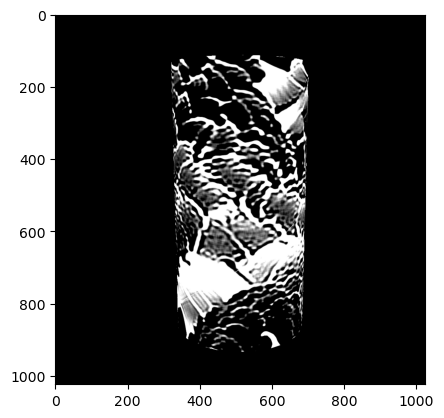

idx 304000 - img_loss: 0.30140718817710876, adv_loss 0.1846991777420044, grad norm 4.692434310913086, lpips_loss 0
idx 304000 - img_loss: 0.30140718817710876, adv_loss 0.1846991777420044, grad norm 4.692434310913086, lpips_loss 0
black swan: 91.5%
lampshade: 9.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpi9tvk7aw, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpke9idhna, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


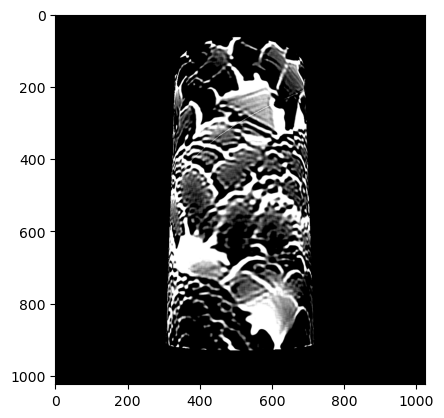

idx 305000 - img_loss: 0.39445236325263977, adv_loss 0.12971891462802887, grad norm 1.7062746286392212, lpips_loss 0


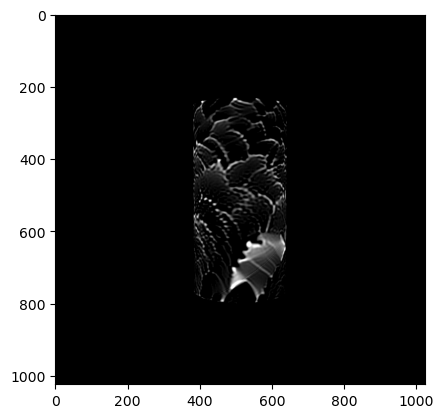

idx 306000 - img_loss: 0.2084456980228424, adv_loss 0.26921212673187256, grad norm 0.49001073837280273, lpips_loss 0
idx 306000 - img_loss: 0.2084456980228424, adv_loss 0.26921212673187256, grad norm 0.49001073837280273, lpips_loss 0
black swan: 76.4%
lampshade: 18.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpzpibcua3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpr6cspo5m, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


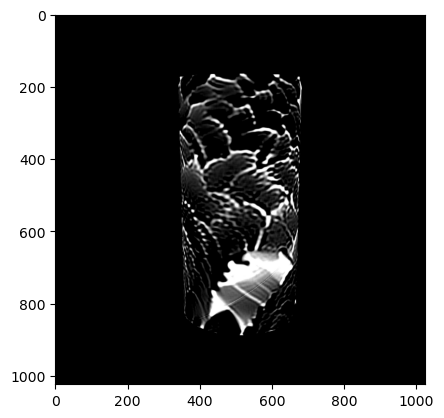

idx 307000 - img_loss: 0.3790026009082794, adv_loss 0.07204143702983856, grad norm 0.4580094814300537, lpips_loss 0


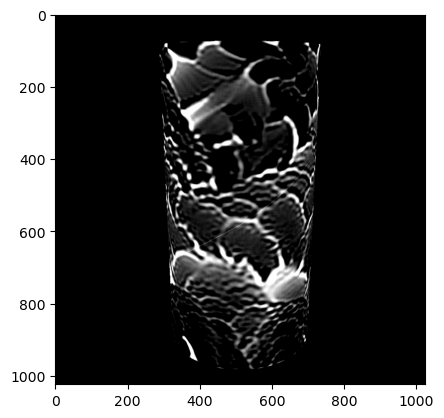

idx 308000 - img_loss: 0.3901565670967102, adv_loss 0.04966790974140167, grad norm 0.8555769324302673, lpips_loss 0
idx 308000 - img_loss: 0.3901565670967102, adv_loss 0.04966790974140167, grad norm 0.8555769324302673, lpips_loss 0
black swan: 95.2%
lampshade: 7.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp24btzbgf, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpco3mftis, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


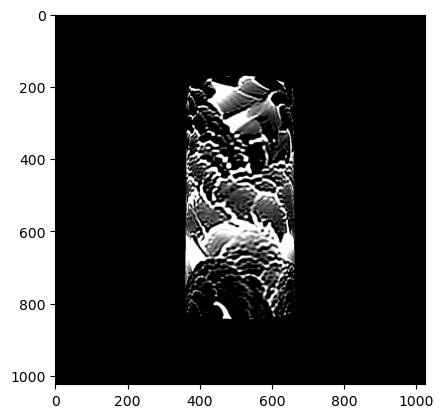

idx 309000 - img_loss: 0.4379881024360657, adv_loss 0.23723560571670532, grad norm 1.014536738395691, lpips_loss 0


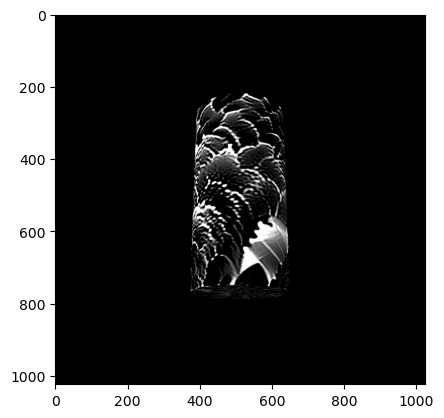

idx 310000 - img_loss: 0.4182618260383606, adv_loss 0.3478662967681885, grad norm 0.8020458817481995, lpips_loss 0
idx 310000 - img_loss: 0.4182618260383606, adv_loss 0.3478662967681885, grad norm 0.8020458817481995, lpips_loss 0
black swan: 75.7%
lampshade: 35.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmptvxc8nb5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpltpuptul, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


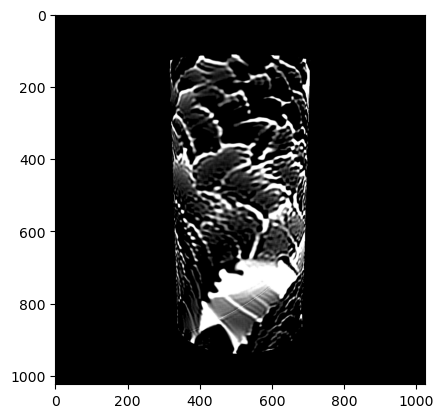

idx 311000 - img_loss: 0.44871774315834045, adv_loss 0.0708501935005188, grad norm 0.5350226759910583, lpips_loss 0


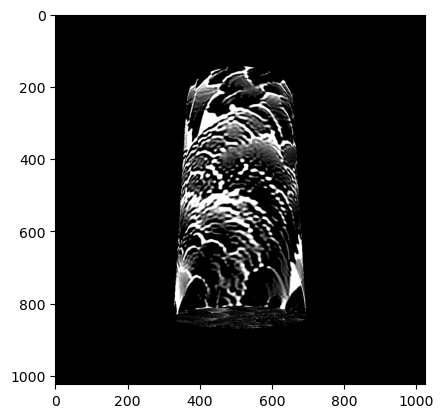

idx 312000 - img_loss: 0.4361283481121063, adv_loss 0.2127583771944046, grad norm 1.2890613079071045, lpips_loss 0
idx 312000 - img_loss: 0.4361283481121063, adv_loss 0.2127583771944046, grad norm 1.2890613079071045, lpips_loss 0
black swan: 81.4%
lampshade: 33.1%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmppin8sjv3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpen1vcqcg, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


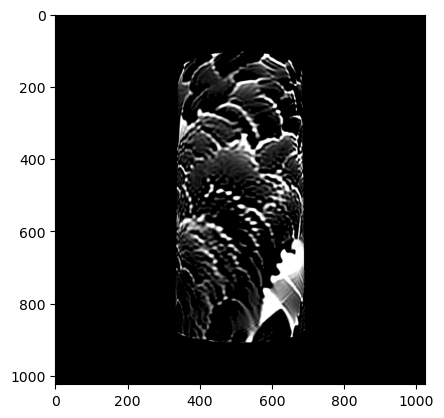

idx 313000 - img_loss: 0.42876583337783813, adv_loss 0.10102833062410355, grad norm 0.46396663784980774, lpips_loss 0


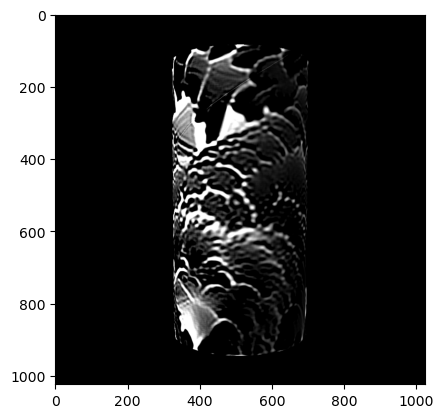

idx 314000 - img_loss: 0.35450154542922974, adv_loss 0.06913846731185913, grad norm 0.6560340523719788, lpips_loss 0
idx 314000 - img_loss: 0.35450154542922974, adv_loss 0.06913846731185913, grad norm 0.6560340523719788, lpips_loss 0
black swan: 93.7%
coffee mug: 7.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpv942s2bj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpsfycg7bm, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


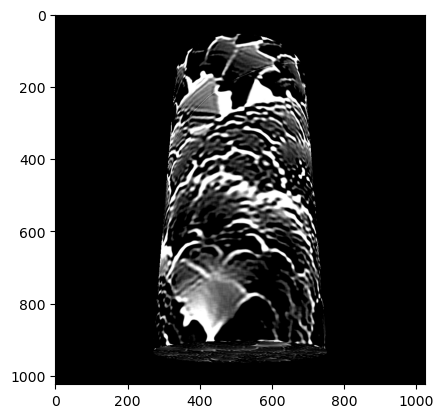

idx 315000 - img_loss: 0.49360135197639465, adv_loss 0.12464791536331177, grad norm 1.3277626037597656, lpips_loss 0


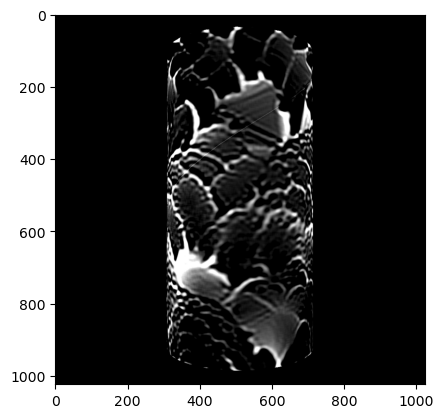

idx 316000 - img_loss: 0.3405308425426483, adv_loss 0.2895345091819763, grad norm 3.531259059906006, lpips_loss 0
idx 316000 - img_loss: 0.3405308425426483, adv_loss 0.2895345091819763, grad norm 3.531259059906006, lpips_loss 0
black swan: 97.4%
lighter: 13.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_rxm73ta, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpd6r8_zg5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


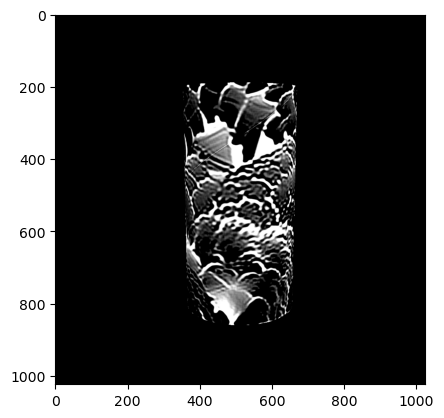

idx 317000 - img_loss: 0.4700373411178589, adv_loss 0.1958201378583908, grad norm 1.557342290878296, lpips_loss 0


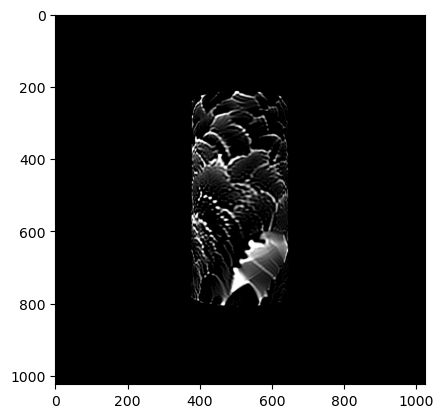

idx 318000 - img_loss: 0.32696932554244995, adv_loss 0.2275136411190033, grad norm 1.3978042602539062, lpips_loss 0
idx 318000 - img_loss: 0.32696932554244995, adv_loss 0.2275136411190033, grad norm 1.3978042602539062, lpips_loss 0
black swan: 79.7%
lampshade: 23.2%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnm5cwalk, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmppapn6i8r, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


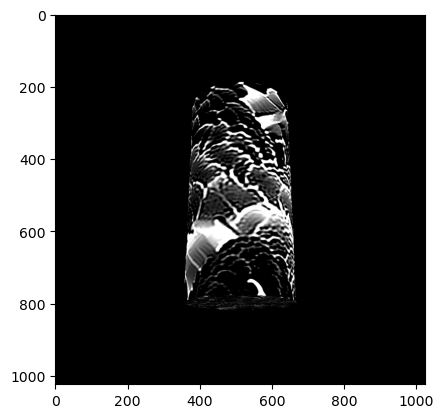

idx 319000 - img_loss: 0.40867072343826294, adv_loss 0.30064883828163147, grad norm 1.0196698904037476, lpips_loss 0


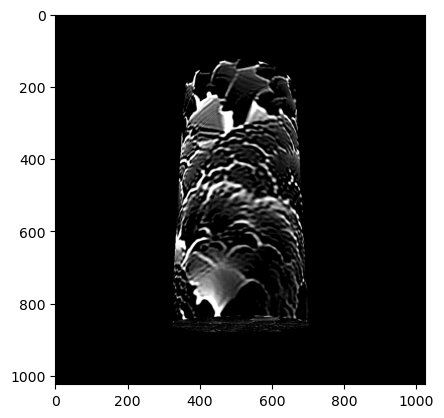

idx 320000 - img_loss: 0.3766748011112213, adv_loss 0.14034515619277954, grad norm 1.1879730224609375, lpips_loss 0
idx 320000 - img_loss: 0.3766748011112213, adv_loss 0.14034515619277954, grad norm 1.1879730224609375, lpips_loss 0
black swan: 93.7%
lampshade: 25.0%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpgczqrt_n, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_5qmonh7, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


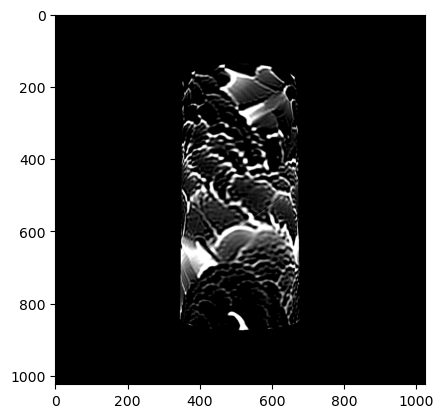

idx 321000 - img_loss: 0.411977082490921, adv_loss 0.1822858303785324, grad norm 0.7576676607131958, lpips_loss 0


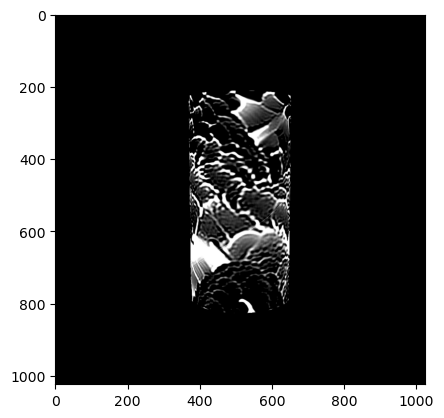

idx 322000 - img_loss: 0.47064581513404846, adv_loss 0.2514888048171997, grad norm 0.6791062951087952, lpips_loss 0
idx 322000 - img_loss: 0.47064581513404846, adv_loss 0.2514888048171997, grad norm 0.6791062951087952, lpips_loss 0
black swan: 80.3%
lampshade: 9.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp31o9u65d, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpi9q_x8oa, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


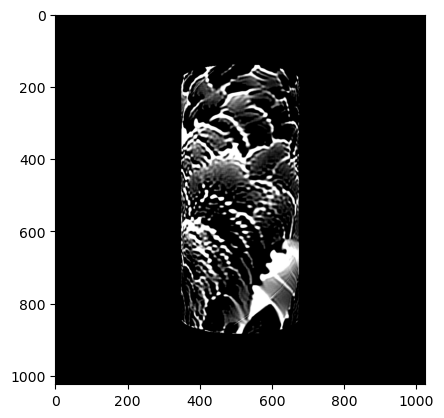

idx 323000 - img_loss: 0.46731042861938477, adv_loss 0.0997965857386589, grad norm 0.9740511178970337, lpips_loss 0
nan found in prediction


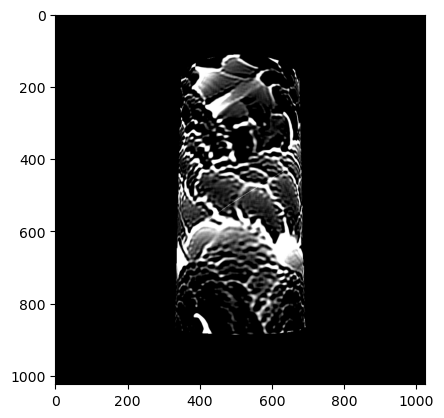

idx 324000 - img_loss: 0.5284207463264465, adv_loss 0.2365916520357132, grad norm 1.2939389944076538, lpips_loss 0
idx 324000 - img_loss: 0.5284207463264465, adv_loss 0.2365916520357132, grad norm 1.2939389944076538, lpips_loss 0
black swan: 90.2%
table lamp: 19.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpi903kh_z, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpmu9x6eio, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


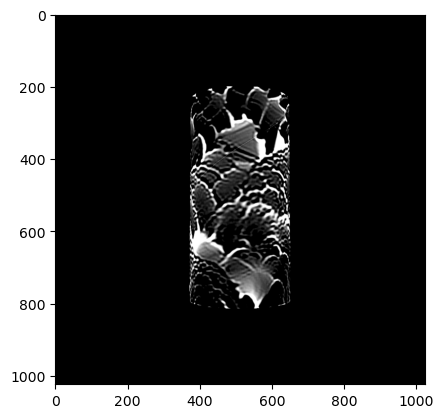

idx 325000 - img_loss: 0.4396323561668396, adv_loss 0.25979629158973694, grad norm 1.1829239130020142, lpips_loss 0
nan found in prediction


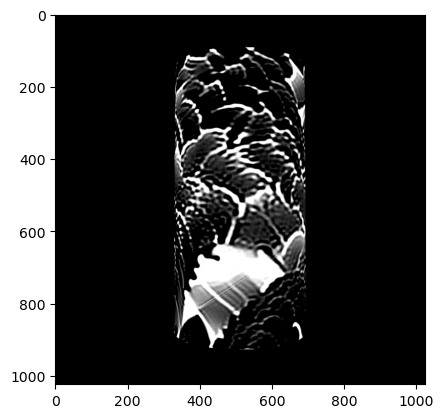

idx 326000 - img_loss: 0.46557772159576416, adv_loss 0.024549296125769615, grad norm 0.39534369111061096, lpips_loss 0
idx 326000 - img_loss: 0.46557772159576416, adv_loss 0.024549296125769615, grad norm 0.39534369111061096, lpips_loss 0
black swan: 97.6%
paper towel: 7.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpaomhcd_h, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp35loiwoj, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


nan found in prediction


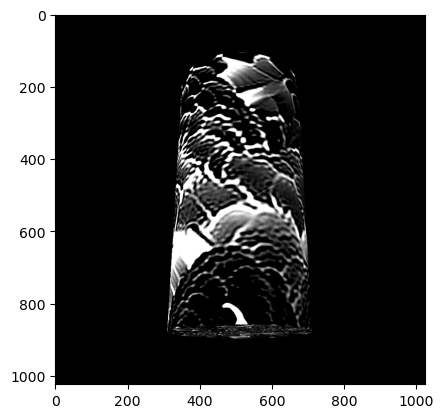

idx 327000 - img_loss: 0.4272293150424957, adv_loss 0.40605732798576355, grad norm 2.686913251876831, lpips_loss 0


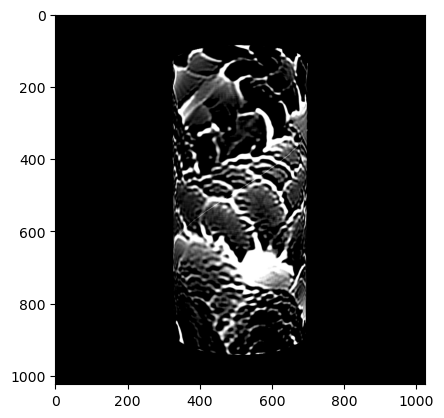

idx 328000 - img_loss: 0.4789402186870575, adv_loss 0.25293827056884766, grad norm 1.3709467649459839, lpips_loss 0
idx 328000 - img_loss: 0.4789402186870575, adv_loss 0.25293827056884766, grad norm 1.3709467649459839, lpips_loss 0
black swan: 89.5%
lampshade: 7.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpz50qrpz3, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpfkxc1v4t, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


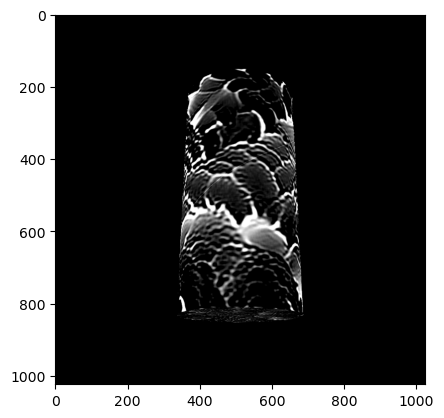

idx 329000 - img_loss: 0.4231700003147125, adv_loss 0.37899962067604065, grad norm 1.33695387840271, lpips_loss 0


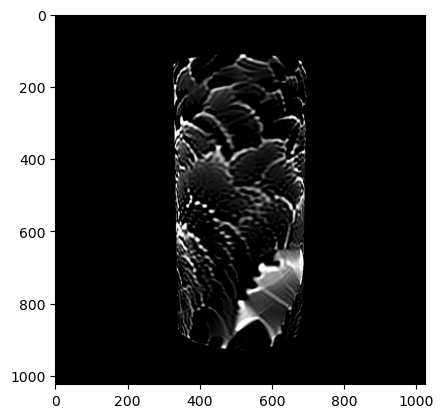

idx 330000 - img_loss: 0.28874629735946655, adv_loss 0.15038612484931946, grad norm 0.6871187090873718, lpips_loss 0
idx 330000 - img_loss: 0.28874629735946655, adv_loss 0.15038612484931946, grad norm 0.6871187090873718, lpips_loss 0
black swan: 87.8%
lampshade: 5.3%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmps9pdntdl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8_00vs44, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


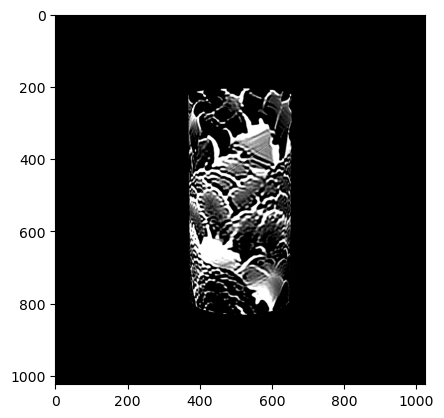

idx 331000 - img_loss: 0.4064098298549652, adv_loss 0.350564569234848, grad norm 1.1873579025268555, lpips_loss 0


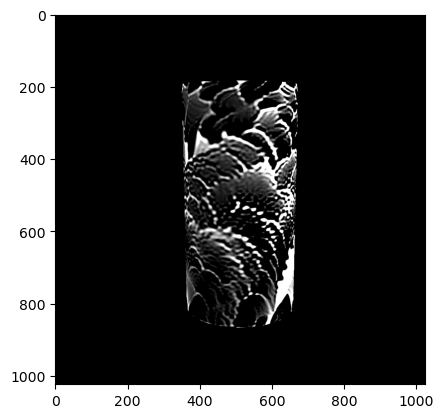

idx 332000 - img_loss: 0.400417298078537, adv_loss 0.33597517013549805, grad norm 4.257251739501953, lpips_loss 0
idx 332000 - img_loss: 0.400417298078537, adv_loss 0.33597517013549805, grad norm 4.257251739501953, lpips_loss 0
black swan: 71.5%
lampshade: 7.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpnr3vg7r6, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp_oi5rwcq, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


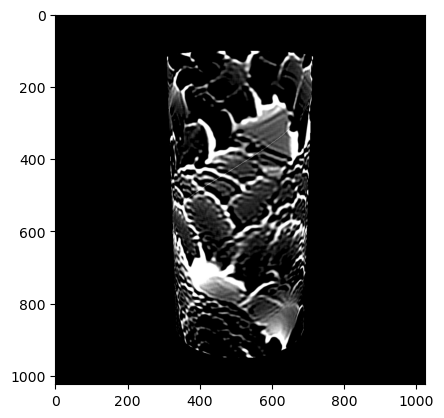

idx 333000 - img_loss: 0.49026331305503845, adv_loss 0.08269337564706802, grad norm 0.8221956491470337, lpips_loss 0


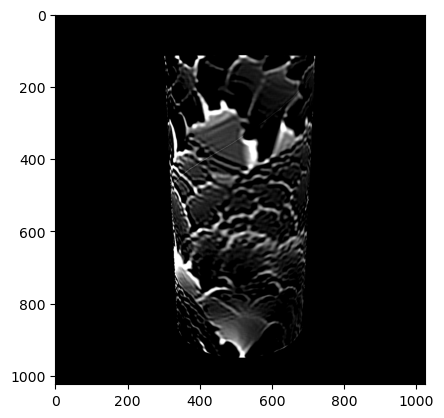

idx 334000 - img_loss: 0.2921425402164459, adv_loss 0.0510123185813427, grad norm 0.574192464351654, lpips_loss 0
idx 334000 - img_loss: 0.2921425402164459, adv_loss 0.0510123185813427, grad norm 0.574192464351654, lpips_loss 0
black swan: 94.1%
vase: 7.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpf2_8nw3z, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp4r77vh9r, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


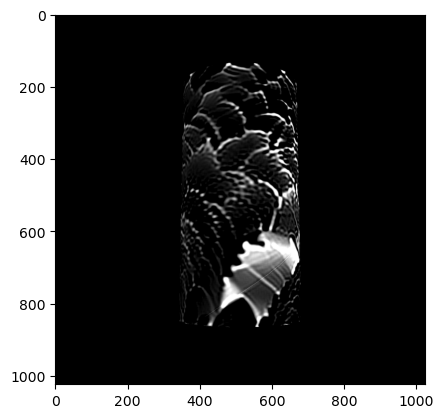

idx 335000 - img_loss: 0.2831983268260956, adv_loss 0.2609409689903259, grad norm 1.7461522817611694, lpips_loss 0


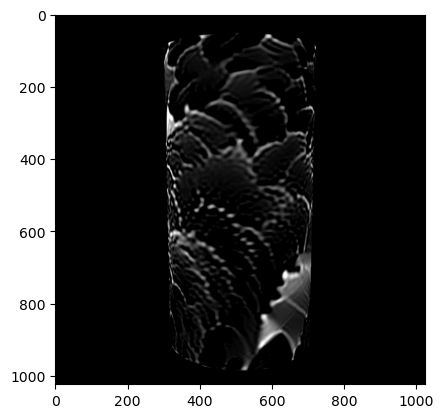

idx 336000 - img_loss: 0.17638984322547913, adv_loss 0.07154526561498642, grad norm 0.5677480101585388, lpips_loss 0
idx 336000 - img_loss: 0.17638984322547913, adv_loss 0.07154526561498642, grad norm 0.5677480101585388, lpips_loss 0
black swan: 93.1%
ashcan: 7.6%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp3m3nfzfp, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpic3yzo4f, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


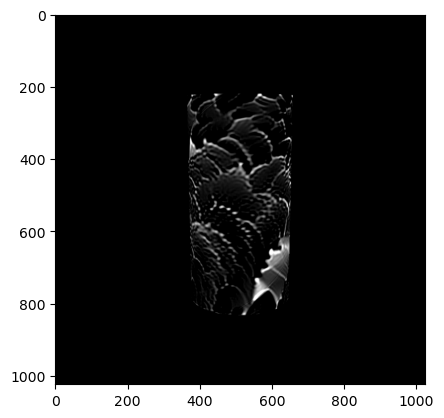

idx 337000 - img_loss: 0.21302616596221924, adv_loss 0.6575042009353638, grad norm 1.517864465713501, lpips_loss 0


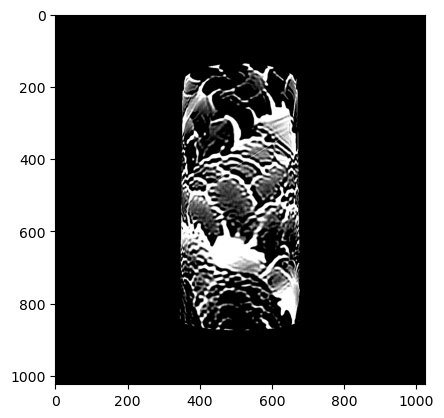

idx 338000 - img_loss: 0.3818918764591217, adv_loss 0.14435604214668274, grad norm 2.6229941844940186, lpips_loss 0
idx 338000 - img_loss: 0.3818918764591217, adv_loss 0.14435604214668274, grad norm 2.6229941844940186, lpips_loss 0
black swan: 86.6%
lampshade: 20.5%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpway30udv, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpm5sv4ttw, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


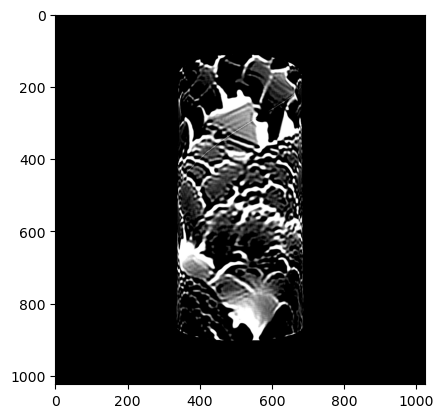

idx 339000 - img_loss: 0.4836614429950714, adv_loss 0.02142195962369442, grad norm 0.3782438039779663, lpips_loss 0
nan found in prediction


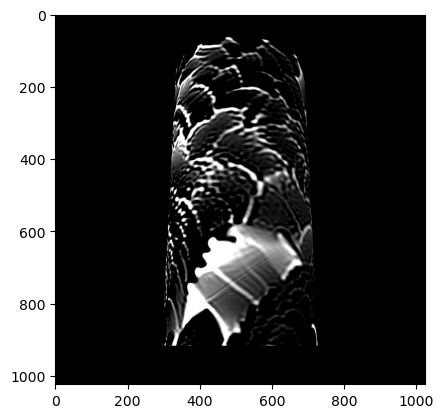

idx 340000 - img_loss: 0.3459206223487854, adv_loss 0.10974930971860886, grad norm 1.249997854232788, lpips_loss 0
idx 340000 - img_loss: 0.3459206223487854, adv_loss 0.10974930971860886, grad norm 1.249997854232788, lpips_loss 0
black swan: 96.1%
lampshade: 24.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp5rcmd_ee, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpwmgl8anl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


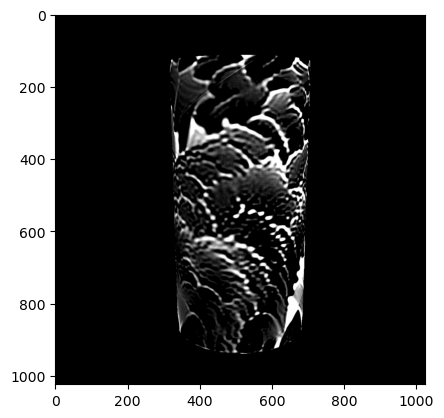

idx 341000 - img_loss: 0.43341726064682007, adv_loss 0.1287575662136078, grad norm 0.7203919291496277, lpips_loss 0


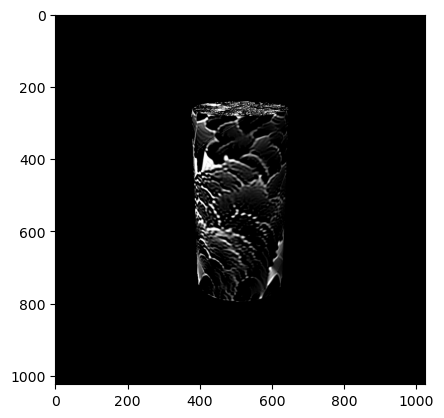

idx 342000 - img_loss: 0.30424121022224426, adv_loss 0.5397613644599915, grad norm 1.0096442699432373, lpips_loss 0
idx 342000 - img_loss: 0.30424121022224426, adv_loss 0.5397613644599915, grad norm 1.0096442699432373, lpips_loss 0
black swan: 68.2%
coffee mug: 24.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp1nt8rlra, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmprzmsn1pl, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


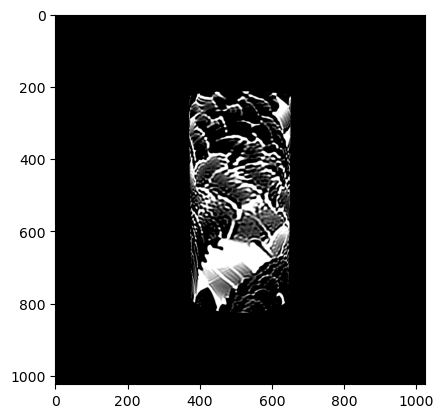

idx 343000 - img_loss: 0.3991912603378296, adv_loss 0.3706431984901428, grad norm 1.3390806913375854, lpips_loss 0


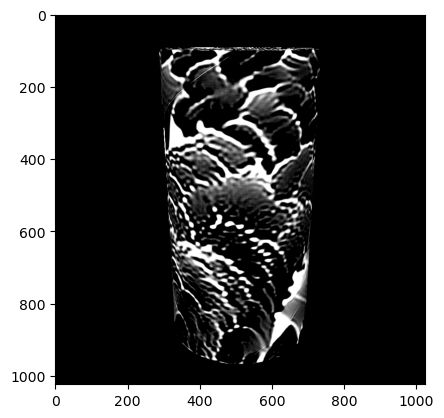

idx 344000 - img_loss: 0.4973527193069458, adv_loss 0.1277523785829544, grad norm 0.8858053684234619, lpips_loss 0
idx 344000 - img_loss: 0.4973527193069458, adv_loss 0.1277523785829544, grad norm 0.8858053684234619, lpips_loss 0
black swan: 93.6%
vase: 8.4%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpoyu2lyp8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmp8ot2vs8u, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


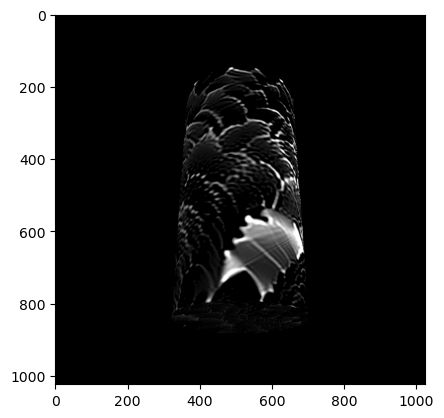

idx 345000 - img_loss: 0.20372720062732697, adv_loss 0.3813367187976837, grad norm 1.2601301670074463, lpips_loss 0


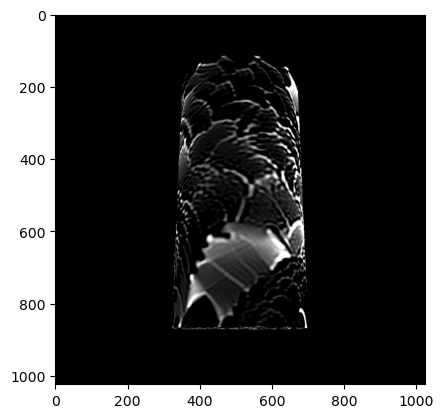

idx 346000 - img_loss: 0.22686919569969177, adv_loss 0.1718064844608307, grad norm 1.597320795059204, lpips_loss 0
idx 346000 - img_loss: 0.22686919569969177, adv_loss 0.1718064844608307, grad norm 1.597320795059204, lpips_loss 0
black swan: 90.8%
lampshade: 32.9%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpcw0rdr2b, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpskxr7eq5, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


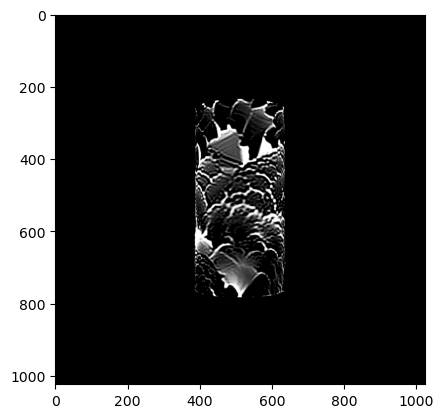

idx 347000 - img_loss: 0.44669240713119507, adv_loss 0.40663862228393555, grad norm 2.453270673751831, lpips_loss 0


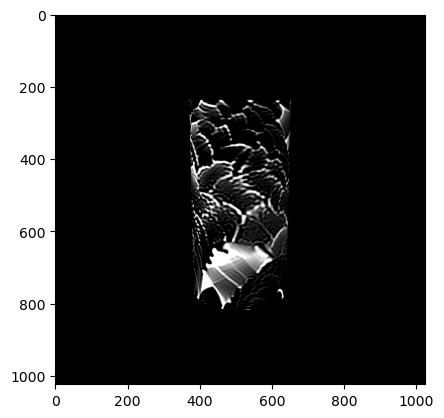

idx 348000 - img_loss: 0.35937368869781494, adv_loss 0.3893182575702667, grad norm 1.5969674587249756, lpips_loss 0
idx 348000 - img_loss: 0.35937368869781494, adv_loss 0.3893182575702667, grad norm 1.5969674587249756, lpips_loss 0
black swan: 82.2%
cup: 7.7%


COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpvjlloms8, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4
COMET ERROR: File upload failed: ValueError('Uploading file failed (429) with max retries: 4 on url \'https://www.comet.com/clientlib/asset/upload\': b\'{"msg":"Experiment has reached maximum number of asset type model-element","code":429,"data":null,"sdk_error_code":7000014}\''), file: /tmp/tmp3qv52w71/tmpy1gdzxvy, url: 'https://www.comet.com/clientlib/asset/upload', max retries: 4


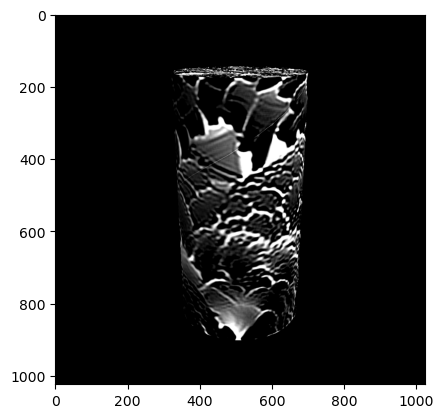

idx 349000 - img_loss: 0.4154311716556549, adv_loss 0.16354328393936157, grad norm 3.8761425018310547, lpips_loss 0


COMET WARNING: To get all data logged automatically, import comet_ml before the following modules: torch.
COMET INFO: Uploading 2 metrics, params and output messages


ExperimentCleaningException: Failed to successfully send all of the experiment's artifact or model assets. See logs for details.

In [205]:
from comet_ml.integration.pytorch import log_model
import tqdm

start_time = str(datetime.now()).split('.')[0]

USE_LPIPS = False
lpips_lambda = 100
adv_lambda = 300

effective_batch_size = 1

sds_steps = 0
augment_prob = 0.9
sds_grad = 0
sds_grad_norm = 0

print(f'exeriment time {start_time}')
experiment = comet_ml.Experiment(display_summary_level=0, log_code=True)


exp_name = f'{sds_steps}_sds_bs_{effective_batch_size}_l2_blswn_photo_augmentations_cylender'

complete_name = exp_name+'_'+start_time

experiment.set_name(complete_name)
experiment.log_code()
experiment.end()

experiment = comet_ml.ExistingExperiment(display_summary_level=0, previous_experiment=experiment.get_key())



# log kernel_size and sigma as hyper param to comet

import os

watch(SN)


experiment.log_parameters({"kernel_size": kernel_size, "sigma": sigma,
                           "num_noises": num_noises, "effective_batch_size":effective_batch_size, "sds_steps": sds_steps, "augment_prob":augment_prob})


experiment.log_parameters({"lpips_lambda": lpips_lambda})
scaler = torch.cuda.amp.GradScaler()

try:
  for idx in tqdm.tqdm_notebook(range(350000)):
          

          texture_noise_optim.zero_grad()

          (camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.5, 2.5], phi_range=[0, 10], theta_range=[ 3.141 / 2 - 0.5 ,3.142 /2 + 0.5])
          lighting, _ = random_light(strength_range=[16,30],suns_range=[3,7])
          lighting = lighting.cuda()
          gt_image = render(camera, orig_mesh.cuda(), lighting)
          
          prediction_aug = None

          ### Render
          #is it the same as comparing the textures directly ?





          mesh.materials[0].diffuse_texture = SN(orig_mesh.materials[0].diffuse_texture.T).T

          image = render(camera, mesh.cuda(), lighting)


          zero_mask = image != 0
          img_loss = torch.mean(torch.abs((image - gt_image)[zero_mask]))


          augment_choise = torch.rand(1)
          if augment_choise < augment_prob:
              image_aug = effect(image)
              prediction_aug = resnet_predict_raw(image_aug)


          prediction = resnet_predict_raw(image)

          ## nan handle
          if torch.sum(prediction != prediction) != 0:
            print('nan found in prediction')
            continue

          # print(prediction.argmax(1))
          aug_pred_loss = 0
          if adv_direction:
            adv_loss =  critereon(prediction, directed_class)
            if prediction_aug is not None:
                aug_pred_loss = critereon(prediction_aug, directed_class)
                adv_loss = aug_pred_loss #+ adv_loss
          else:
            p = prediction.squeeze(0).softmax(0)
            adv_loss = torch.stack([p[c.item()] for c in orig_clases]).max()
            if prediction_aug is not None:
                p_aug = prediction_aug.squeeze(0).softmax(0)
                aug_pred_loss = torch.stack([p_aug[c.item()] for c in orig_clases]).max()
                adv_loss = adv_loss + aug_pred_loss
            # adv_loss = sum([prediction[c] for c in orig_clases]) #-1 * sum([critereon(prediction, c)  for c in orig_clases])


          ### Compute Losses ###


          if USE_LPIPS:
            lpips_loss = loss_fn_vgg(image.permute(2,1,0), gt_image.permute(2,1,0), normalize=True).mean()
          else:
            lpips_loss = 0


          if img_loss > 88888 :
            effective_adv_lambda = 0
          else:
            effective_adv_lambda = adv_lambda

          total_loss =  lpips_loss*lpips_lambda + adv_loss*effective_adv_lambda + img_loss 

          if torch.sum(total_loss != total_loss) != 0:
            raise
          ### Update the mesh ###
          total_loss.backward()
          # print(torch.stack([x.grad.sum() for x in list(SN.parameters())]))
          # vertices_optim.step()
          grad_norm =  SN.noise_parameter.grad.norm()

          if grad_norm != grad_norm:
            print('grad norm is nan')
            texture_noise_optim.zero_grad()
            continue

          texture_noise_optim.step()


          for i in range(sds_steps):

                  texture_noise_optim.zero_grad()

                  mesh.materials[0].diffuse_texture = SN(orig_mesh.materials[0].diffuse_texture.T).T

                  image = render(camera, mesh.cuda(), lighting)

                  with torch.autocast(device_type=device, dtype=torch.float16):

                    grad = sd.train_step(text_embed, image.permute(2,0,1).unsqueeze(0))

                    sds_grad_norm = grad.norm()

                    # sds_grad += grad / sds_steps
                    if sds_grad_norm != sds_grad_norm:
                      print('sds nan')
                      continue

                    texture_noise_optim.step()
                    # scaler.step(texture_noise_optim)
                    # scaler.update()
                  

          # if idx % effective_batch_size == 0:
          #       if grad_norm != grad_norm:
          #         print('grad norm is nan')
          #         texture_noise_optim.zero_grad()
          #         continue
          #       texture_noise_optim.step()
          #       texture_noise_optim.zero_grad()
                # if sds_steps > 0:
                #   sds_grad_norm = sds_grad.norm()
                # sds_grad = 0



          # texture_noise_optim.step()
          # scheduler.step(total_loss)

          # vertices_scheduler.step()
          # texture_scheduler.step()
          if idx % 1000 == 0:
            plt.imshow(image.detach().cpu())
            plt.show()
            print(f"idx {idx} - img_loss: {float(img_loss)}, adv_loss {adv_loss}, grad norm {grad_norm}, lpips_loss {lpips_loss}")


          if idx % 10 == 0:
            # plt.imshow(image.detach().cpu())
            # plt.show()
            experiment.log_metrics({"img_loss": float(img_loss), "adv_loss": float(adv_loss),
                                    "lpips_loss":lpips_loss, "sds_grad_norm":sds_grad_norm, "grad_norm": grad_norm, "aug_pred_loss": aug_pred_loss}, step=idx)
            if idx % 200 == 0:
                irs = resnet_predict(torch.tensor(image.detach().cpu()).cuda())
                gtrs = resnet_predict(torch.tensor(gt_image.detach().cpu()).cuda())
                experiment.log_text(f'(r, phi, theta) - {r}, {phi}, {theta}')
                experiment.log_text('adversarial image highest class - '+irs)
                experiment.log_text('gt image highest class - '+gtrs)
                experiment.log_image(image_data=image.detach().cpu(), name="image", step=idx)

          if idx % 2000 == 0:
            print(f"idx {idx} - img_loss: {float(img_loss)}, adv_loss {adv_loss}, grad norm {grad_norm}, lpips_loss {lpips_loss}")
            # log adv loss and img loss to experiment
            print(resnet_predict(torch.tensor(image.detach().cpu()).cuda()))
            print(resnet_predict(torch.tensor(gt_image.detach().cpu()).cuda()))
            # save model to drive
            os.makedirs(checkpoint_root, exist_ok=True)
            torch.save(SN, checkpoint_root + '/' + str(idx) + f'_{complete_name}.pt')
            log_model(model_name='gaussian_lpf_noise', experiment=experiment ,model=SN)
            
except KeyboardInterrupt:
  print('terminated')
  experiment.end()
except Exception as e:
  experiment.end()
  raise e

experiment.end()

In [199]:
checkpoint_root

NameError: name 'checkpoint_root' is not defined

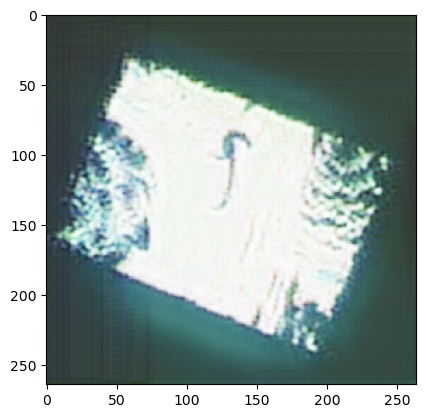

In [41]:
plt.imshow(image_aug.cpu().detach())

In [42]:
resnet_predict(image_aug.detach())

'screen: 8.4%'

In [79]:
image.shape

torch.Size([1024, 1024, 3])

In [ ]:
SN(orig_mesh.materials[0].diffuse_texture.T).T

tensor([[[0.9566, 0.9566, 0.9566],
         [0.9798, 0.9798, 0.9798],
         [0.9710, 0.9710, 0.9710],
         ...,
         [1.0347, 1.0347, 1.0347],
         [1.0203, 1.0203, 1.0203],
         [0.9939, 0.9939, 0.9939]],

        [[0.9560, 0.9560, 0.9560],
         [0.9807, 0.9807, 0.9807],
         [0.9649, 0.9649, 0.9649],
         ...,
         [1.0292, 1.0292, 1.0292],
         [1.0180, 1.0180, 1.0180],
         [0.9902, 0.9902, 0.9902]],

        [[0.9552, 0.9552, 0.9552],
         [0.9910, 0.9910, 0.9910],
         [0.9637, 0.9637, 0.9637],
         ...,
         [1.0136, 1.0136, 1.0136],
         [1.0036, 1.0036, 1.0036],
         [0.9838, 0.9838, 0.9838]],

        ...,

        [[0.9477, 0.9477, 0.9477],
         [0.9908, 0.9908, 0.9908],
         [0.9924, 0.9924, 0.9924],
         ...,
         [1.0398, 1.0398, 1.0398],
         [1.0041, 1.0041, 1.0041],
         [0.9836, 0.9836, 0.9836]],

        [[0.9428, 0.9428, 0.9428],
         [0.9758, 0.9758, 0.9758],
         [0.

In [ ]:
SN.noise_parameter.data.shape

torch.Size([1, 1, 1024, 1024])

In [ ]:

eye = polar_to_cartesian(1.25, 0.00001,  0.00001)
camera = make_camera(eye)
image = render(camera, mesh.cuda(), lighting)
# save image to png


In [ ]:
# plot image without grid
plt.axis('off')
plt.imshow(image.detach().cpu(),)
plt.show()


In [ ]:
import numpy as np
from PIL import Image

img = Image.fromarray(np.uint8(image.detach().cpu().numpy()*255), 'RGB')
img.save('adv_blswn_a4_2.jpg')


In [ ]:
(camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.5, 4])#,phi_range=[ 0.2,0.2] ,theta_range=[math.pi / 2 - theta_eps, math.pi / 2 - theta_eps])
lighting, (strength,light_directions) = random_light(strength_range=[20,30])#kal.render.easy_render.default_lighting().cuda()
print(strength,light_directions)
# lighting.amplitude = torch.ones(1,3).cuda() * 8

print(r)


# mesh.materials[0].diffuse_texture = mesh.materials[0].diffuse_texture

img = render(camera, mesh.cuda(), lighting.cuda())
plt.imshow(img.cpu().numpy())

In [ ]:

mesh.materials[0].diffuse_texture = SN(orig_mesh.materials[0].diffuse_texture.T).T

image = render(camera, mesh.cuda(), lighting)

image_aug = effect(image)
prediction_aug = resnet_predict_raw(image_aug)

prediction = resnet_predict_raw(image)

p = prediction.squeeze(0).softmax(0)
adv_loss = torch.stack([p[c.item()] for c in orig_clases]).max()
p_aug = prediction_aug.squeeze(0).softmax(0)
aug_pred_loss = torch.stack([p_aug[c.item()] for c in orig_clases]).max()
adv_loss =adv_loss + aug_pred_loss

In [ ]:
adv_loss.backward()

In [ ]:
texture_noise_optim.step()
texture_noise_optim.zero_grad()

In [ ]:
# zero any existing grads anywhere
torch.cuda.empty_cache()

In [ ]:
aug_pred_loss.backward(retain_graph=True)

In [ ]:
adv_loss.backward()

todo



1.   try to retrain to full the classfier with higher freq and see how it generlize
2.   try to remove the l2 or weight lambda term
3. try to use semantic distance instead L2 using VGG ETC.
4. lightning-AI lpipis loss
5.  implement batch size greater then 1
6. attack yolo
7. add discriminator loss instead of l2
8. zero shot
9. generate the noise template using nn that recieve the texture !
############################################ 10/10/24
10. add SDS (might be noisy, could require bigger batch size instead of the current 1)
11.


### playaround

In [ ]:
import torchvision

In [ ]:
torchvision.

In [ ]:
os.makedirs('/content/drive/MyDrive/Adver_diff_checkpoints/', exist_ok=True)
torch.save(SN, '/content/drive/MyDrive/Adver_diff_checkpoints/' + str(idx) + '_sds.pt')

In [ ]:
prediction = resnet_predict_raw(gt_image)
p = prediction.squeeze(0).softmax(0)
torch.stack([p[c.item()] for c in orig_clases])

In [ ]:
resnet_predict(torch.tensor(image.detach().cpu()).cuda())

In [ ]:
p = prediction.squeeze(0).softmax(0)
torch.stack([p[c.item()] for c in orig_clases])

In [ ]:
prediction[orig_clases[0].item()]

In [ ]:
orig_clases[0].cpu()

In [ ]:
SN.noise_parameter.grad.norm()  != SN.noise_parameter.grad.norm()

In [ ]:
total_loss

In [ ]:
idx

In [ ]:
image.max()

In [ ]:
SN.noise_parameter

In [ ]:
prediction.softmax(1).max()

In [ ]:
orig_clases

In [ ]:
prediction = resnet_predict_raw(image).softmax(0)
[critereon(prediction, c)  for c in orig_clases]

In [ ]:
prediction = resnet_predict_raw(image)
[critereon(prediction, c)  for c in orig_clases]

In [ ]:
a = torch.tensor([1,2,3]).float()

In [ ]:
a.requires_grad = True

In [ ]:
a.backward(gradient=torch.tensor([1,1,1]).float())

In [ ]:
(a*3).sum().backward()

In [ ]:
a.grad

In [ ]:
raise

In [ ]:
scheduler

In [ ]:
plt.imshow(image.detach().cpu())

In [ ]:
adv_loss

In [ ]:
plt.imshow(image.detach().cpu())

In [ ]:
resnet_predict(torch.tensor(image.detach().cpu()).cuda())

In [ ]:
resnet_predict(torch.tensor(gt_image.detach().cpu()).cuda())

In [ ]:
SN.noise_parameter[0].device

In [ ]:

import glob
import re
import os
import torch
weights_paths = glob.glob('/content/drive/MyDrive/Adver_diff_checkpoints/*no_sds.pt')
weights_paths.sort(key=lambda f: int(re.sub('\D', '', f)))

SN.noise_parameter = torch.load(weights_paths[-1]).noise_parameter
SN.to(device)

In [ ]:
weights_paths[-1]

### gif

In [ ]:
mesh = mesh.to(device)
orig_mesh = orig_mesh.to(device)

In [ ]:
# (camera, _), (r, phi, theta) = random_camera_and_light(r_range = [1.8, 2.5], phi_range=[3, math.pi * 2], theta_range=[ math.pi / 2 - theta_eps,1])

lighting = lighting, _ = random_light(strength_range=[15,15],suns_range=[7, 7])
# lighting.amplitude = torch.ones(1,3).cuda() * 10

mesh.materials[0].diffuse_texture = SN(orig_mesh.materials[0].diffuse_texture.T.to(device)).T

resolution = 20 # 100
plots = []
for theta in np.linspace(1, 0.9, 3):
  for phi in np.linspace(0.001, 3, resolution):
    camera, _ = polar_camera_and_light(1.7, phi, theta)
    # print(phi,theta)
    with torch.no_grad():
      img = render(camera.cuda(), mesh, lighting)
      orig_img = render(camera.cuda(), orig_mesh, lighting)
      img_score = resnet_predict(torch.tensor(img).cuda())
      orig_img_score = resnet_predict(torch.tensor(orig_img).cuda())
    # plot both images in the same figure
    # put the score as the images title
    fig, axs = plt.subplots(1, 2)
    axs[0].imshow(img.detach().cpu())
    axs[1].imshow(orig_img.detach().cpu())
    axs[0].set_title(img_score)
    axs[1].set_title(orig_img_score)
    plots.append([img,orig_img,img_score,orig_img_score])



In [ ]:
fig.show()

In [ ]:
import matplotlib.animation as animation

def save_plots(plots,name='image.gif'):
  #make animation out of plots list at the same figure
  fig, axs = plt.subplots(1, 2, figsize=(15, 5))

  def update(frame):
    axs[0].imshow(plots[frame][0].detach().cpu())
    axs[1].imshow(plots[frame][1].detach().cpu())
    axs[0].set_title('adv image score: ' + plots[frame][2])
    axs[1].set_title('orig image score: ' + plots[frame][3])
    return axs

  ani = animation.FuncAnimation(fig, update, frames=len(plots), interval=2500, repeat=True)

  # Display the animation
  # plt.show()
  #save the animation
  gif_file = name
  ani.save(gif_file, writer='pillow', fps=3)

  print(f"Animation saved as {gif_file}")

In [ ]:
save_plots(plots,name='resnet_adv.gif')

### test on DIFFERENT model

In [ ]:
# prompt: init other image classification model and apply it on image

from torchvision.models import vgg16, VGG16_Weights
import torchvision


different_weights = VGG16_Weights.DEFAULT
different_model = vgg16(weights=weights)
different_model = different_model.eval().cuda()
different_preprocess = weights.transforms().cuda()

def different_predict(image):
  with torch.no_grad():
    # Preprocess the image (resize, normalize, etc.) as required by the VGG model
    image = image.permute(2, 0, 1)
    if image.shape != (3, 256, 256):
      rimage = torchvision.transforms.Resize((256, 256))(image)
    else:
      rimage = image

    batch = different_preprocess(rimage).unsqueeze(0)
    # Assuming you have a normalization transform
    # normalization_transform = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    # batch = normalization_transform(rimage).unsqueeze(0)
    # batch = rimage.unsqueeze(0).cuda()


    # Get the prediction
    output = different_model(batch)

    # Process the output (e.g., get the class with the highest probability)
    _, predicted_class = torch.max(output, 1)

    category_name = different_weights.meta["categories"][predicted_class]
    score = output[0][predicted_class].item()

    return(f"{category_name}: {score:.1f}%")


In [ ]:
lighting = lighting, _ = random_light(strength_range=[15,15],suns_range=[6, 6])
# lighting.amplitude = torch.ones(1,3).cuda() * 10


resolution = 20 # 100
plots = []
for theta in np.linspace(1, 0.1, 3):
  for phi in np.linspace(0.001, 3, resolution):
    camera, _ = polar_camera_and_light(1.8, phi, theta)
    # print(phi,theta)
    with torch.no_grad():
      img = render(camera.cuda(), mesh, lighting)
      orig_img = render(camera.cuda(), orig_mesh, lighting)
      img_score = different_predict(torch.tensor(img).cuda())
      orig_img_score = different_predict(torch.tensor(orig_img).cuda())
    # plot both images in the same figure
    # put the score as the images title
    # fig, axs = plt.subplots(1, 2)
    # axs[0].imshow(img.detach().cpu())
    # axs[1].imshow(orig_img.detach().cpu())
    # axs[0].set_title(img_score)
    # axs[1].set_title(orig_img_score)
    plots.append([img,orig_img,img_score,orig_img_score])



In [ ]:
save_plots(plots,name='vgg_model_adv.gif')

### check on clock projet

In [ ]:
#@title load pre-rendered clock stuff

# with open('/content/drive/MyDrive/texture_and_stuff.pkl', 'rb') as f:
#     pkl_params = pickle.load(f)
# texture, vertice_shift, nb_faces = pkl_params['texture'], pkl_params['vertice_shift'], pkl_params['nb_faces']

mesh = kal.io.usd.import_mesh('/content/drive/MyDrive/mesh.usd')

import pickle
with open('/content/drive/MyDrive/texture_and_stuff.pkl', 'rb') as f:
    texture = pickle.load(f)['texture']

pbr_mat = kal.render.materials.PBRMaterial(diffuse_texture=texture[0].detach())#torch.clamp(texture[0].detach(), 0., 1.))